In [1]:
%run base.ipynb

/opt/anaconda/lib/python3.8/site-packages/dcor/_fast_dcov_avl.py:67: NumbaWarning: Cannot cache compiled function "_partial_sum_2d" as it uses outer variables in a closure
  def _partial_sum_2d(x, y, c, ix, iy, sx_c, sy_c, c_sum, l_max,
/opt/anaconda/lib/python3.8/site-packages/dcor/_fast_dcov_avl.py:94: NumbaWarning: Cannot cache compiled function "_distance_covariance_sqr_avl_impl" as it uses outer variables in a closure
  def _distance_covariance_sqr_avl_impl(
/opt/anaconda/lib/python3.8/site-packages/dcor/_fast_dcov_mergesort.py:99: NumbaWarning: Cannot cache compiled function "_compute_aijbij_term" as it uses outer variables in a closure
  def _compute_aijbij_term(x, y):
/opt/anaconda/lib/python3.8/site-packages/dcor/_fast_dcov_mergesort.py:163: NumbaWarning: Cannot cache compiled function "_distance_covariance_sqr_mergesort_generic_impl" as it uses outer variables in a closure
  def _distance_covariance_sqr_mergesort_generic_impl(x, y, unbiased):


logging to /core/logs/ct.log


The sklearn.metrics.scorer module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
The sklearn.feature_selection.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.feature_selection. Anything that cannot be imported from sklearn.feature_selection is now part of the private API.


err init tf METRICS


### Read all option chains and create one dataframe

rows is kept only if both bid and ask present

In [ ]:
#pd.read_csv('optmamachain/'+'2020.03.11.optchain.1hr.csv')

In [ ]:
# filenames=os.listdir('optchain')
# dfs=[]

# for filename in filenames[:]:
#     print(filename)
#     df=pd.read_csv('optchain/'+filename)[['tm','ty','strike','symbol','underly','underlypx','expire','aiv','biv','delta','vega']].dropna()
#     dfs.append(df[df.symbol.str.contains('BTC')])

# df=pd.concat(dfs)
# df=df.dropna() #underplyign price must be present
# df['tm']=pd.to_datetime(df['tm'],format=kdbformat)
# df['expire']=pd.to_datetime(df['expire'],format=kdbformat)
# df=df.drop(columns=['symbol','underly'])
# df=df.set_index(['tm','expire','strike']).sort_index()
# df.to_pickle('btcoptions.pkl')

### read btcoptions and calibrate  

calibrate only to OTM    as ITM less liquid , much higher bid ask ( +10 vol points sometimes)

midatmvol+leftskew*strike+leftconv*strike^2   same for right  strike is log(K/F)/sqrt(tau)

In [116]:
qoptchain(folder='deribitopt',date1=date(2021,9,6),date2=date(2021,9,6),maturity=date(2021,9,24),freq='5Min')

query=system "l /core/data/db/deribitopt";
select distinct date from optchain
query=system "l /core/data/rdb/deribitopt";
select distinct date from optchain
query=
    system "l /core/github/cryptoderiv-quant/ct/optchain.q";
    runmehdf[`deribitopt;2021.09.06;0D01]
query=
    system "l /core/github/cryptoderiv-quant/ct/optchain.q";
    runmehdf[`deribitopt;2021.09.06;0D01]


,symbol,tm,aiv,ap,av,biv,bp,bv,delta,exch,exchtm,expire,gamma,lpx,mark,markiv,oint,rho,strike,theta,ty,underly,s,vega,tau
tm,,,,,,,,,,,,,,,,,,,,,,,,,
2021-09-06 02:00:00,BTC-24SEP21-32000-C,2021-09-06 01:00:00,1.3537,0.392,10.5,0.8619,0.387,5,0.97304,deribit,2021-09-06 01:59:57.709,2021-09-24 08:00:00,0,0.3735,0.38982051,1.2209,480.5,15.21586,32000,-24.2933,1,BTC-24SEP21,52179.43,7.26278,0.05000007265
2021-09-06 14:00:00,BTC-24SEP21-32000-C,2021-09-06 13:00:00,1.3528,0.3885,5.9,0.8089,0.3835,11.7,0.97374,deribit,2021-09-06 13:59:59.422,2021-09-24 08:00:00,0,0.3735,0.386303,1.2146,480.5,14.82466,32000,-23.84455,1,BTC-24SEP21,51893.88,6.96899,0.04863015531
2021-09-06 16:00:00,BTC-24SEP21-32000-C,2021-09-06 15:00:00,1.384,0.3905,9.1,0.7389,0.385,5.7,0.97364,deribit,2021-09-06 15:59:56.303,2021-09-24 08:00:00,0,0.3735,0.38791175,1.2258,480.5,14.74965,32000,-24.26266,1,BTC-24SEP21,52028.26,6.99369,0.04840194372
2021-09-06 19:00:00,BTC-24SEP21-32000-C,2021-09-06 18:00:00,1.3982,0.3935,7,0.5168,0.388,7,0.97467,deribit,2021-09-06 18:59:57.701,2021-09-24 08:00:00,0,0.3735,0.39085618,1.231,480.5,14.67094,32000,-23.76519,1,BTC-24SEP21,52287.57,6.77284,0.04805943363
2021-09-07 00:00:00,BTC-24SEP21-32000-C,2021-09-06 23:00:00,1.3631,0.4015,4.4,1.0968,0.3985,9,0.97605,deribit,2021-09-06 23:59:56.194,2021-09-24 08:00:00,0,0.4,0.40009811,1.2626,480.5,14.52348,32000,-23.76258,1,BTC-24SEP21,53100.38,6.5243,0.04748870516
2021-09-06 10:00:00,BTC-24SEP21-72000-P,2021-09-06 09:00:00,1.1511,0.3925,17.1,0.7979,0.3805,9.5,-0.92651,deribit,2021-09-06 09:59:57.397,2021-09-24 08:00:00,1e-05,0.397,0.38387425,0.9309,60.8,-33.61739,72000,-41.92547,-1,BTC-24SEP21,52263.41,16.1389,0.04908684053
2021-09-06 11:00:00,BTC-24SEP21-72000-P,2021-09-06 10:00:00,1.1769,0.3945,1.5,0.7142,0.38,10.3,-0.92629,deribit,2021-09-06 10:59:55.857,2021-09-24 08:00:00,1e-05,0.397,0.38483787,0.9346,60.8,-33.53586,72000,-42.20958,-1,BTC-24SEP21,52228.6,16.14518,0.04897273411
2021-09-06 13:00:00,BTC-24SEP21-72000-P,2021-09-06 12:00:00,1.1981,0.406,3,0.6025,0.3905,8.8,-0.93559,deribit,2021-09-06 12:59:56.826,2021-09-24 08:00:00,1e-05,0.397,0.3954336,0.9208,60.8,-33.60336,72000,-37.2518,-1,BTC-24SEP21,51792.51,14.39587,0.04874439288
2021-09-06 14:00:00,BTC-24SEP21-72000-P,2021-09-06 13:00:00,1.1785,0.4025,1.5,0.6975,0.3885,5.9,-0.93526,deribit,2021-09-06 13:59:56.401,2021-09-24 08:00:00,1e-05,0.397,0.39257161,0.9181,60.8,-33.51353,72000,-37.41104,-1,BTC-24SEP21,51894.87,14.46591,0.04863025111


query=system "l /core/data/db/binance";
0!select  o:first px,h:max px,l:min px,c:last px ,v:sum vol by date, symbol, 0D00:30 xbar exchtm from ppttrades where  date within 2021.07.01 2021.09.20,  symbol=`BTCUSDT 
query=system "l /core/data/rdb/binance";
0!select  o:first px,h:max px,l:min px,c:last px ,v:sum vol by date, symbol, 0D00:30 xbar exchtm from ppttrades where  date within 2021.07.01 2021.09.20,  symbol=`BTCUSDT 


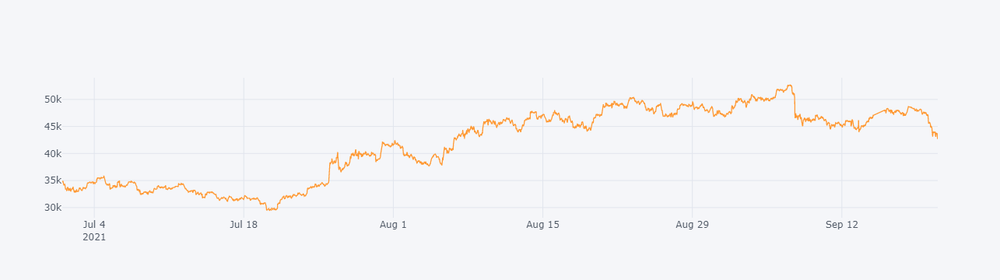

In [39]:
qbars('BTCUSDT@binance',freq='30Min',date=[date(2021,7,1),date(2021,9,20)])[['c']].iplot()

In [ ]:
df=qoptchain(folder='deribitopt',date1=date(2021,8,1),date2=date(2021,8,1),maturity=date(2021,9,24),freq='1H')

query=system "l /core/data/db/deribitopt";
select distinct date from optchain
query=system "l /core/data/rdb/deribitopt";
select distinct date from optchain
query=
    system "l /core/github/cryptoderiv-quant/ct/optchain.q";
    runmehdf[`deribitopt;2021.08.01;0D01]


In [9]:
df

,symbol,tm,aiv,ap,av,biv,bp,bv,delta,exch,exchtm,expire,gamma,lpx,mark,markiv,oint,rho,strike,theta,ty,underly,s,vega,tau
tm,,,,,,,,,,,,,,,,,,,,,,,,,
2021-09-07 00:05:00,ETH-24SEP21-9000-C,2021-09-07 00:00:00,1.6449,0.002,550,1.4017,0.0005,568,0.01047,deribit,2021-09-07 00:04:56.457,2021-09-24 08:00:00,2e-05,0.001,0.001071,1.5232,3095,0.01766,9000,-1.05123,1,ETH-24SEP21,3957.97,0.2392,0.04747918389
2021-09-07 00:10:00,ETH-24SEP21-9000-C,2021-09-07 00:05:00,1.6441,0.002,550,1.4009,0.0005,568,0.01049,deribit,2021-09-07 00:09:58.841,2021-09-24 08:00:00,2e-05,0.001,0.001073,1.5228,3095,0.01771,9000,-1.05399,1,ETH-24SEP21,3960.49,0.23985,0.04746959535
2021-09-07 00:15:00,ETH-24SEP21-9000-C,2021-09-07 00:10:00,1.6475,0.002,550,1.4039,0.0005,568,0.01036,deribit,2021-09-07 00:14:58.097,2021-09-24 08:00:00,2e-05,0.001,0.001059,1.5236,3095,0.01745,9000,-1.04085,1,ETH-24SEP21,3952.69,0.23669,0.04746010601
2021-09-07 00:20:00,ETH-24SEP21-9000-C,2021-09-07 00:15:00,1.6519,0.002,550,1.4078,0.0005,568,0.01022,deribit,2021-09-07 00:19:59.947,2021-09-24 08:00:00,2e-05,0.001,0.001044,1.5253,3095,0.01716,9000,-1.02713,1,ETH-24SEP21,3942.46,0.23326,0.04745053441
2021-09-07 00:25:00,ETH-24SEP21-9000-C,2021-09-07 00:20:00,1.655,0.002,550,1.4106,0.0005,568,0.01019,deribit,2021-09-07 00:24:59.231,2021-09-24 08:00:00,2e-05,0.001,0.001041,1.5278,3095,0.01707,9000,-1.0242,1,ETH-24SEP21,3935.49,0.23217,0.04744104417
2021-09-07 00:30:00,ETH-24SEP21-9000-C,2021-09-07 00:25:00,1.657,0.002,550,1.4124,0.0005,568,0.01021,deribit,2021-09-07 00:29:58.622,2021-09-24 08:00:00,2e-05,0.001,0.001046,1.5305,3095,0.01709,9000,-1.02731,1,ETH-24SEP21,3931.02,0.23242,0.04743155055
2021-09-07 00:35:00,ETH-24SEP21-9000-C,2021-09-07 00:30:00,1.6589,0.002,550,1.4141,0.0005,568,0.01021,deribit,2021-09-07 00:34:59.946,2021-09-24 08:00:00,2e-05,0.001,0.001048,1.5325,3095,0.01707,9000,-1.02775,1,ETH-24SEP21,3926.89,0.23217,0.04742199562
2021-09-07 00:40:00,ETH-24SEP21-9000-C,2021-09-07 00:35:00,1.6571,0.002,550,1.4125,0.0005,568,0.01036,deribit,2021-09-07 00:39:59.250,2021-09-24 08:00:00,2e-05,0.001,0.001065,1.5337,3095,0.01733,9000,-1.04272,1,ETH-24SEP21,3931.46,0.23531,0.04741250476
2021-09-07 00:45:00,ETH-24SEP21-9000-C,2021-09-07 00:40:00,1.6628,0.002,550,1.4176,0.0005,568,0.01016,deribit,2021-09-07 00:44:58.573,2021-09-24 08:00:00,2e-05,0.001,0.001043,1.5355,3095,0.01693,9000,-1.02303,1,ETH-24SEP21,3918.18,0.23055,0.04740301329


In [16]:
df=pd.read_pickle('/tmp/optchain5Min.pkl')

In [13]:
df.to_pickle('/tmp/optchain5Min.pkl')

In [27]:
#ts=df.index.get_level_values('tm').drop_duplicates()

In [115]:
#df=df.rename(columns={'underlypx':'s'})


#df['tm']=pd.to_datetime(df['exchtm'],format=kdbformat)
#df['expire']=pd.to_datetime(df['expire'],format=kdbformat)
#df['tau']=(df['expire']-df['tm'])/pd.Timedelta('1d')
df=df[df.symbol.str.contains('BTC')]
df=df.set_index(['tm','expire','strike']).sort_index()


In [42]:
from scipy.optimize import minimize
from scipy.interpolate import interp1d
from functools import partial

In [28]:
DF(df.reset_index()['exchtm'].unique()).gr()

QgridWidget(grid_options={'fullWidthRows': True, 'syncColumnCellResize': True, 'forceFitColumns': True, 'defau…

In [5]:
df.query("tm >'2021-07-01 15:00' and tm <'2021-07-01 16:10'")

NameError: name 'df' is not defined

In [33]:
2

2

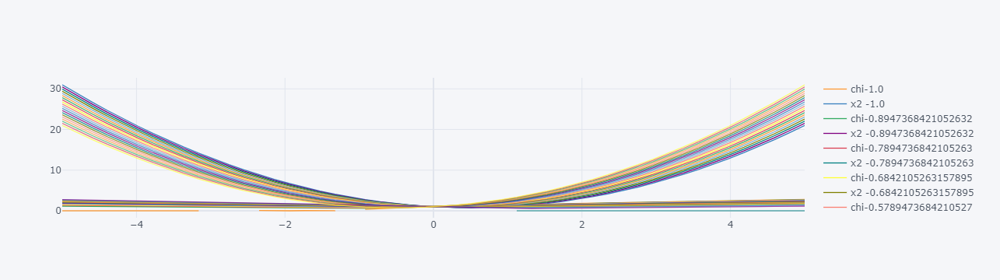

In [48]:
x=np.linspace(-5,5)
r=0.9
dfh=DF({'x':x}).set_index('x')

for r in np.linspace(-1,1,20):
    dfh[f'chi{r}']=x/np.log((np.sqrt(1-2*r*x+x**2)+x-r)/(1-r))
    dfh[f'x2 {r}']=1+x**2+r*x
    
dfh.iplot()

In [63]:
#how to do sigma ATM override?  volATM must be param  non optimizable?

def errfunc_tanh4(x,usevega=False,df=None,PRICECALL=False,plot=False,info="",**kwargs):
    figsflask=not isnotebook()
    res={}
    figs=[]
    skew=x[0]
    conv=x[1]
    wingleft=x[2]
    wingright=x[3]
    df['m']=0.5*(df['aiv']+df['biv'])
    S=df['s'].iloc[0]
    try:
        volATM=interp1d(df.index, df['m'])([S])[0]
    except Exception as e:
        print(str(e))
        print('dfindex',df.index)
        print('dfm',df['m'])
        resprice={'rr':np.nan,'conv':np.nan,'volATM':np.nan,'err':str(e)}
        if PRICECALL:
            if plot>2:
                img=plotstart()
                plt.figure(figsize=(4,4))
                plt.text(0.1,0.9,f'{str(e)} {info}')
                resprice['figs']=[plotend(img)]
            return resprice
        return 0
    #display(df)
    
    df['y']=0
    
    
    kleft=kwargs['kleft']
    kright=kwargs['kright']
    
    df['xleft']=np.log(kleft/df['s'])+wingleft*df['logKFtau']
    df['xright']=np.log(kright/df['s'])+wingright*df['logKFtau']
    #ipdb.set_trace()
    df.loc[df.logKFtau<0,'y']=df['xleft']*np.tanh(df['logKFtau']/df['xleft'])
    df.loc[df.logKFtau>0,'y']=df['xright']*np.tanh(df['logKFtau']/df['xright'])
    
    #df.loc[df.logKFtau>0,'myvol']=volATM+skew*df['logKFtau']+conv*df['logKFtau']**2
    #df.loc[df.logKFtau<0,'myvol']=volATM+skew*df['logKFtau']+conv*df['logKFtau']**2
    
    df.loc[df.logKFtau>0,'myvol']=volATM+skew*df['y']+conv*df['y']**2
    df.loc[df.logKFtau<0,'myvol']=volATM+skew*df['y']+conv*df['y']**2
    #display(df)
    
    df['insidebidask']=False
    df.loc[(df.myvol>df.biv)&(df.myvol<df.aiv),'insidebidask']=True
    if PRICECALL and plot>2:
                
        
        df[['aiv','biv','myvol','markiv']].plot(title=f"{info} s={S} {df['insidebidask'].sum()/len(df):.1%} vols in bidask " ,style='.-')
        plt.show()
        
        df[['aiv','biv','myvol','markiv','logKFtau']].set_index('logKFtau').plot(title=f"{info} s={S} {df['insidebidask'].sum()/len(df):.1%} vols in bidask " ,style='.-')
        plt.show()
    res=(df['myvol']-df['m'])**2 
    if usevega:
        res*=df['vega']
        ws=np.ones(len(df))
        df['w']=np.ones(len(df))
        df.loc[df['logKFtau']>2,'w']=0
        df.loc[df['logKFtau']<-2,'w']=0
        res*=df['w']
    if PRICECALL:
        resprice={'volATM':volATM}
        try:
            volp5=interp1d(df.index,df['myvol'])([S*(1.05)])[0]
            volm5=interp1d(df.index,df['myvol'])([S*(0.95)])[0]
            skew=volp5-volm5 #risk reversal 5%
            conv=0.5*(volp5+volm5)-volATM #butterfly 
            resprice['rr']=skew
            resprice['conv']=conv
        except Exception as e:
            resprice['rr']=np.nan
            resprice['conv']=np.nan
            print(f"!volfit {str(e)}")

        if plot:
            resprice['figs']=figs
        return resprice
    return res.sum() 


def errfunc_parabolic4(x,usevega=False,df=None,PRICECALL=False,plot=False,info="",**kwargs):
    figsflask=not isnotebook()
    res={}
    figs=[]
    skewleft=x[0]
    skewright=x[1]
    leftconv=x[2]
    rightconv=x[3]
    df['m']=0.5*(df['aiv']+df['biv'])
    S=df['s'].iloc[0]
    try:
        volATM=interp1d(df.index, df['m'])([S])[0]
    except Exception as e:
        print(str(e))
        print('dfindex',df.index)
        print('dfm',df['m'])
        resprice={'rr':np.nan,'conv':np.nan,'volATM':np.nan,'err':str(e)}
        if PRICECALL:
            if plot>2:
                img=plotstart()
                plt.figure(figsize=(4,4))
                plt.text(0.1,0.9,f'{str(e)} {info}')
                resprice['figs']=[plotend(img)]
            return resprice
        return 0
    #display(df)
    df.loc[df.logKFtau>0,'myvol']=volATM+(skewright*df['logKFtau']+rightconv*df['logKFtau']**2)
    df.loc[df.logKFtau<0,'myvol']=volATM+(skewleft*df['logKFtau']+leftconv*df['logKFtau']**2)
    df['insidebidask']=False
    df.loc[(df.myvol>df.biv)&(df.myvol<df.aiv),'insidebidask']=True
    if PRICECALL and plot>2:
                
        
#         df[['aiv','biv','myvol','markiv']].plot(title=f"{info} s={S} {df['insidebidask'].sum()/len(df):.1%} vols in bidask " ,style='.-')
#         plt.show()
#         plt.figure(figsize=(5,5))
        print(f"plot={plot}")
        df[['aiv','biv','myvol','markiv','logKFtau']].set_index('logKFtau').plot(title=f"{info} s={S} {df['insidebidask'].sum()/len(df):.1%} vols in bidask " ,style='.-')
        plt.show()
    res=(df['myvol']-df['m'])**2 
    if usevega:
        res*=df['vega']
        ws=np.ones(len(df))
        df['w']=np.ones(len(df))
        df.loc[df['logKFtau']>2,'w']=0
        df.loc[df['logKFtau']<-2,'w']=0
        res*=df['w']
    if PRICECALL:
        resprice={'volATM':volATM}
        resprice['perc']=df['insidebidask'].sum()/len(df)
        try:
            volp5=interp1d(df.index,df['myvol'])([S*(1.05)])[0]
            volm5=interp1d(df.index,df['myvol'])([S*(0.95)])[0]
            skew=volp5-volm5 #risk reversal 5%
            conv=0.5*(volp5+volm5)-volATM #butterfly 
            resprice['rr']=skew
            resprice['conv']=conv
        except Exception as e:
            resprice['rr']=np.nan
            resprice['conv']=np.nan
            print(f"!volfit {str(e)}")

        if plot:
            resprice['figs']=figs
        return resprice
    return res.sum() 


def errfunc_parabolic_conv3(x,usevega=False,df=None,PRICECALL=False,plot=False,info="",**kwargs):
    figsflask=not isnotebook()
    res={}
    figs=[]
    skewleft=x[0]
    skewright=x[1]
    leftconv=x[2]
    rightconv=x[3]
    df['m']=0.5*(df['aiv']+df['biv'])
    S=df['s'].iloc[0]
    try:
        volATM=interp1d(df.index, df['m'])([S])[0]
    except Exception as e:
        print(str(e))
        print('dfindex',df.index)
        print('dfm',df['m'])
        resprice={'rr':np.nan,'conv':np.nan,'volATM':np.nan,'err':str(e)}
        if PRICECALL:
            if plot>2:
                img=plotstart()
                plt.figure(figsize=(4,4))
                plt.text(0.1,0.9,f'{str(e)} {info}')
                resprice['figs']=[plotend(img)]
            return resprice
        return 0
    #display(df)
    df.loc[df.logKFtau>0,'myvol']=volATM+(skewright*df['logKFtau']+rightconv*df['logKFtau']**2)
    df.loc[df.logKFtau<0,'myvol']=volATM+(skewleft*df['logKFtau']+leftconv*df['logKFtau']**2)
    df['insidebidask']=False
    df.loc[(df.myvol>df.biv)&(df.myvol<df.aiv),'insidebidask']=True
    if PRICECALL and plot>2:
                
        
#         df[['aiv','biv','myvol','markiv']].plot(title=f"{info} s={S} {df['insidebidask'].sum()/len(df):.1%} vols in bidask " ,style='.-')
#         plt.show()
#         plt.figure(figsize=(5,5))
        print(f"plot={plot}")
        df[['aiv','biv','myvol','markiv','logKFtau']].set_index('logKFtau').plot(title=f"{info} s={S} {df['insidebidask'].sum()/len(df):.1%} vols in bidask " ,style='.-')
        plt.show()
    res=(df['myvol']-df['m'])**2 
    if usevega:
        res*=df['vega']
        ws=np.ones(len(df))
        df['w']=np.ones(len(df))
        df.loc[df['logKFtau']>2,'w']=0
        df.loc[df['logKFtau']<-2,'w']=0
        res*=df['w']
    if PRICECALL:
        resprice={'volATM':volATM}
        resprice['perc']=df['insidebidask'].sum()/len(df)
        try:
            volp5=interp1d(df.index,df['myvol'])([S*(1.05)])[0]
            volm5=interp1d(df.index,df['myvol'])([S*(0.95)])[0]
            skew=volp5-volm5 #risk reversal 5%
            conv=0.5*(volp5+volm5)-volATM #butterfly 
            resprice['rr']=skew
            resprice['conv']=conv
        except Exception as e:
            resprice['rr']=np.nan
            resprice['conv']=np.nan
            print(f"!volfit {str(e)}")

        if plot:
            resprice['figs']=figs
        return resprice
    return res.sum() 






def errfunc_parabolic_linear6(x,usevega=False,useweights=False,df=None,PRICECALL=False,plot=False,info="",**kwargs): #left skew and right skew
    figsflask=not isnotebook()
    res={}
    figs=[]
    skewleft=x[0]
    skewright=x[1]
    leftconv=x[2]
    rightconv=x[3]
    rightwing=x[4]
    leftwing=x[5]
    
    #same skew ATM
    #skewleft=skewright
    
    #same conv ATM
    #leftconv=rightconv
    
    df['m']=0.5*(df['aiv']+df['biv'])
    S=df['s'].iloc[0]
    try:
        volATM=interp1d(df.index, df['m'])([S])[0]
    except Exception as e:
        print(str(e))
        print('dfindex',df.index)
        print('dfm',df['m'])
        resprice={'rr':np.nan,'conv':np.nan,'volATM':np.nan,'err':str(e)}
        if PRICECALL:
            if plot>2:
                img=plotstart()
                plt.figure(figsize=(4,4))
                plt.text(0.1,0.9,f'{str(e)} {info}')
                resprice['figs']=[plotend(img)]
            return resprice
        return 0
    #display(df)
    kright=kwargs['kright']
    kleft=kwargs['kleft']
    df.loc[(df.logKFtau>0)&(df.logKFtau<kright),'myvol']=volATM+(skewright*df['logKFtau']+rightconv*df['logKFtau']**2) 
    df.loc[(df.logKFtau<0)&(df.logKFtau>kleft),'myvol']=volATM+(skewleft*df['logKFtau']+leftconv*df['logKFtau']**2)
    yright=volATM+(skewright*kright+rightconv*kright**2)
    yleft=volATM+(skewleft*kleft+leftconv*kleft**2)
    df.loc[(df.logKFtau>kright),'myvol']=rightwing*(df['logKFtau']-kright)+yright
    df.loc[(df.logKFtau<kleft),'myvol']=leftwing*(df['logKFtau']-kleft)+yleft
    df['insidebidask']=False
    df.loc[(df.myvol>df.biv)&(df.myvol<df.aiv),'insidebidask']=True
    if PRICECALL and plot>2:        
# #         df[['aiv','biv','myvol','markiv']].plot(title=f"{info} s={S} {df['insidebidask'].sum()/len(df):.1%} vols in bidask " ,style='.-')
# #         plt.show()
#         plt.figure(figsize=(5,5))
        df[['aiv','biv','myvol','markiv','logKFtau']].query("abs(logKFtau)<1").set_index('logKFtau').plot(title=f"{info} s={S} {df['insidebidask'].sum()/len(df):.1%} vols in bidask " ,style='.-')
        plt.show()
    res=(df['myvol']-df['m'])**2 
    if usevega:
        res*=df['vega']
        
        if useweights:
            ws=np.ones(len(df))
            df['w']=np.ones(len(df))
            df.loc[df['logKFtau']>2,'w']=0
            df.loc[df['logKFtau']<-2,'w']=0
            res*=df['w']
    if PRICECALL:
        resprice={'volATM':volATM}
        resprice['perc']=df['insidebidask'].sum()/len(df)
        try:
            volp5=interp1d(df.index,df['myvol'])([S*(1.05)])[0]
            volm5=interp1d(df.index,df['myvol'])([S*(0.95)])[0]
            skew=volp5-volm5 #risk reversal 5%
            conv=0.5*(volp5+volm5)-volATM #butterfly 
            resprice['rr']=skew
            resprice['conv']=conv
        except Exception as e:
            resprice['rr']=np.nan
            resprice['conv']=np.nan
            print(f"!volfit {str(e)}")

        if plot:
            resprice['figs']=figs
        return resprice
    return res.sum() 


def errfunc_parabolic_linear4(x,usevega=False,useweights=False,df=None,PRICECALL=False,plot=0,info="",**kwargs): #left skew and right skew
    #print(f"plot={plot}")
    figsflask=not isnotebook()
    res={}
    figs=[]
    skew=x[0]
    conv=x[1]
    rightwing=x[2]
    leftwing=x[3]
    df['m']=0.5*(df['aiv']+df['biv'])
    S=df['s'].iloc[0]
    try:
        volATM=interp1d(df.index, df['m'])([S])[0]
    except Exception as e:
        print(str(e))
        print('dfindex',df.index)
        print('dfm',df['m'])
        resprice={'rr':np.nan,'conv':np.nan,'volATM':np.nan,'err':str(e)}
        if PRICECALL:
            if plot>2:
                img=plotstart()
                plt.figure(figsize=(4,4))
                plt.text(0.1,0.9,f'{str(e)} {info}')
                resprice['figs']=[plotend(img)]
            return resprice
        return 0
    #display(df)
    kright=kwargs['kright']
    kleft=kwargs['kleft']
    
    df.loc[(df.logKFtau>0)&(df.logKFtau<kright),'myvol']=volATM+(skew*df['logKFtau']+conv*df['logKFtau']**2) 
#     xright=df.loc[(df.logKFtau>0)&(df.logKFtau<kright)].iloc[-1]['logKFtau']
#     yright=df.loc[(df.logKFtau>0)&(df.logKFtau<kright),'myvol'].iloc[-1]
    #print(f'xright={xright} yright={yright}')
    df.loc[(df.logKFtau<0)&(df.logKFtau>kleft),'myvol']=volATM+(skew*df['logKFtau']+conv*df['logKFtau']**2)
#     xleft=df.loc[(df.logKFtau<0)&(df.logKFtau>kleft)].iloc[-1]['logKFtau']
#     yleft=df.loc[(df.logKFtau<0)&(df.logKFtau>kleft),'myvol'].iloc[-1]
    #wings
#     df.loc[(df.logKFtau>kright),'myvol']=rightwing*(df['logKFtau']-xright)+yright
#     df.loc[(df.logKFtau<kleft),'myvol']=leftwing*(df['logKFtau']-xleft)+yleft
    yright=volATM+(skew*kright+conv*kright**2)
    yleft=volATM+(skew*kleft+conv*kleft**2)
    df.loc[(df.logKFtau>kright),'myvol']=rightwing*(df['logKFtau']-kright)+yright
    df.loc[(df.logKFtau<kleft),'myvol']=leftwing*(df['logKFtau']-kleft)+yleft
      
    df['insidebidask']=False
    df.loc[(df.myvol>df.biv)&(df.myvol<df.aiv),'insidebidask']=True
    if PRICECALL and plot>2:
                
        
#         df[['aiv','biv','myvol','markiv']].plot(title=f"{info} s={S} {df['insidebidask'].sum()/len(df):.1%} vols in bidask " ,style='.-')
#         plt.show()
#         plt.figure(figsize=(5,5))
        df[['aiv','biv','myvol','markiv','logKFtau']].set_index('logKFtau').plot(title=f"{info} s={S} {df['insidebidask'].sum()/len(df):.1%} vols in bidask " ,style='.-')
        plt.show()
    res=(df['myvol']-df['m'])**2 
    if usevega:
        res*=df['vega']
        if useweights:
            ws=np.ones(len(df))
            df['w']=np.ones(len(df))
            df.loc[df['logKFtau']>2,'w']=0
            df.loc[df['logKFtau']<-2,'w']=0
            res*=df['w']
    if PRICECALL:
        resprice={'volATM':volATM}
        resprice['perc']=df['insidebidask'].sum()/len(df)
        try:
            volp5=interp1d(df.index,df['myvol'])([S*(1.05)])[0]
            volm5=interp1d(df.index,df['myvol'])([S*(0.95)])[0]
            skew=volp5-volm5 #risk reversal 5%
            conv=0.5*(volp5+volm5)-volATM #butterfly 
            resprice['rr']=skew
            resprice['conv']=conv
        except Exception as e:
            resprice['rr']=np.nan
            resprice['conv']=np.nan
            print(f"!volfit {str(e)}")

        if plot:
            resprice['figs']=figs
        return resprice
    return res.sum() 


def volfit(df,plot=False,model='errfunc_parabolic_linear2',**kwargs):
    
    figsflask=not isnotebook()
    #res={}
    figs=[]
    ts=df.index.get_level_values('tm').drop_duplicates()
    #ts=ts[:Nts] if Nts else ts
#    ipdb.set_trace()
    res=[]
    for t in ts:
        dft=df.loc[[t]].droplevel('tm')
        Ts=dft.index.get_level_values('expire').drop_duplicates()
     #   Ts=Ts[:NTs] if NTs else Ts
        for T in Ts:
            dftT=dft.loc[[T]].droplevel('expire').drop_duplicates()
            
            tau=(T-t)/pd.to_timedelta(1, unit='D')/365
            dftT['logKFtau']=np.log(dftT.index/dftT['s'])/np.sqrt(tau)
            S=dftT['s'].iloc[0]
            dftTOTM=dftT[((dftT.ty==1)&(S<dftT.index))|((dftT.ty==-1)&(S>dftT.index))]
            if len(dftTOTM)==0:
                continue
            #after this can be empy cuz all ITM
            print(f"T={T} t={t}")
            #display(dft.loc[[T]])
            #display(dftTOTM)
            #dftTOTM[['aiv','biv']].plot(title=f' t={t} T={T} S={S}',style='o')
            usevega=True
            #lookup initvals from res df , if exist
            prevparams=[0.2,0.2,0.2,-0.2] if model[-1]=='4' else [0.2]*int(model[-1])
            print(f"prevparams={prevparams} model={model}")
            
            minres = minimize(partial(eval(model),usevega=usevega,df=dftTOTM,PRICECALL=False,stats=False,plot=False,kleft=kwargs['kleft'],kright=kwargs['kright']), prevparams, method='L-BFGS-B', options={'eps': 1e-09, 'maxfun': 100, 'maxiter': 100})
            #minres = minimize(partial(errfunc_parabolic_linear1,usevega=usevega,df=dftTOTM,PRICECALL=False,plot=False,kleft=-2,kright=2), [0.2,0.2,0.01,0.01,0.2,-0.2], method='L-BFGS-B', options={'eps': 1e-08, 'maxfun': 100, 'maxiter': 100})
            #TODO: put previous params as initial guess fot t+1, same T
            print(f"optimized params:{minres.x}")
            plotres=partial(eval(model),usevega=usevega,df=dftTOTM,PRICECALL=True,plot=plot,info=f't={t} T={T}',kleft=kwargs['kleft'],kright=kwargs['kright'])(minres.x)
            if plot:
                figs.extend(plotres['figs'])
            resd={'t':t,'T':T,'volATM':plotres['volATM'],'s':S,'rr':plotres['rr'],'conv':plotres['conv'],'perc':plotres['perc']}
            for i in range(len(minres.x)):
                resd['p'+str(i)]=minres.x[i]
            res.append(resd)
    return res

In [ ]:
volfit(df,plot=3,model="errfunc_parabolic_linear4",kleft=-1.5,kright=2.3)

In [116]:
vfres=volfit(df.query("tm >'2021-08-06 14:00:00' and tm< '2021-08-28 14:10:00' "),plot=0,model='errfunc_parabolic_linear6',kleft=-2,kright=1.5)

T=2021-09-24 08:00:00 t=2021-08-06 14:05:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.00736449  0.06439308  0.0955876   0.03484606  0.18065976 -0.16861723]
T=2021-09-24 08:00:00 t=2021-08-06 14:10:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[-0.0018521   0.0667973   0.09047245  0.03291571  0.18201441 -0.16940667]
T=2021-09-24 08:00:00 t=2021-08-06 14:15:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.00070983  0.06086218  0.09152956  0.03644441  0.18106802 -0.16742765]
T=2021-09-24 08:00:00 t=2021-08-06 14:20:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[-0.00330091  0.06146843  0.08926504  0.03733427  0.18059852 -0.16689812]
T=2021-09-24 08:00:00 t=2021-08-06 14:25:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.00028125  0.06242101  0.0

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [111]:
dfv.corr()['dv'].loc['r*p0prev']

0.28543982626159375

,t,T,volATM,s,rr,conv,perc,p0,p1,p2,p3,p4,p5,r,r*rrprev,r*p0prev,r*convprev,dv
0,2021-08-06 14:05:00,2021-09-24 08:00:00,0.836268369,41249.88,0.007991276834,0.005314311023,0.7931034483,0.00736449449,0.06439307745,0.09558760464,0.03484606038,0.1806597623,-0.1686172282,nan,nan,nan,nan,nan
1,2021-08-06 14:10:00,2021-09-24 08:00:00,0.8363275788,41174.81,0.007071100955,0.006042154673,0.8965517241,-0.001852101423,0.06679729826,0.09047245075,0.03291571343,0.1820144122,-0.1694066722,-0.001819884082,-1.454319751e-05,-1.34025263e-05,-9.671430038e-06,5.920975e-05
2,2021-08-06 14:15:00,2021-09-24 08:00:00,0.8385705582,41155.91,0.006678294948,0.005511587795,0.7931034483,0.0007098343794,0.06086217685,0.09152956436,0.03644441018,0.1810680158,-0.1674276458,-0.0004590185116,-3.245766236e-06,8.501488385e-07,-2.773460845e-06,0.0022429795
3,2021-08-06 14:20:00,2021-09-24 08:00:00,0.837734208,41052.63,0.006248367744,0.005811309487,0.9655172414,-0.003300905304,0.06146842762,0.08926504481,0.03733427387,0.1805985224,-0.1668981239,-0.002509481627,-1.675905847e-05,-1.781316333e-06,-1.383122831e-05,-0.00083635025
4,2021-08-06 14:25:00,2021-09-24 08:00:00,0.837616736,41098.98,0.006828010741,0.005636920875,0.8965517241,0.0002812507754,0.06242100699,0.09161579763,0.03614534182,0.177984323,-0.1656800965,0.001129038505,7.054647776e-06,-3.726849189e-06,6.561192175e-06,-0.000117472


r   0.09063153591
dtype: float64

Text(0.5, 1.0, 'r*p0prev beta=6.564048514836706 corr=0.12143812167786149')

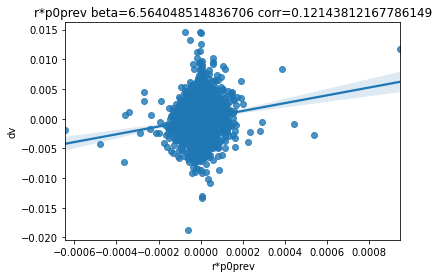

Text(0.5, 1.0, 'r*rrprev beta=13.821026533866373 corr=0.12234769899220775')

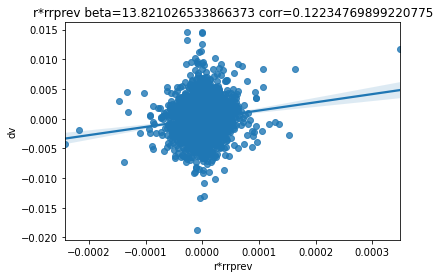

Text(0.5, 1.0, 'r beta=0.09063153591074612 corr=0.08493509282672676')

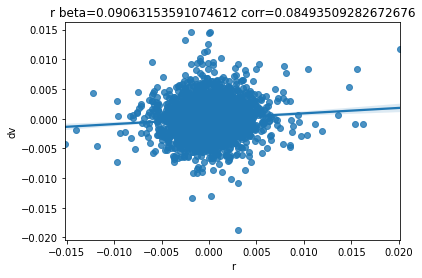

In [117]:
#5Min
dfv=DF(vfres)

dfv['r']=dfv['s'].pct_change()#*dfv['rr'].shift(1)
dfv['r*rrprev']=dfv['r']*dfv['rr'].shift(1)
dfv['r*p0prev']=dfv['r']*dfv['p0'].shift(1)
dfv['r*convprev']=dfv['r']*dfv['conv'].shift(1)

dfv['dv']=dfv['volATM'].diff(1)
dfv.head()
sm.OLS(dfv['dv'],dfv['r'],missing='drop').fit().params

sns.regplot(x='r*p0prev',y='dv',data=dfv).set_title(f"r*p0prev beta={sm.OLS(dfv['dv'],dfv['r*p0prev'],missing='drop').fit().params[0]} corr={dfv.corr()['dv']['r*p0prev']}")
plt.show()
sns.regplot(x='r*rrprev',y='dv',data=dfv).set_title(f"r*rrprev beta={sm.OLS(dfv['dv'],dfv['r*rrprev'],missing='drop').fit().params[0]} corr={dfv.corr()['dv']['r*rrprev']}")
plt.show()
sns.regplot(x='r',y='dv',data=dfv).set_title(f"r beta={sm.OLS(dfv['dv'],dfv['r'],missing='drop').fit().params[0]} corr={dfv.corr()['dv']['r']}")

,t,T,volATM,s,rr,conv,perc,p0,p1,p2,p3,p4,p5,r,r*rrprev,r*p0prev,r*convprev,dv
0,2021-08-06 15:00:00,2021-09-24 08:00:00,0.8556019135,42653.91,0.004915391915,0.005214830715,0.9310344828,-0.003950506307,0.05590581123,0.08737834748,0.02789323763,0.1909212866,-0.1839609846,nan,nan,nan,nan,nan
1,2021-08-06 16:00:00,2021-09-24 08:00:00,0.8607453065,43029.23,0.007954733442,0.004592743883,0.8666666667,0.01152478675,0.05927115915,0.09250225865,0.03135873652,0.1653220552,-0.1783056,0.008799193321,4.325148371e-05,-3.476126871e-05,4.58863036e-05,0.005143393
2,2021-08-06 17:00:00,2021-09-24 08:00:00,0.8582033725,43389.3,0.007476631709,0.003478387166,0.8666666667,0.01865616107,0.04828059036,0.09821064931,0.03660426958,0.1745650946,-0.1883862786,0.008368032614,6.656546888e-05,9.643979143e-05,3.84322306e-05,-0.002541934
3,2021-08-06 18:00:00,2021-09-24 08:00:00,0.8613242955,43294.62,0.008327438969,0.004083360163,0.8709677419,0.01703342713,0.05666338223,0.09540025937,0.03420403111,0.1728238768,-0.1915943004,-0.002182104805,-1.631479398e-05,-4.07096987e-05,-7.590205347e-06,0.003120923
4,2021-08-06 19:00:00,2021-09-24 08:00:00,0.8595138545,43397.59,0.009766916102,0.003697985147,0.8064516129,0.02539569236,0.05904893297,0.09928324004,0.03489382804,0.1716761775,-0.1873383149,0.002378355555,1.980561073e-05,4.051154605e-05,9.711682329e-06,-0.001810441


r   0.189010167
dtype: float64

Text(0.5, 1.0, 'r*p0prev beta=12.127195653082827 corr=0.28543982626159375')

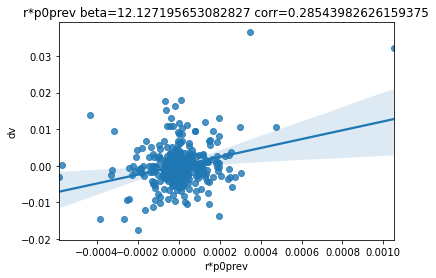

Text(0.5, 1.0, 'r*rrprev beta=21.770871892537702 corr=0.27247671875860474')

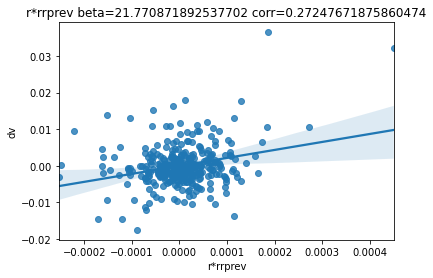

Text(0.5, 1.0, 'r beta=0.1890101669937998 corr=0.2228426637451618')

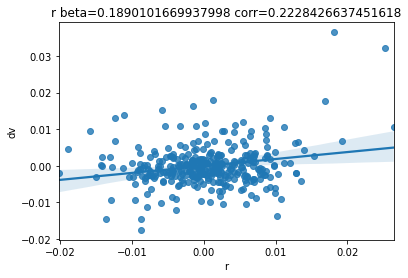

In [113]:
#hourly
dfv=DF(vfres)

dfv['r']=dfv['s'].pct_change()#*dfv['rr'].shift(1)
dfv['r*rrprev']=dfv['r']*dfv['rr'].shift(1)
dfv['r*p0prev']=dfv['r']*dfv['p0'].shift(1)
dfv['r*convprev']=dfv['r']*dfv['conv'].shift(1)

dfv['dv']=dfv['volATM'].diff(1)
dfv.head()
sm.OLS(dfv['dv'],dfv['r'],missing='drop').fit().params

sns.regplot(x='r*p0prev',y='dv',data=dfv).set_title(f"r*p0prev beta={sm.OLS(dfv['dv'],dfv['r*p0prev'],missing='drop').fit().params[0]} corr={dfv.corr()['dv']['r*p0prev']}")
plt.show()
sns.regplot(x='r*rrprev',y='dv',data=dfv).set_title(f"r*rrprev beta={sm.OLS(dfv['dv'],dfv['r*rrprev'],missing='drop').fit().params[0]} corr={dfv.corr()['dv']['r*rrprev']}")
plt.show()
sns.regplot(x='r',y='dv',data=dfv).set_title(f"r beta={sm.OLS(dfv['dv'],dfv['r'],missing='drop').fit().params[0]} corr={dfv.corr()['dv']['r']}")

T=2021-09-24 08:00:00 t=2021-08-07 14:05:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.00514947  0.06773216  0.09950315  0.02989672  0.18556963 -0.18879572]


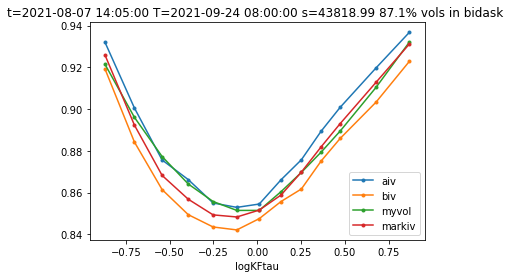

T=2021-09-24 08:00:00 t=2021-08-07 14:10:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.01347195  0.0632172   0.10302951  0.03219995  0.18492855 -0.18818333]


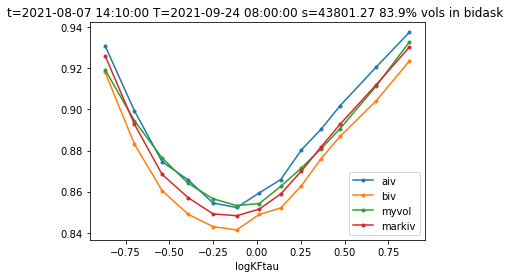

T=2021-09-24 08:00:00 t=2021-08-07 14:15:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.01345359  0.05527214  0.1036234   0.0371715   0.18375711 -0.18675935]


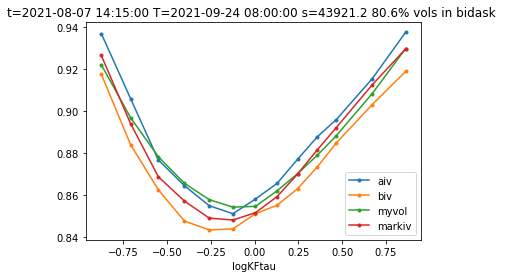

T=2021-09-24 08:00:00 t=2021-08-07 14:20:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.00921534  0.05918843  0.1013719   0.03495916  0.18414096 -0.19101661]


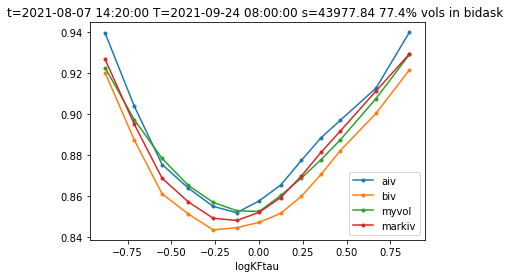

T=2021-09-24 08:00:00 t=2021-08-07 14:25:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.01147793  0.06025017  0.10193618  0.03428299  0.18382572 -0.19162719]


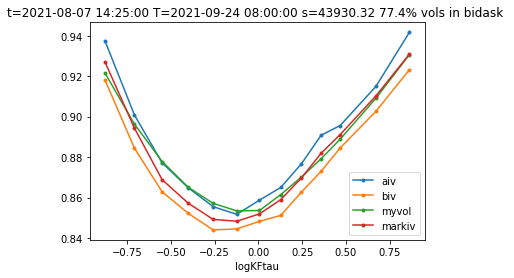

T=2021-09-24 08:00:00 t=2021-08-07 14:30:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.01239541  0.06112289  0.10298542  0.03349954  0.18490832 -0.18751177]


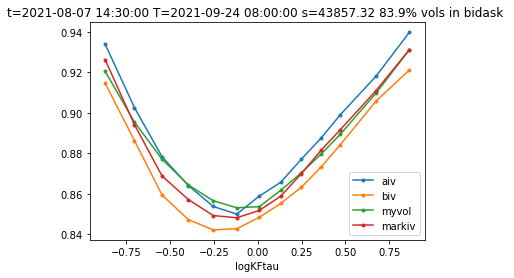

T=2021-09-24 08:00:00 t=2021-08-07 14:35:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[-0.00028293  0.07883762  0.09714064  0.02176111  0.18528179 -0.19344892]


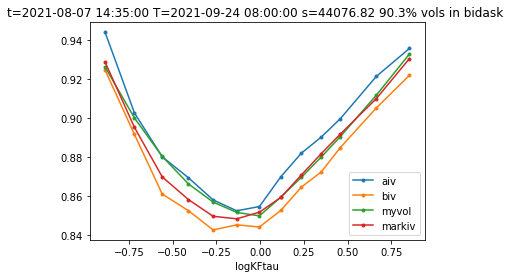

T=2021-09-24 08:00:00 t=2021-08-07 14:40:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.01581548  0.05991146  0.1034162   0.0333828   0.18244365 -0.19073812]


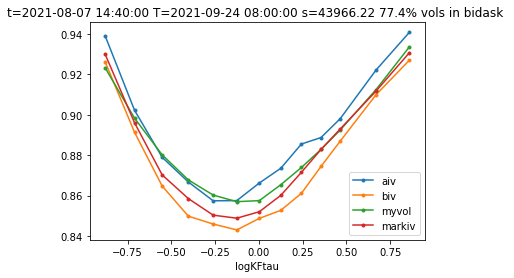

T=2021-09-24 08:00:00 t=2021-08-07 14:45:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.00924913  0.06739359  0.10017273  0.02882221  0.18372151 -0.1931295 ]


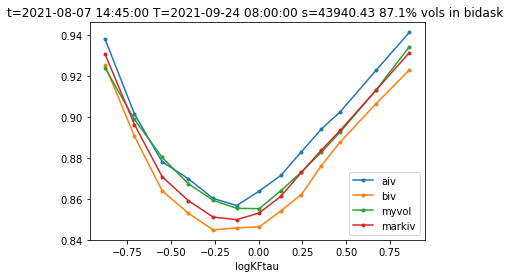

[{'t': Timestamp('2021-08-07 14:05:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.8506832325,
  's': 43818.99,
  'rr': 0.008230767264692518,
  'conv': 0.005662195159673589,
  'perc': 0.8709677419354839,
  'p0': 0.005149472946784409,
  'p1': 0.06773215678103726,
  'p2': 0.09950315130966166,
  'p3': 0.029896722231290734,
  'p4': 0.18556962642482727,
  'p5': -0.18879572448158213},
 {'t': Timestamp('2021-08-07 14:10:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.8534246354999999,
  's': 43801.27,
  'rr': 0.008646749785699681,
  'conv': 0.004790342073279552,
  'perc': 0.8387096774193549,
  'p0': 0.013471949323400963,
  'p1': 0.0632171967302356,
  'p2': 0.10302950712224272,
  'p3': 0.03219995057855055,
  'p4': 0.18492855263676625,
  'p5': -0.1881833338291609},
 {'t': Timestamp('2021-08-07 14:15:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.85432026,
  's': 43921.2,
  'rr': 0.007749887048554394,
  'conv': 0.004282627250226767,
  'perc': 0.80645161290

In [120]:
#same conv
volfit(df.query("tm >'2021-08-07 14:00:00' and tm< '2021-08-07 14:50:00' "),plot=3,model='errfunc_parabolic_linear6',kleft=-2,kright=1.5)

T=2021-09-24 08:00:00 t=2021-08-06 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01966561  0.10283582  0.05677832  0.18210088 -0.16564878]


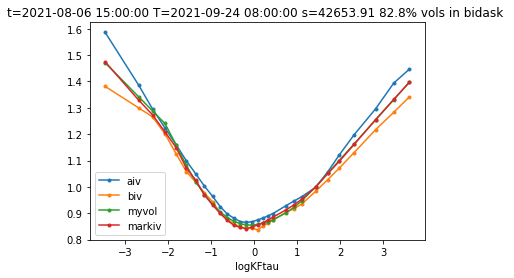

T=2021-09-24 08:00:00 t=2021-08-06 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03101309  0.10524783  0.0539713   0.15810182 -0.16323669]


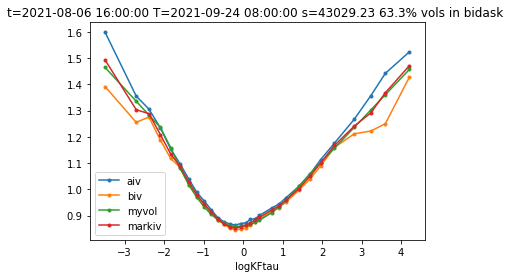

T=2021-09-24 08:00:00 t=2021-08-06 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03087133  0.10626964  0.05032949  0.17109928 -0.17897964]


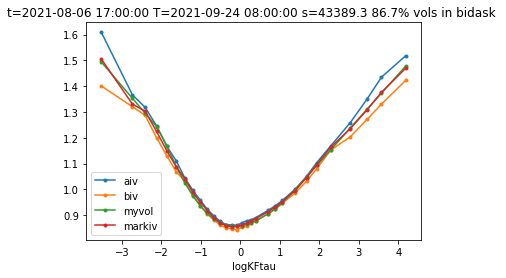

T=2021-09-24 08:00:00 t=2021-08-06 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03500383  0.10724408  0.05154917  0.16802453 -0.17757194]


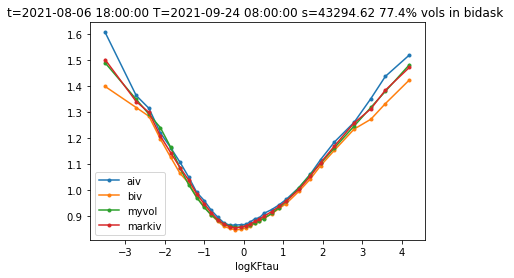

T=2021-09-24 08:00:00 t=2021-08-06 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04056134  0.10924538  0.04968814  0.16756435 -0.17572394]


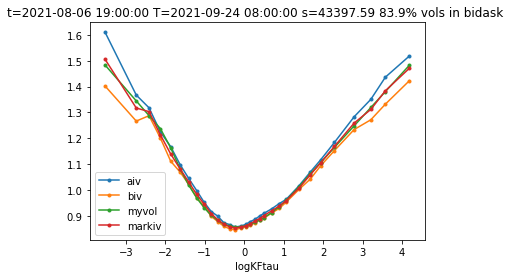

T=2021-09-24 08:00:00 t=2021-08-06 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04074345  0.110784    0.05066401  0.16793983 -0.16622062]


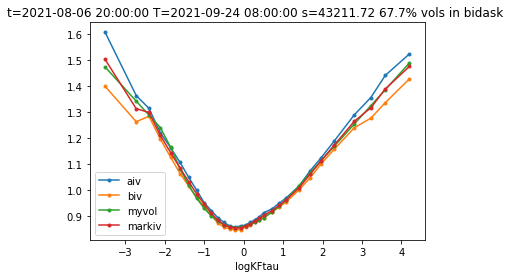

T=2021-09-24 08:00:00 t=2021-08-06 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03930286  0.11078009  0.05339507  0.17155649 -0.16482676]


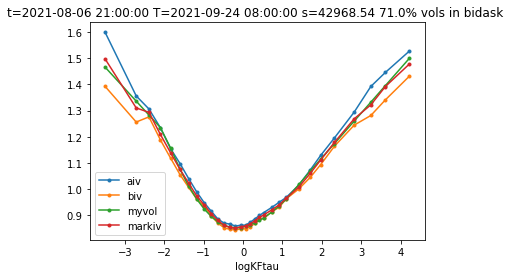

T=2021-09-24 08:00:00 t=2021-08-06 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04339907  0.1114083   0.04931994  0.17112957 -0.17344039]


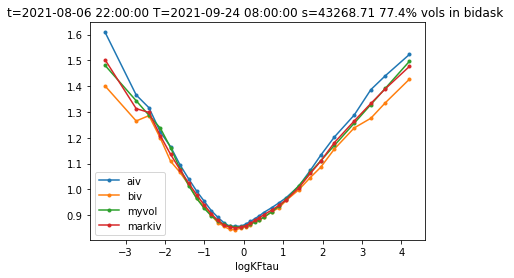

T=2021-09-24 08:00:00 t=2021-08-06 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04308468  0.11132662  0.0505512   0.17160224 -0.17508434]


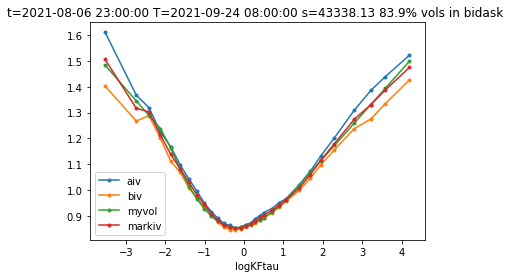

T=2021-09-24 08:00:00 t=2021-08-07 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0400133   0.10854377  0.05066659  0.17006454 -0.18388479]


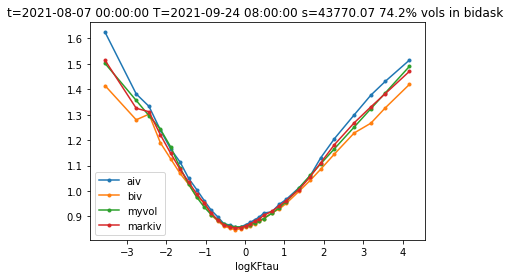

T=2021-09-24 08:00:00 t=2021-08-07 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03949451  0.10825725  0.05021459  0.17205333 -0.18485538]


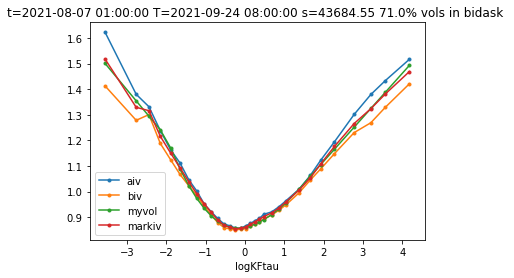

T=2021-09-24 08:00:00 t=2021-08-07 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04236041  0.11098379  0.04781069  0.17426585 -0.18496211]


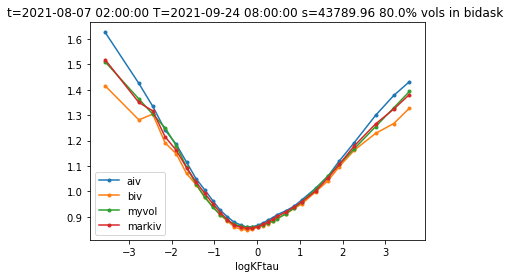

T=2021-09-24 08:00:00 t=2021-08-07 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0408188   0.11245816  0.05291796  0.17317775 -0.18165425]


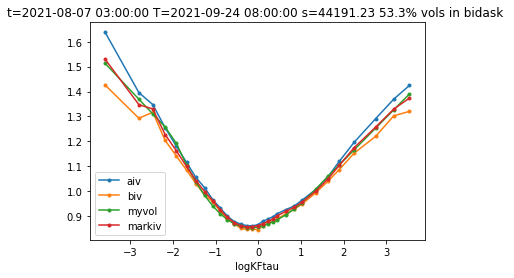

T=2021-09-24 08:00:00 t=2021-08-07 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0319013   0.10958913  0.05958972  0.1776384  -0.1746393 ]


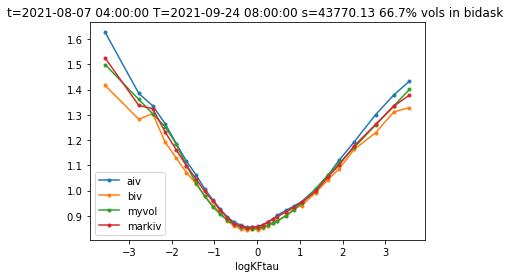

T=2021-09-24 08:00:00 t=2021-08-07 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03721759  0.11439407  0.05477423  0.18173419 -0.17460323]


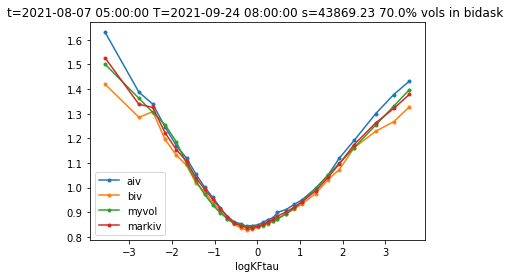

T=2021-09-24 08:00:00 t=2021-08-07 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03442606  0.11509051  0.06039816  0.18101061 -0.16562329]


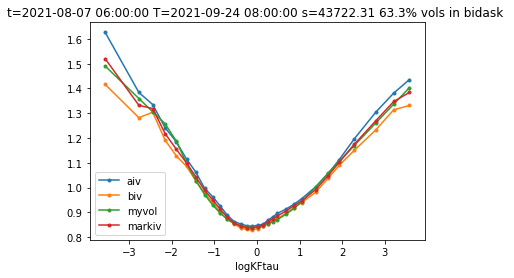

T=2021-09-24 08:00:00 t=2021-08-07 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04220571  0.12101851  0.0540785   0.18045399 -0.18189644]


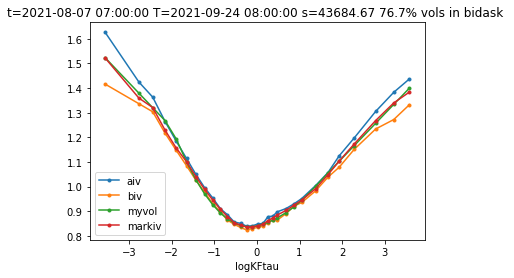

T=2021-09-24 08:00:00 t=2021-08-07 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03283633  0.11592263  0.06081827  0.18344936 -0.17060099]


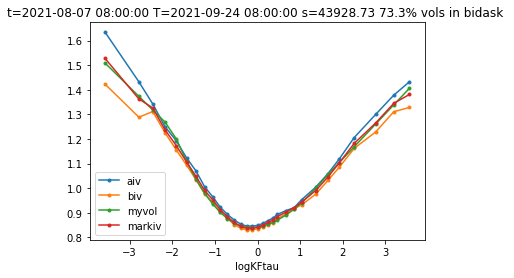

T=2021-09-24 08:00:00 t=2021-08-07 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04080385  0.12037535  0.05266089  0.18215453 -0.17153526]


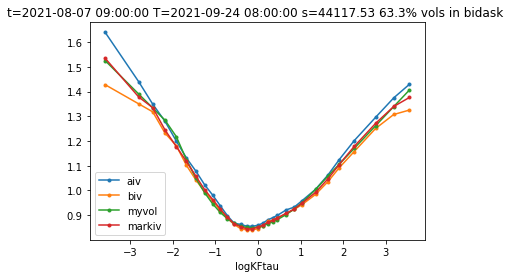

T=2021-09-24 08:00:00 t=2021-08-07 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0324878   0.10777815  0.05648073  0.17243805 -0.18888068]


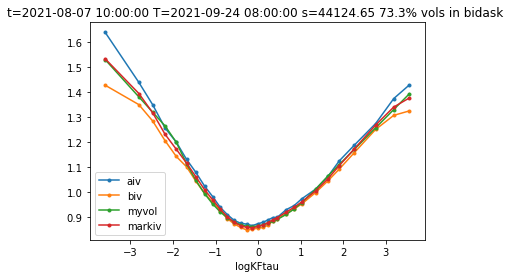

T=2021-09-24 08:00:00 t=2021-08-07 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03286381  0.11208439  0.05649428  0.17475821 -0.18318551]


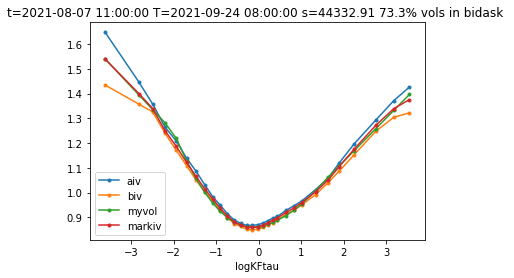

T=2021-09-24 08:00:00 t=2021-08-07 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03149624  0.1148861   0.05810668  0.17790013 -0.17490194]


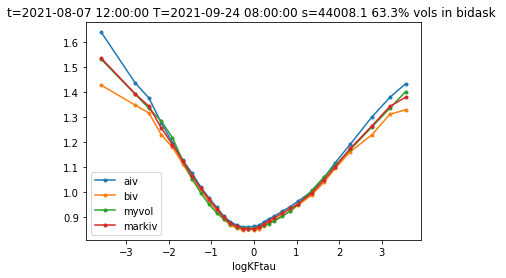

T=2021-09-24 08:00:00 t=2021-08-07 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03210746  0.11611164  0.05824788  0.17036544 -0.16845493]


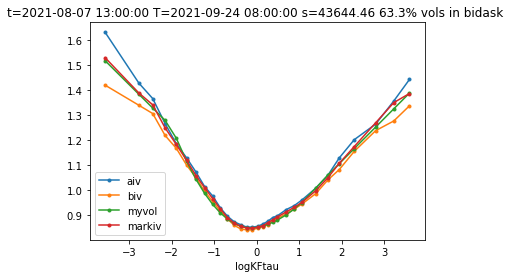

T=2021-09-24 08:00:00 t=2021-08-07 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03432446  0.11630929  0.05466279  0.17674595 -0.17530547]


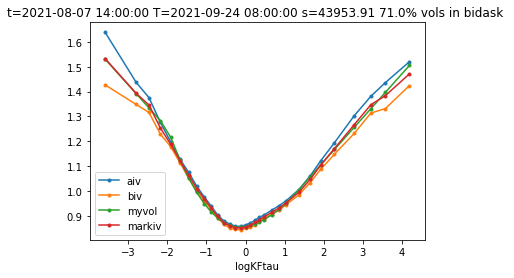

T=2021-09-24 08:00:00 t=2021-08-07 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03219556  0.11744928  0.05875174  0.17627041 -0.16820883]


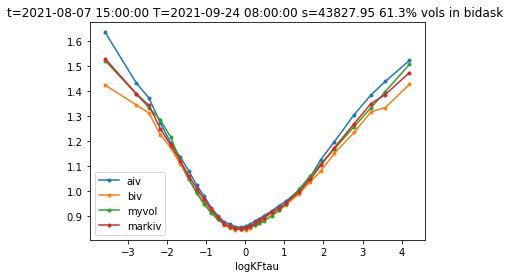

T=2021-09-24 08:00:00 t=2021-08-07 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03289866  0.11586814  0.05735473  0.17584036 -0.17306342]


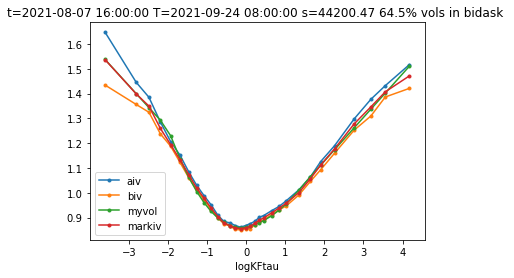

T=2021-09-24 08:00:00 t=2021-08-07 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0310218   0.11455235  0.05933587  0.17218559 -0.16496841]


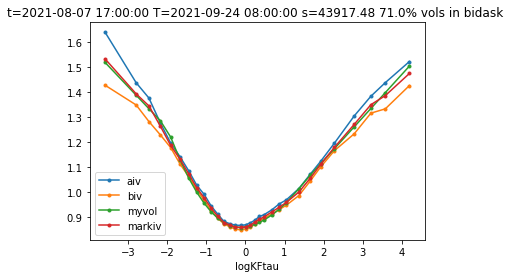

T=2021-09-24 08:00:00 t=2021-08-07 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.02949506  0.11280056  0.05549914  0.17529814 -0.17317569]


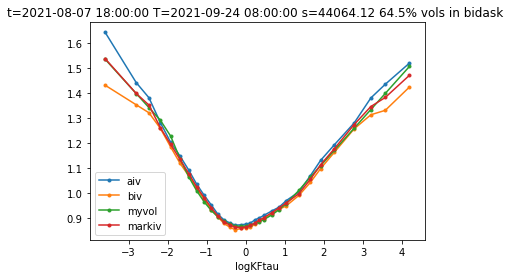

T=2021-09-24 08:00:00 t=2021-08-07 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.02273278  0.11043277  0.05790334  0.17457458 -0.17407442]


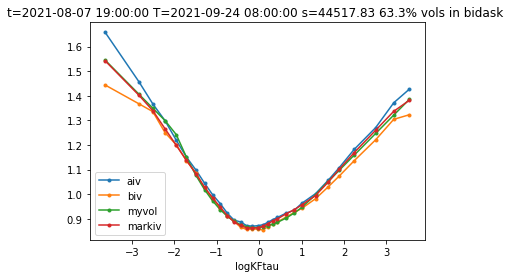

T=2021-09-24 08:00:00 t=2021-08-07 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03050314  0.11501678  0.05343296  0.17714043 -0.18004032]


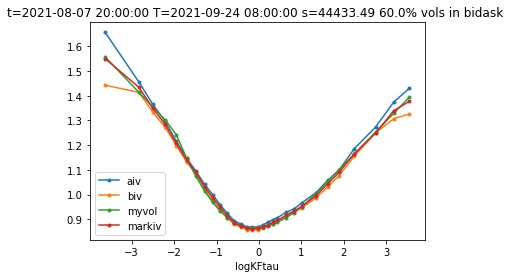

T=2021-09-24 08:00:00 t=2021-08-07 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.02542794  0.10948543  0.05608899  0.17194537 -0.16720956]


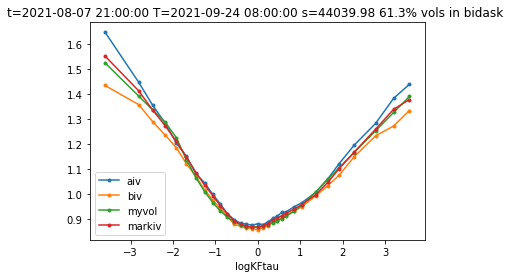

T=2021-09-24 08:00:00 t=2021-08-07 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03277802  0.11523896  0.05193219  0.17548489 -0.16635669]


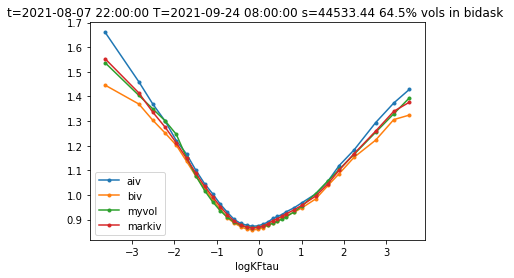

T=2021-09-24 08:00:00 t=2021-08-07 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03814287  0.11599179  0.04533598  0.17110599 -0.17976892]


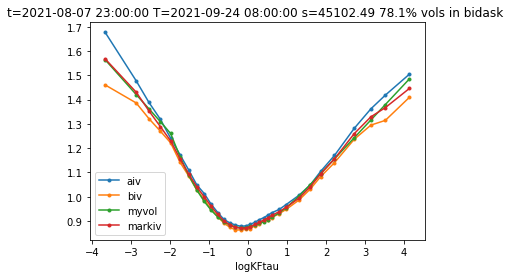

T=2021-09-24 08:00:00 t=2021-08-08 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03775011  0.11614698  0.04600404  0.17117425 -0.17976628]


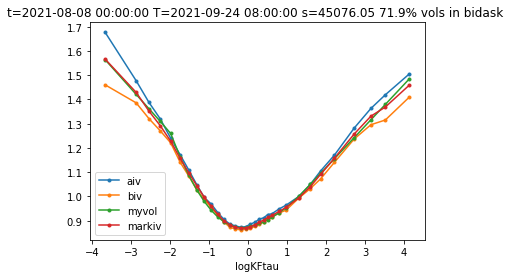

T=2021-09-24 08:00:00 t=2021-08-08 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03447437  0.11584405  0.04962095  0.17196811 -0.16904118]


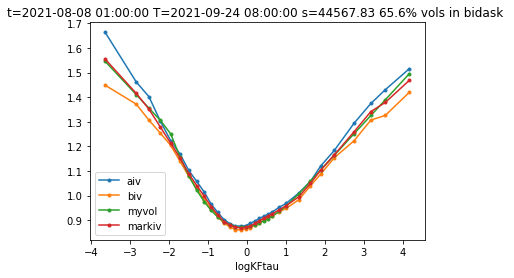

T=2021-09-24 08:00:00 t=2021-08-08 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03084142  0.109821    0.04811915  0.17191591 -0.17345982]


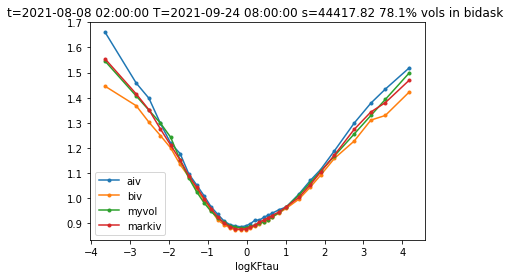

T=2021-09-24 08:00:00 t=2021-08-08 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03853485  0.11407495  0.04447481  0.17334191 -0.18257092]


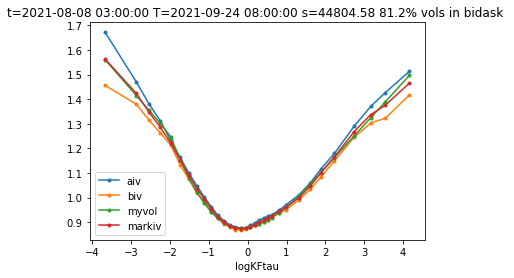

T=2021-09-24 08:00:00 t=2021-08-08 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03543424  0.11332904  0.04679781  0.17468205 -0.18191957]


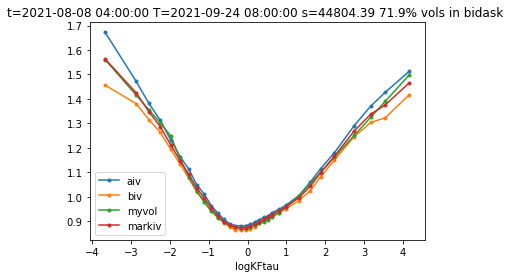

T=2021-09-24 08:00:00 t=2021-08-08 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.02994425  0.11096354  0.04876136  0.17205812 -0.18632713]


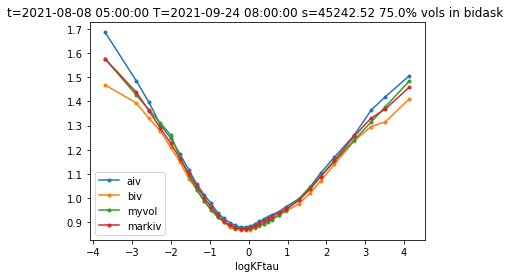

T=2021-09-24 08:00:00 t=2021-08-08 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03661798  0.112791    0.04378938  0.16779612 -0.18644001]


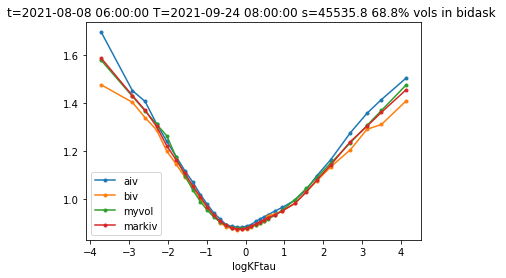

T=2021-09-24 08:00:00 t=2021-08-08 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04287886  0.11518546  0.0377533   0.14982099 -0.16436976]


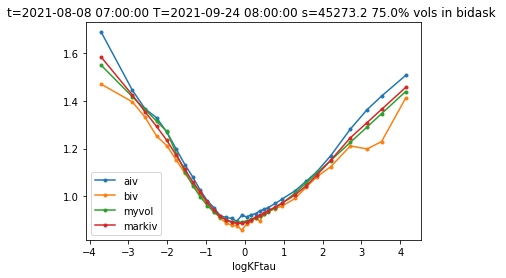

T=2021-09-24 08:00:00 t=2021-08-08 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03573406  0.11107209  0.0495652   0.15831582 -0.17978878]


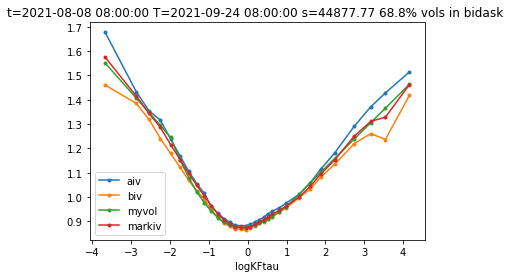

T=2021-09-24 08:00:00 t=2021-08-08 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.02818728  0.109353    0.05214397  0.16013943 -0.17779238]


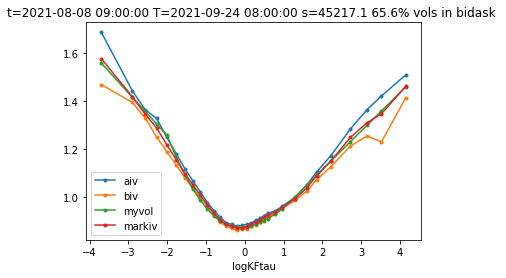

T=2021-09-24 08:00:00 t=2021-08-08 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04451317  0.12119261  0.04539432  0.15469294 -0.15664096]


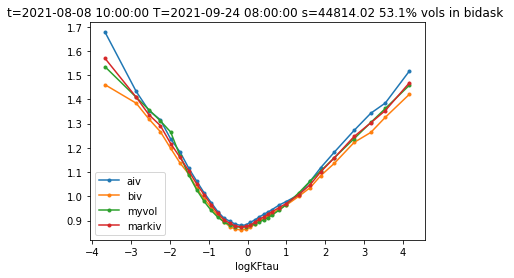

T=2021-09-24 08:00:00 t=2021-08-08 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03684382  0.11800849  0.05227317  0.15114256 -0.1679782 ]


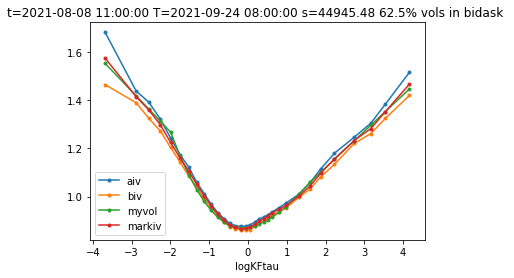

T=2021-09-24 08:00:00 t=2021-08-08 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03431147  0.12061797  0.0579419   0.14523148 -0.15177473]


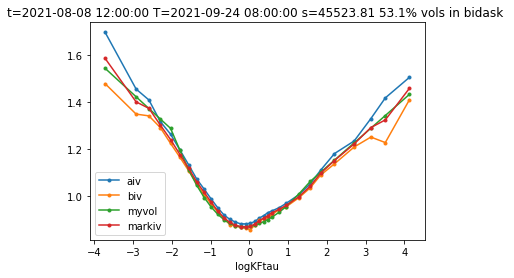

T=2021-09-24 08:00:00 t=2021-08-08 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03486097  0.11318444  0.05622084  0.15995196 -0.17512609]


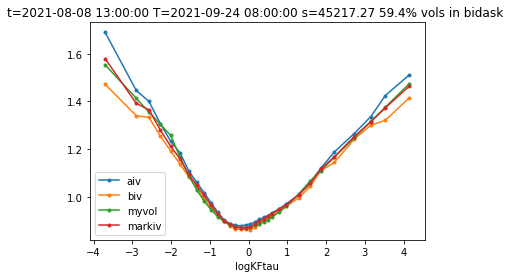

T=2021-09-24 08:00:00 t=2021-08-08 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03968153  0.11352901  0.05290336  0.15680648 -0.17261499]


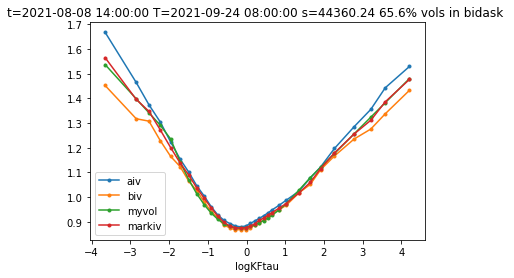

T=2021-09-24 08:00:00 t=2021-08-08 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0344491   0.11150838  0.05521289  0.15920498 -0.1712672 ]


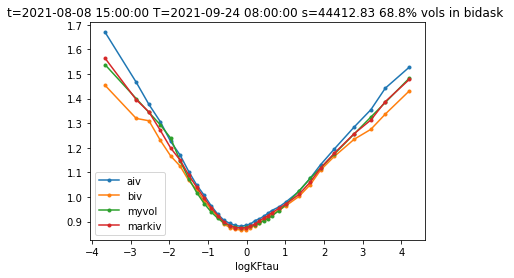

T=2021-09-24 08:00:00 t=2021-08-08 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03319878  0.11159092  0.0587633   0.15113527 -0.17643535]


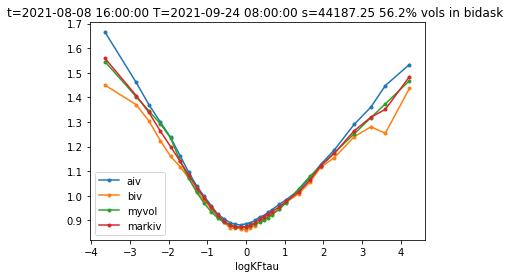

T=2021-09-24 08:00:00 t=2021-08-08 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03548921  0.1140144   0.05961322  0.15107235 -0.17265927]


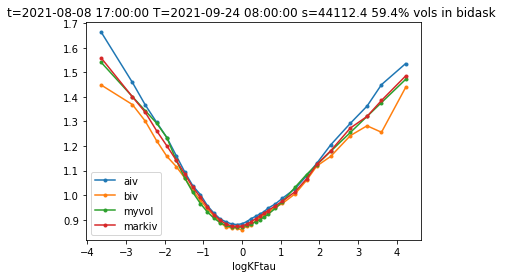

T=2021-09-24 08:00:00 t=2021-08-08 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03438177  0.11142749  0.05546638  0.15652787 -0.17471314]


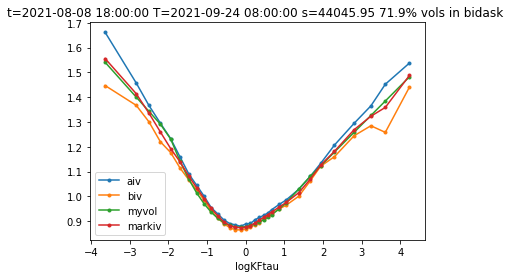

T=2021-09-24 08:00:00 t=2021-08-08 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04162445  0.11633041  0.05263458  0.15455126 -0.16060012]


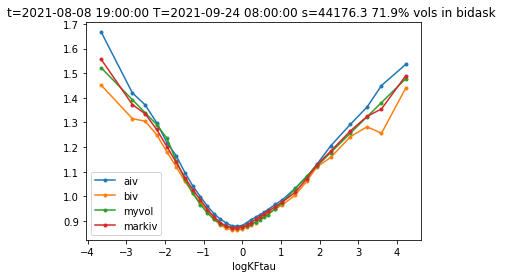

T=2021-09-24 08:00:00 t=2021-08-08 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04926007  0.11860259  0.04823114  0.15822324 -0.16811399]


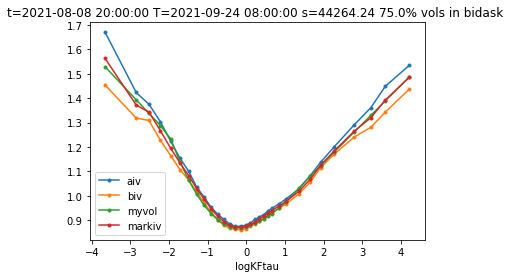

T=2021-09-24 08:00:00 t=2021-08-08 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04686109  0.11740625  0.04534639  0.16091238 -0.17225016]


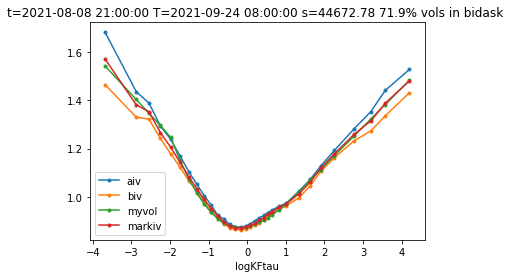

T=2021-09-24 08:00:00 t=2021-08-08 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04877459  0.11816705  0.04510581  0.16081218 -0.18034662]


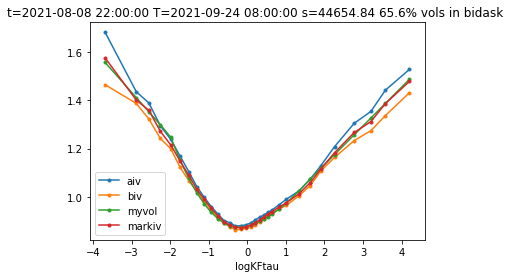

T=2021-09-24 08:00:00 t=2021-08-08 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04471021  0.11563478  0.04825154  0.16270587 -0.17644146]


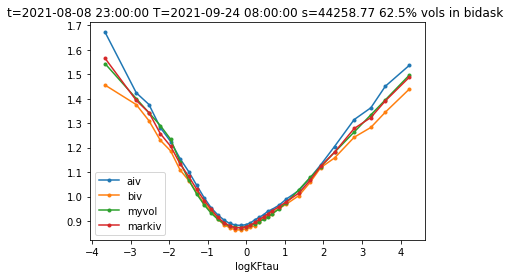

T=2021-09-24 08:00:00 t=2021-08-09 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04607129  0.11611578  0.04714883  0.16135357 -0.16986499]


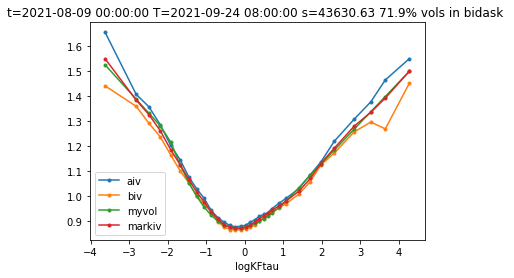

T=2021-09-24 08:00:00 t=2021-08-09 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04455204  0.11711929  0.04614792  0.16129258 -0.16690053]


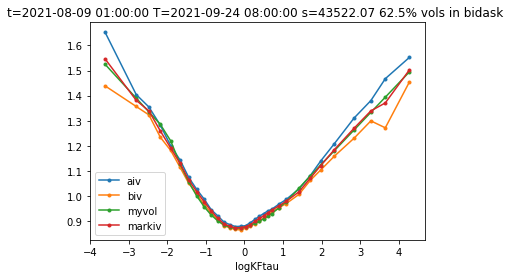

T=2021-09-24 08:00:00 t=2021-08-09 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04541895  0.1175413   0.04352694  0.16449835 -0.16659409]


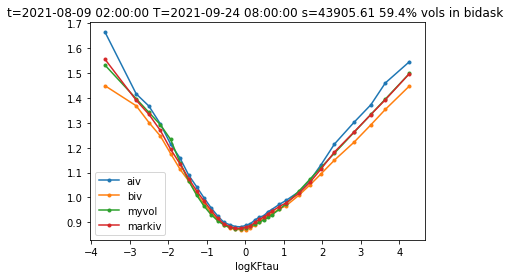

T=2021-09-24 08:00:00 t=2021-08-09 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05369464  0.11927035  0.03830845  0.15638984 -0.16881308]


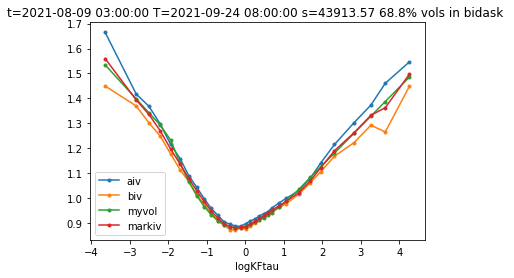

T=2021-09-24 08:00:00 t=2021-08-09 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04658356  0.11448501  0.04100008  0.16967776 -0.17420776]


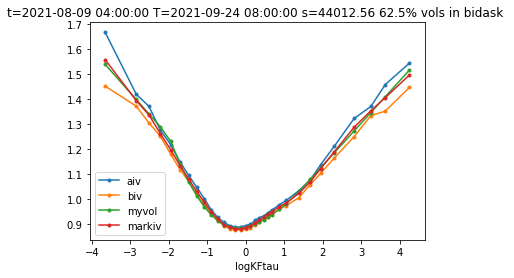

T=2021-09-24 08:00:00 t=2021-08-09 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04610094  0.11562963  0.04208998  0.16917854 -0.17134431]


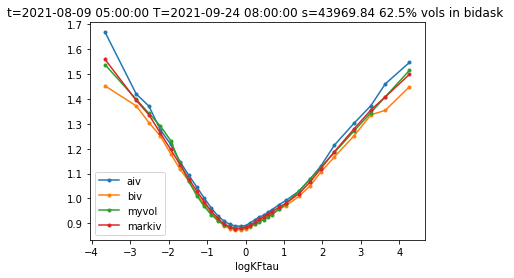

T=2021-09-24 08:00:00 t=2021-08-09 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04450945  0.11375678  0.04203373  0.1692686  -0.17265701]


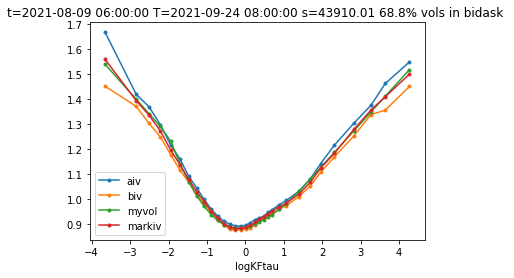

T=2021-09-24 08:00:00 t=2021-08-09 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03568462  0.11040027  0.0435548   0.1658481  -0.16527388]


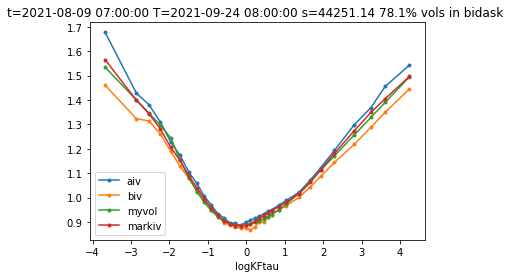

T=2021-09-24 08:00:00 t=2021-08-09 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03953883  0.10710343  0.04307555  0.16016668 -0.17782927]


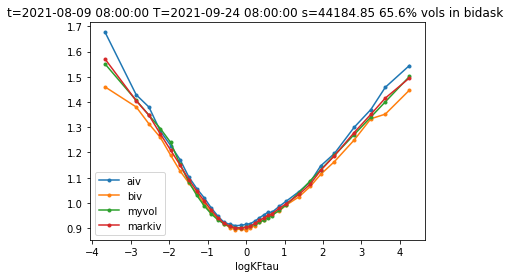

T=2021-09-24 08:00:00 t=2021-08-09 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04043161  0.107155    0.04126781  0.15567931 -0.17819079]


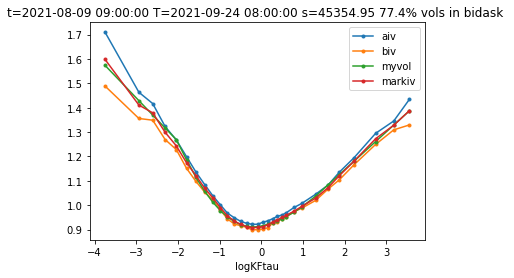

T=2021-09-24 08:00:00 t=2021-08-09 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04297765  0.10339878  0.03297962  0.14002317 -0.17814876]


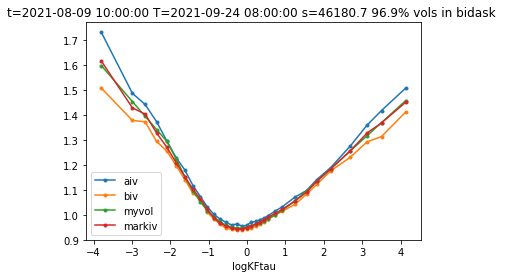

T=2021-09-24 08:00:00 t=2021-08-09 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04799943  0.10224819  0.02986754  0.14735721 -0.18294738]


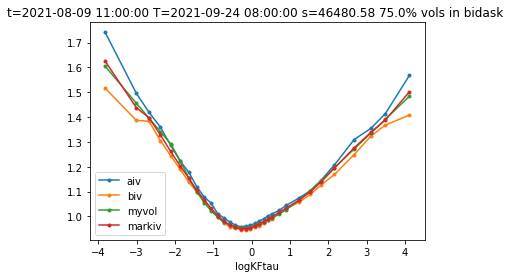

T=2021-09-24 08:00:00 t=2021-08-09 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04175291  0.09811495  0.03492807  0.15585623 -0.19207701]


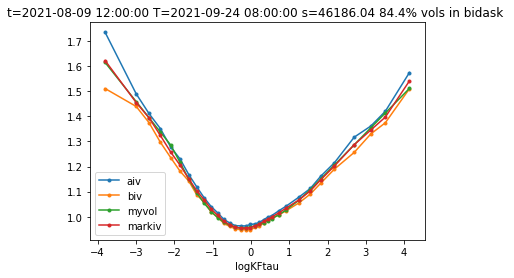

T=2021-09-24 08:00:00 t=2021-08-09 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04229272  0.09860371  0.03495876  0.15229841 -0.18387469]


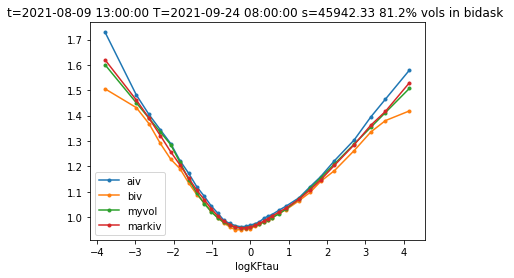

T=2021-09-24 08:00:00 t=2021-08-09 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04696858  0.10088655  0.03427409  0.15504943 -0.18686436]


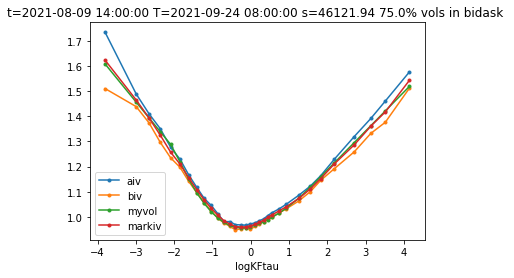

T=2021-09-24 08:00:00 t=2021-08-09 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04426638  0.09512791  0.03257314  0.15425517 -0.19313101]


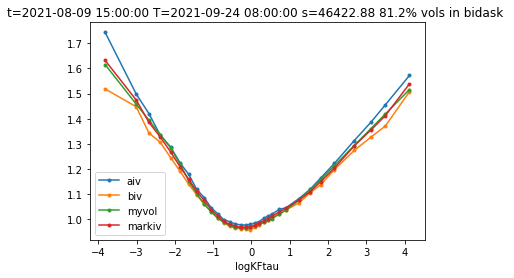

T=2021-09-24 08:00:00 t=2021-08-09 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04443253  0.09421835  0.03156026  0.14828113 -0.1931287 ]


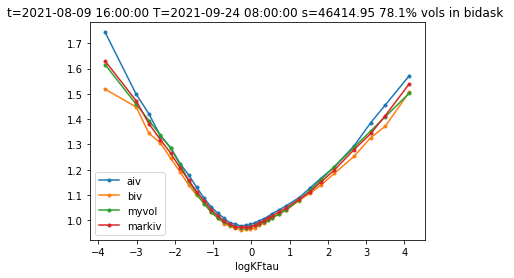

T=2021-09-24 08:00:00 t=2021-08-09 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04262824  0.09385505  0.03303997  0.15320865 -0.19275776]


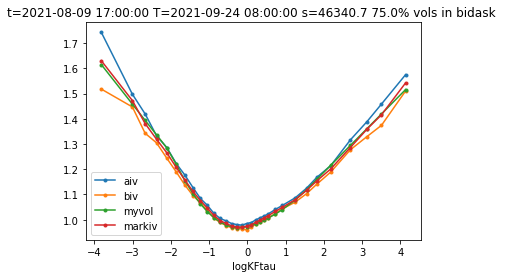

T=2021-09-24 08:00:00 t=2021-08-09 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05390053  0.09577622  0.02060412  0.1528851  -0.19701882]


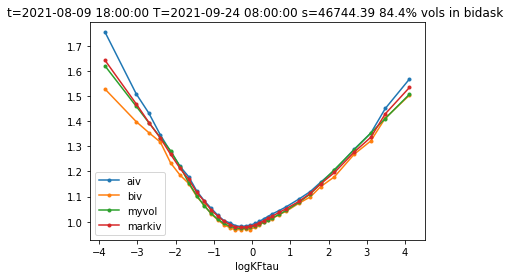

T=2021-09-24 08:00:00 t=2021-08-09 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05212575  0.09278435  0.02081951  0.14635704 -0.19758254]


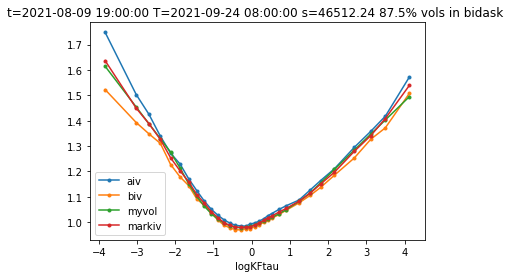

T=2021-09-24 08:00:00 t=2021-08-09 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0614532   0.09484326  0.01666621  0.13881849 -0.18687806]


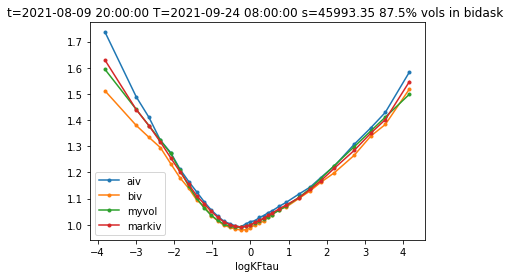

T=2021-09-24 08:00:00 t=2021-08-09 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06130206  0.09758053  0.01796348  0.13807222 -0.18363503]


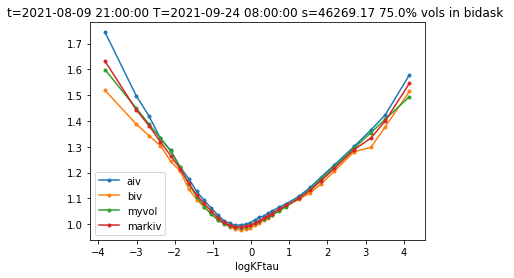

T=2021-09-24 08:00:00 t=2021-08-09 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06240209  0.09507704  0.01531274  0.12821766 -0.19365894]


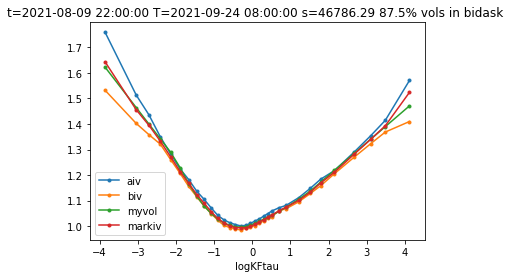

T=2021-09-24 08:00:00 t=2021-08-09 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06099383  0.09407903  0.01888194  0.12946766 -0.19577693]


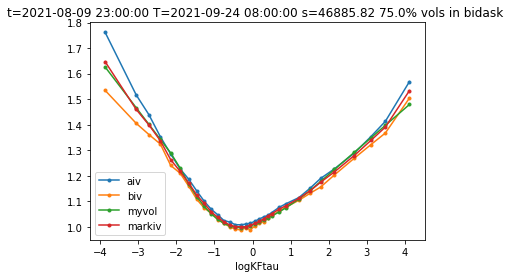

T=2021-09-24 08:00:00 t=2021-08-10 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0666591   0.1001983   0.01646435  0.1361819  -0.18114377]


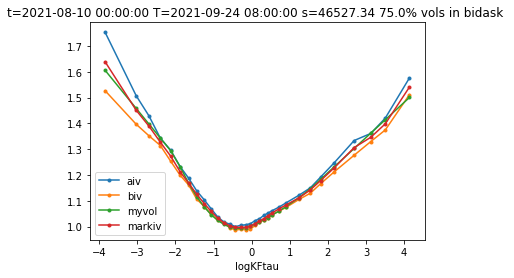

T=2021-09-24 08:00:00 t=2021-08-10 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05053983  0.09251175  0.02391704  0.13856145 -0.20166672]


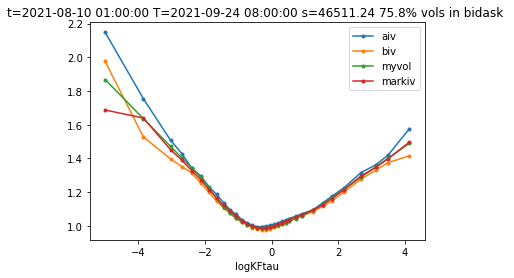

T=2021-09-24 08:00:00 t=2021-08-10 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0489092   0.0916133   0.02459676  0.14376148 -0.21599748]


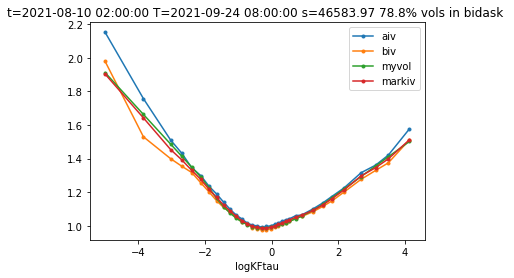

T=2021-09-24 08:00:00 t=2021-08-10 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04699396  0.08961218  0.02592791  0.14225634 -0.23491435]


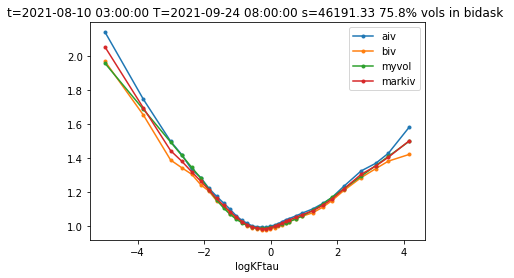

T=2021-09-24 08:00:00 t=2021-08-10 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05260695  0.09323428  0.02275334  0.14790204 -0.23191507]


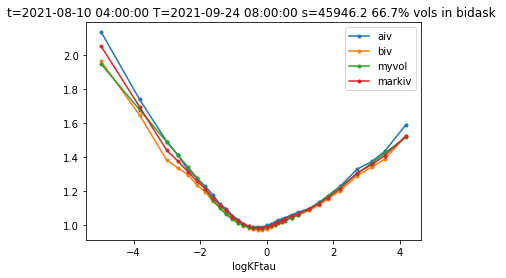

T=2021-09-24 08:00:00 t=2021-08-10 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0492339   0.09106528  0.02736631  0.13760971 -0.23182698]


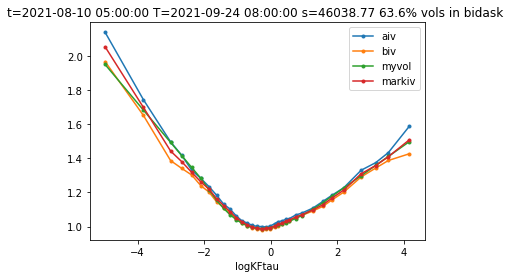

T=2021-09-24 08:00:00 t=2021-08-10 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04623155  0.0931487   0.02644525  0.14067908 -0.23061071]


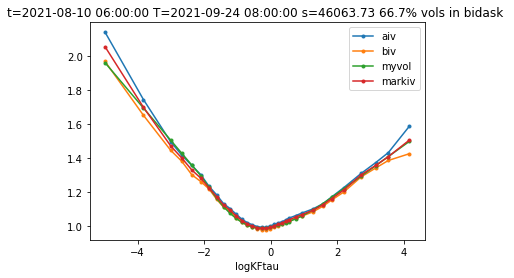

T=2021-09-24 08:00:00 t=2021-08-10 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04912789  0.09129894  0.02097228  0.13264045 -0.22963278]


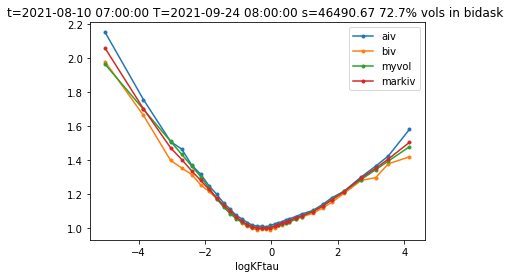

T=2021-09-24 08:00:00 t=2021-08-10 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04435121  0.08710127  0.02271195  0.13748111 -0.23503398]


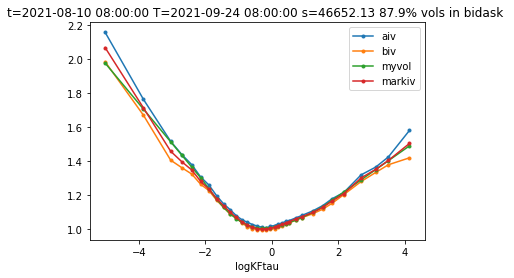

T=2021-09-24 08:00:00 t=2021-08-10 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04754549  0.08953515  0.02368757  0.13300354 -0.23567903]


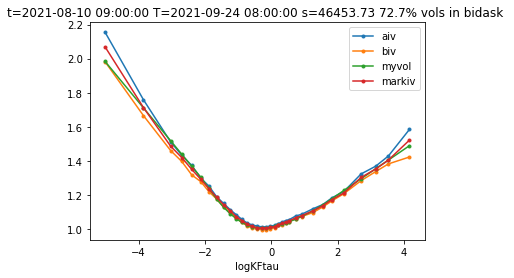

T=2021-09-24 08:00:00 t=2021-08-10 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03625362  0.08498049  0.03313845  0.13880476 -0.2305778 ]


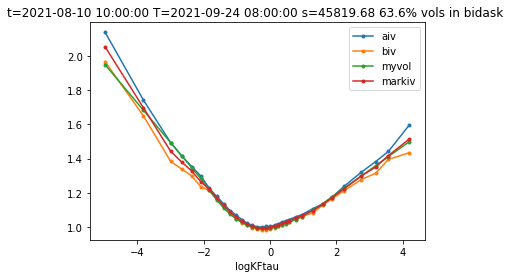

T=2021-09-24 08:00:00 t=2021-08-10 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0347291   0.08406142  0.03666569  0.13697148 -0.23301076]


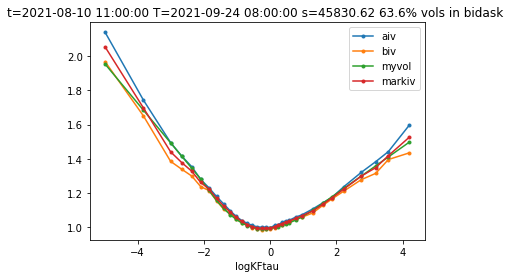

T=2021-09-24 08:00:00 t=2021-08-10 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04207878  0.0922793   0.02712189  0.14723312 -0.18553911]


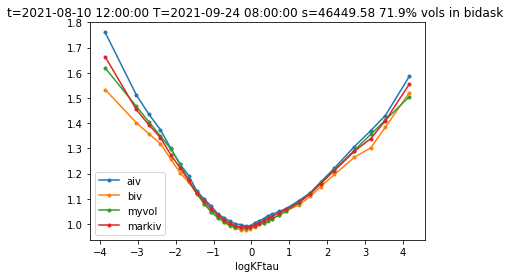

T=2021-09-24 08:00:00 t=2021-08-10 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03796195  0.08946202  0.0326567   0.14726796 -0.21156509]


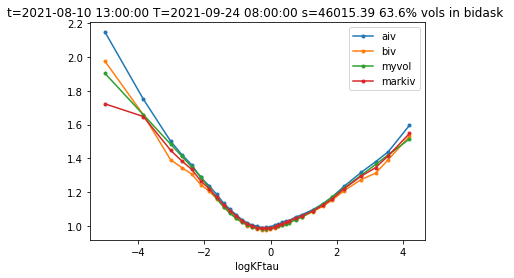

T=2021-09-24 08:00:00 t=2021-08-10 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03361864  0.08623546  0.0312714   0.15324392 -0.21564256]


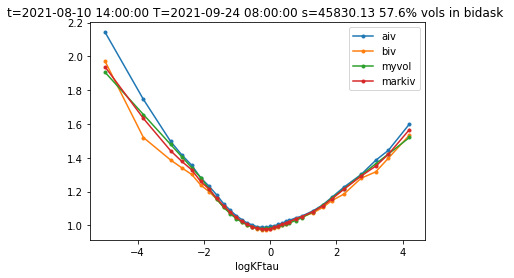

T=2021-09-24 08:00:00 t=2021-08-10 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03278124  0.08495476  0.03208087  0.15069439 -0.22501194]


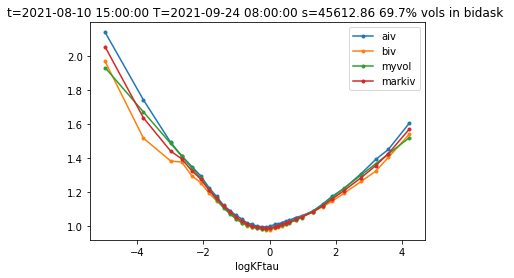

T=2021-09-24 08:00:00 t=2021-08-10 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03733988  0.08851441  0.02997914  0.150687   -0.22816843]


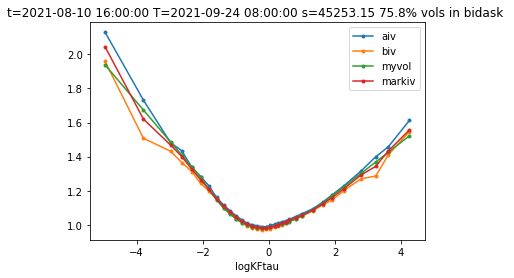

T=2021-09-24 08:00:00 t=2021-08-10 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03702015  0.08753159  0.02846158  0.15154852 -0.22943171]


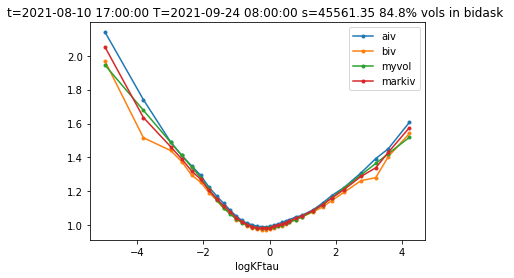

T=2021-09-24 08:00:00 t=2021-08-10 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03267479  0.08637913  0.03292127  0.15155504 -0.2264001 ]


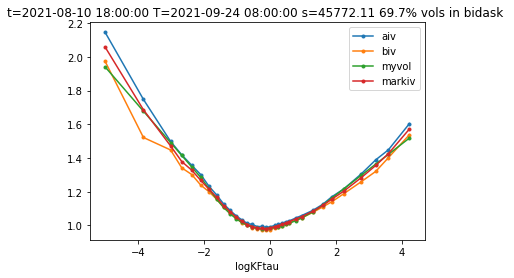

T=2021-09-24 08:00:00 t=2021-08-10 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03699933  0.08825391  0.02809495  0.15301428 -0.22956221]


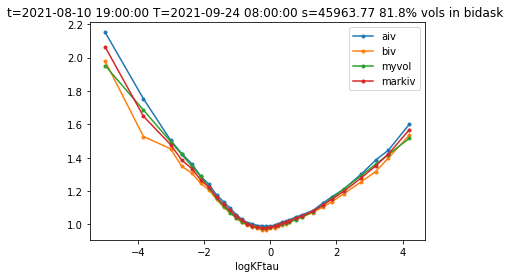

T=2021-09-24 08:00:00 t=2021-08-10 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03612584  0.08960474  0.03175403  0.15039395 -0.22860104]


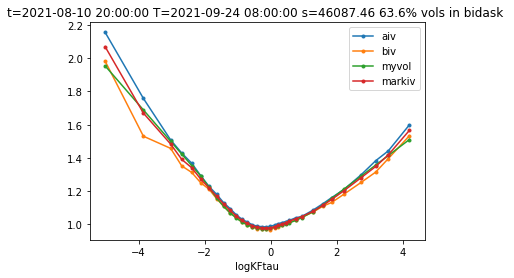

T=2021-09-24 08:00:00 t=2021-08-10 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04413763  0.09651425  0.0257461   0.14897511 -0.19161353]


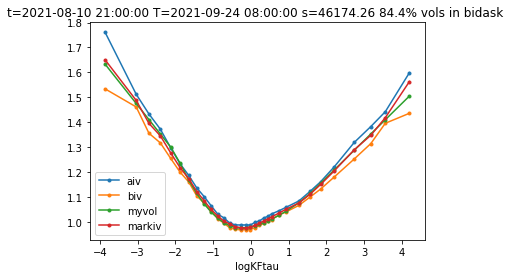

T=2021-09-24 08:00:00 t=2021-08-10 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0450248   0.09804944  0.02672739  0.15874476 -0.18138645]


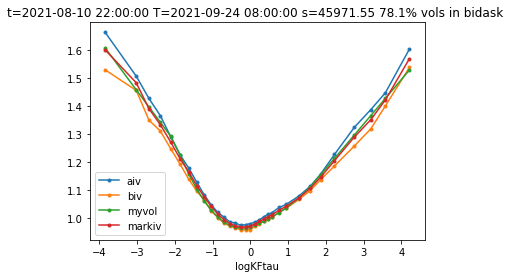

T=2021-09-24 08:00:00 t=2021-08-10 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04797354  0.09933432  0.02499617  0.15930686 -0.19453029]


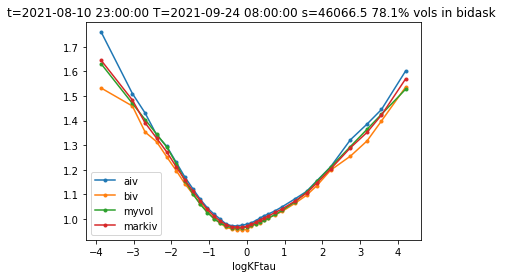

T=2021-09-24 08:00:00 t=2021-08-11 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03680141  0.09463565  0.03248572  0.16012685 -0.19741399]


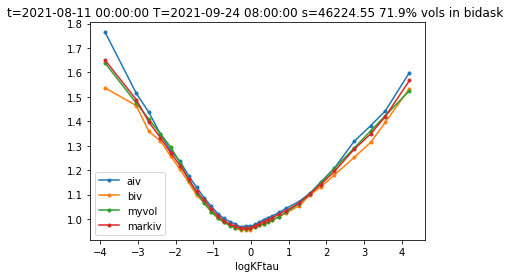

T=2021-09-24 08:00:00 t=2021-08-11 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03401471  0.09277943  0.03414868  0.15008823 -0.18948598]


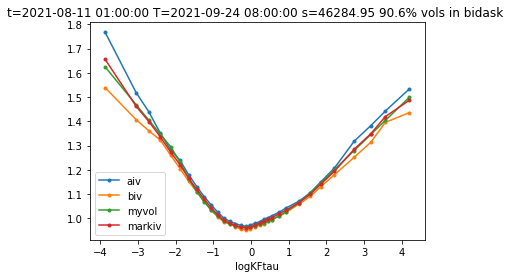

T=2021-09-24 08:00:00 t=2021-08-11 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03327157  0.09463166  0.03680409  0.15659337 -0.21049827]


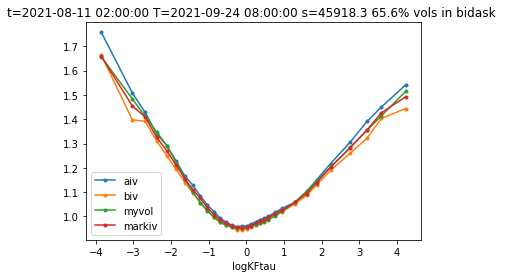

T=2021-09-24 08:00:00 t=2021-08-11 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03584819  0.09833048  0.03740918  0.15255214 -0.18144364]


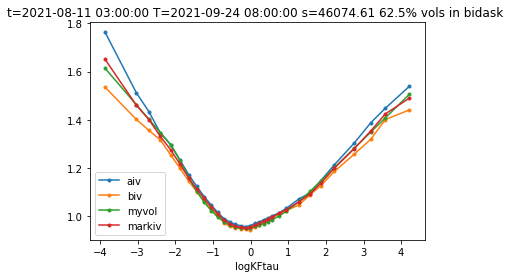

T=2021-09-24 08:00:00 t=2021-08-11 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0378925   0.09921454  0.03601795  0.149752   -0.18520996]


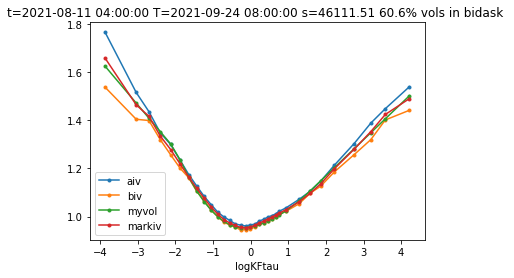

T=2021-09-24 08:00:00 t=2021-08-11 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03656671  0.09659442  0.03666622  0.14812439 -0.16855877]


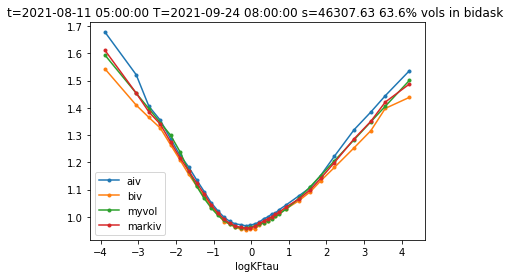

T=2021-09-24 08:00:00 t=2021-08-11 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03436012  0.09443069  0.03723364  0.14759011 -0.2024681 ]


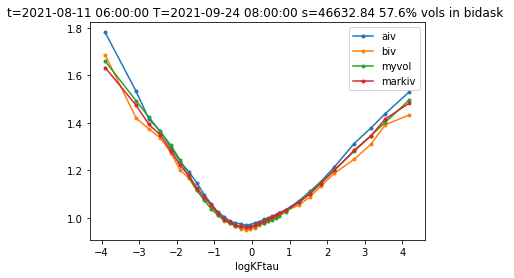

T=2021-09-24 08:00:00 t=2021-08-11 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04045243  0.102628    0.03567122  0.14632462 -0.20901357]


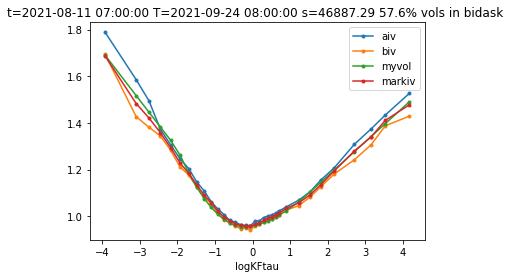

T=2021-09-24 08:00:00 t=2021-08-11 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04148394  0.10163153  0.03159357  0.15085182 -0.19083631]


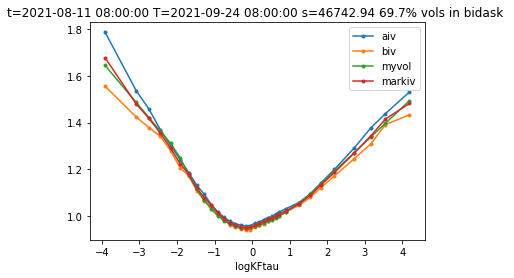

T=2021-09-24 08:00:00 t=2021-08-11 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03733589  0.09827415  0.03327178  0.1566137  -0.21428204]


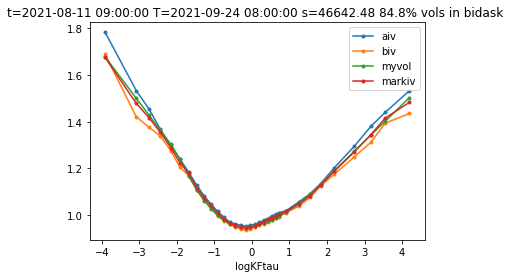

T=2021-09-24 08:00:00 t=2021-08-11 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03778568  0.09811666  0.03355894  0.15630223 -0.2178729 ]


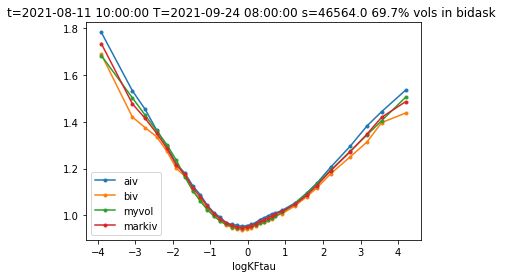

T=2021-09-24 08:00:00 t=2021-08-11 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04268086  0.09996039  0.02976203  0.15736504 -0.19536984]


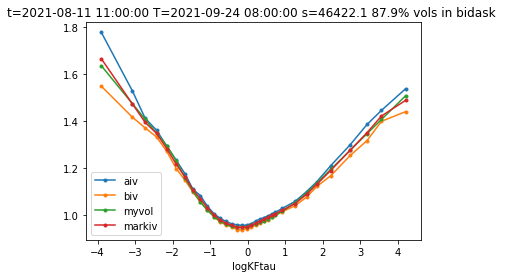

T=2021-09-24 08:00:00 t=2021-08-11 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04131947  0.10133818  0.03126467  0.15793029 -0.197304  ]


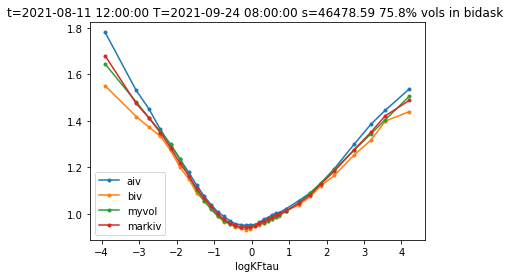

T=2021-09-24 08:00:00 t=2021-08-11 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04235245  0.10189007  0.03397569  0.15371975 -0.21873505]


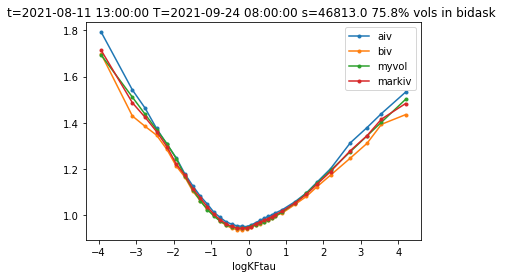

T=2021-09-24 08:00:00 t=2021-08-11 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04431385  0.10256178  0.03087617  0.15040845 -0.19750606]


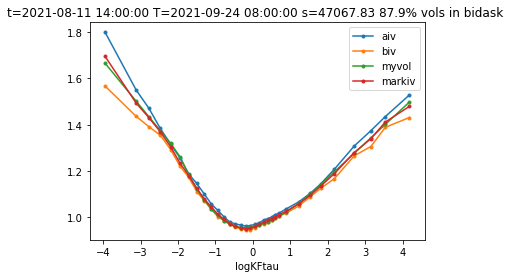

T=2021-09-24 08:00:00 t=2021-08-11 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04681003  0.10296275  0.02872225  0.14767692 -0.20227258]


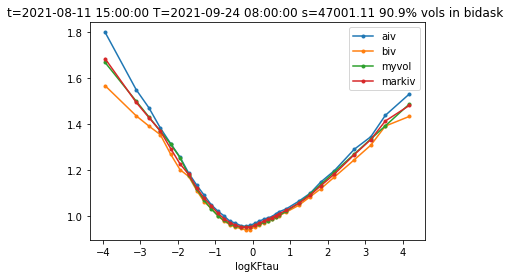

T=2021-09-24 08:00:00 t=2021-08-11 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04530275  0.10155048  0.02810326  0.15108931 -0.20050813]


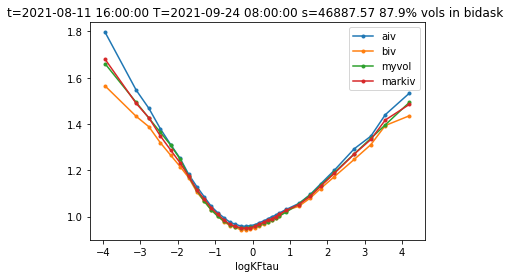

T=2021-09-24 08:00:00 t=2021-08-11 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04726649  0.1030689   0.03109419  0.14936809 -0.19588363]


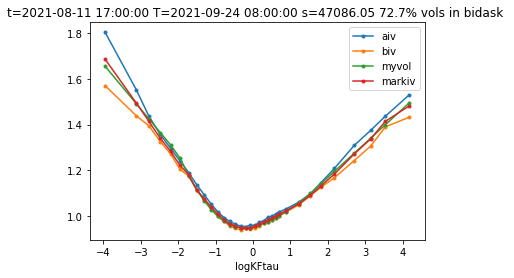

T=2021-09-24 08:00:00 t=2021-08-11 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04625461  0.10076565  0.03049334  0.15124902 -0.19295975]


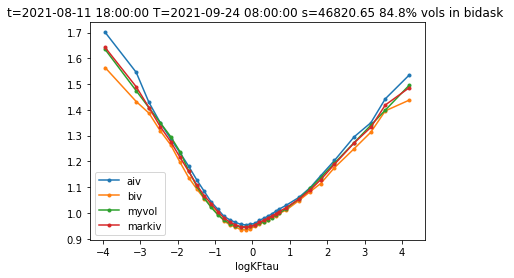

T=2021-09-24 08:00:00 t=2021-08-11 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04381494  0.1003141   0.03176339  0.15180043 -0.19408964]


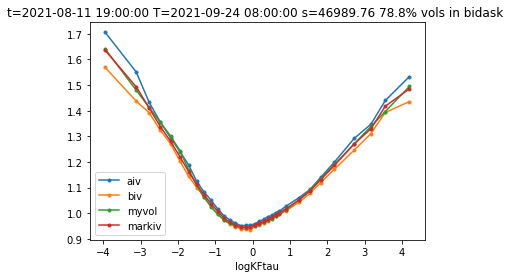

T=2021-09-24 08:00:00 t=2021-08-11 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04275049  0.09636916  0.0318722   0.14804937 -0.20021163]


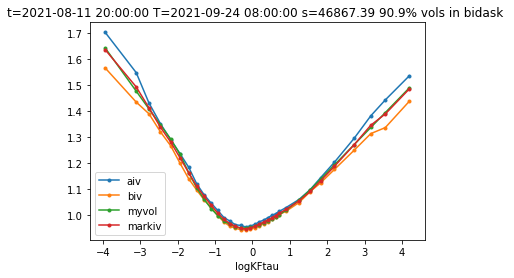

T=2021-09-24 08:00:00 t=2021-08-11 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04687829  0.10151805  0.02903831  0.14862073 -0.17918077]


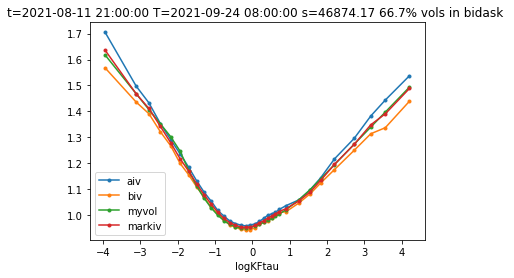

T=2021-09-24 08:00:00 t=2021-08-11 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05045345  0.1028547   0.02688983  0.15268465 -0.18614182]


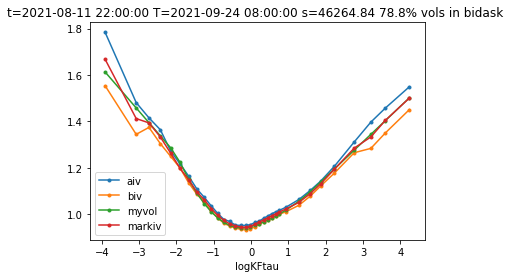

T=2021-09-24 08:00:00 t=2021-08-11 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05249737  0.10438191  0.02618468  0.15170118 -0.1922456 ]


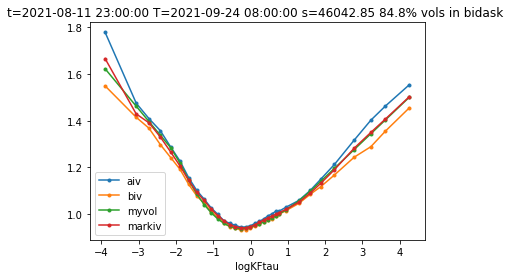

T=2021-09-24 08:00:00 t=2021-08-12 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04925552  0.10330336  0.02728046  0.15768616 -0.19867626]


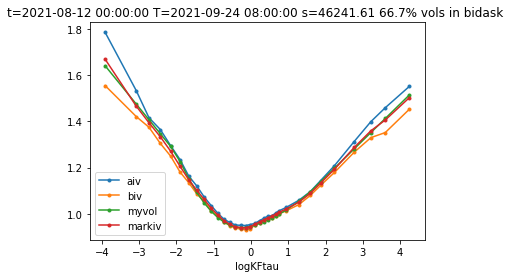

T=2021-09-24 08:00:00 t=2021-08-12 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04828768  0.10342443  0.02958245  0.15989037 -0.22310925]


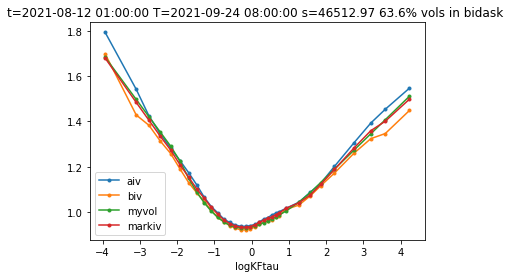

T=2021-09-24 08:00:00 t=2021-08-12 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04648117  0.10311157  0.02963771  0.16062587 -0.21087219]


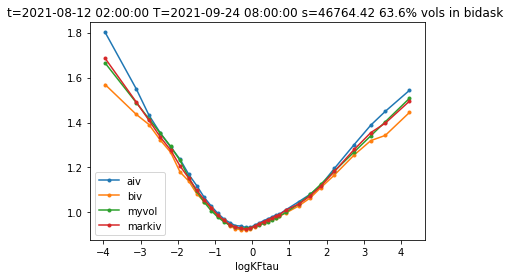

T=2021-09-24 08:00:00 t=2021-08-12 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05197313  0.10843024  0.02618984  0.16471714 -0.2028196 ]


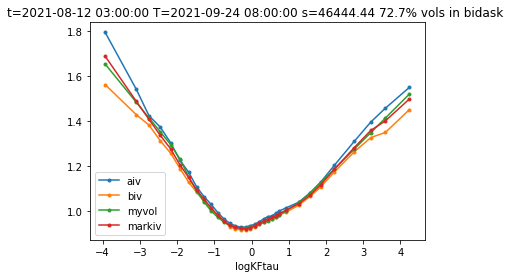

T=2021-09-24 08:00:00 t=2021-08-12 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05091601  0.11217464  0.03030474  0.16178729 -0.21398978]


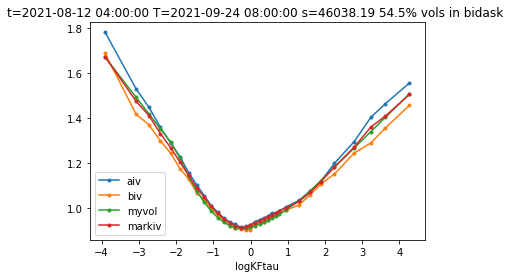

T=2021-09-24 08:00:00 t=2021-08-12 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0450683   0.1095728   0.02995635  0.15497054 -0.18757581]


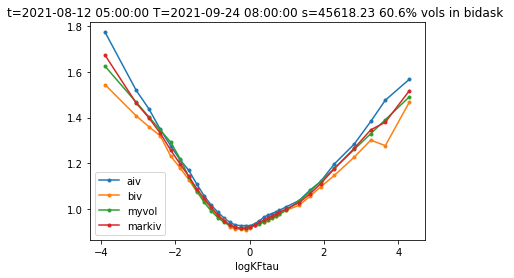

T=2021-09-24 08:00:00 t=2021-08-12 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03988994  0.10459963  0.03161695  0.15623899 -0.18958896]


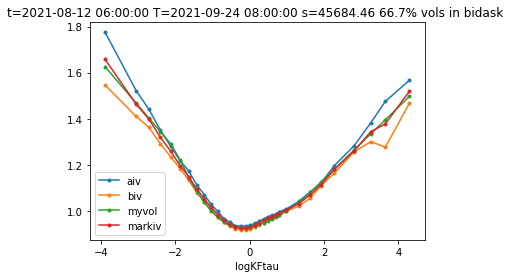

T=2021-09-24 08:00:00 t=2021-08-12 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04663808  0.10574922  0.02210242  0.1522417  -0.18304839]


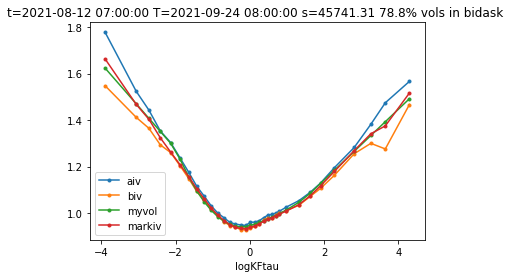

T=2021-09-24 08:00:00 t=2021-08-12 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03519392  0.09926299  0.03013375  0.1528456  -0.1886328 ]


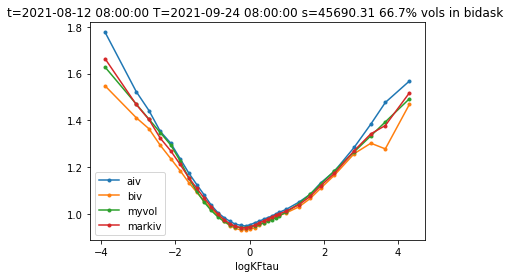

T=2021-09-24 08:00:00 t=2021-08-12 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03630615  0.10492569  0.03106897  0.15164572 -0.18187854]


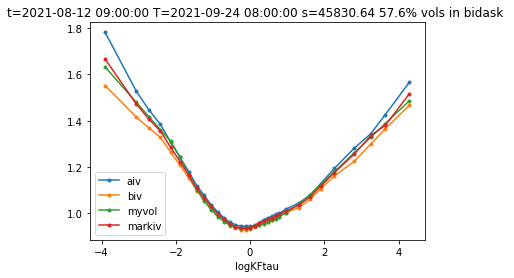

T=2021-09-24 08:00:00 t=2021-08-12 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0386563   0.10573593  0.03092829  0.1505392  -0.1880997 ]


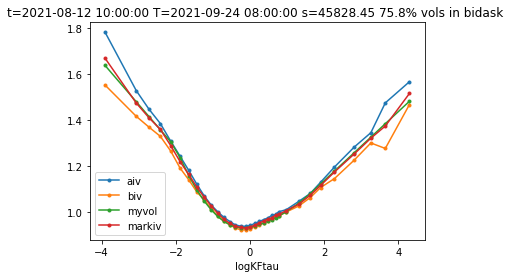

T=2021-09-24 08:00:00 t=2021-08-12 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04050266  0.10531251  0.02832409  0.15396615 -0.1909541 ]


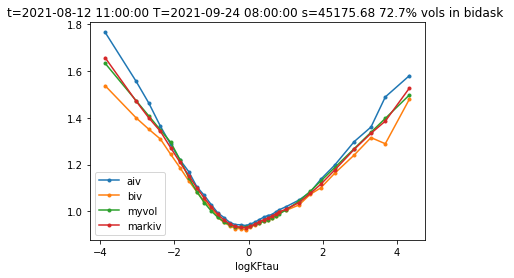

T=2021-09-24 08:00:00 t=2021-08-12 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03569025  0.10770601  0.03056113  0.15065392 -0.18514877]


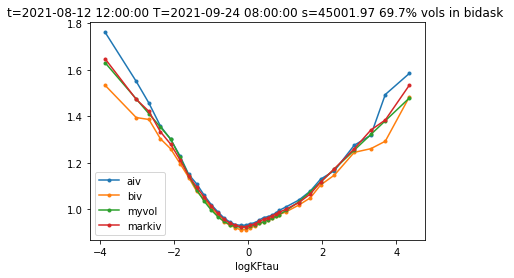

T=2021-09-24 08:00:00 t=2021-08-12 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03738994  0.10986288  0.03148358  0.14967422 -0.19266381]


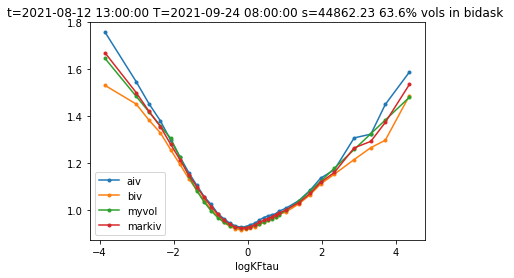

T=2021-09-24 08:00:00 t=2021-08-12 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03480453  0.10792064  0.03463955  0.14888253 -0.21027389]


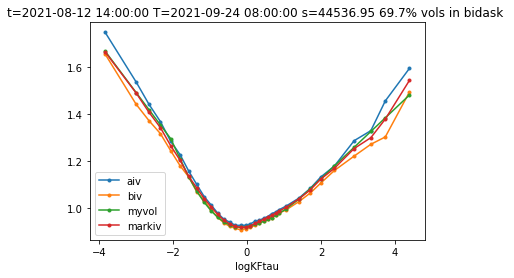

T=2021-09-24 08:00:00 t=2021-08-12 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03411153  0.11020652  0.03859918  0.14538417 -0.18600498]


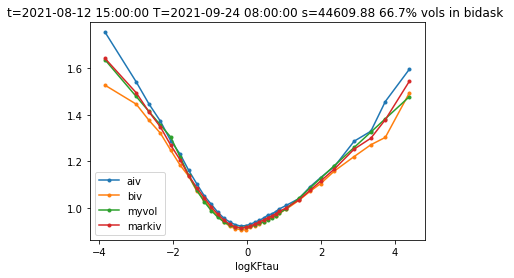

T=2021-09-24 08:00:00 t=2021-08-12 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03614518  0.11092693  0.03266382  0.14875748 -0.18586212]


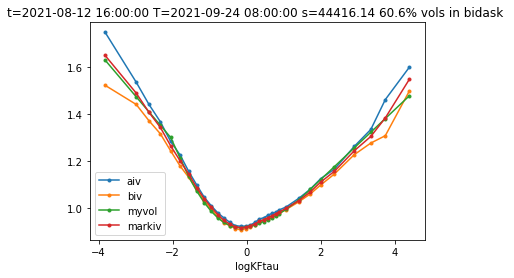

T=2021-09-24 08:00:00 t=2021-08-12 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03739601  0.11130789  0.03176781  0.15327425 -0.19132741]


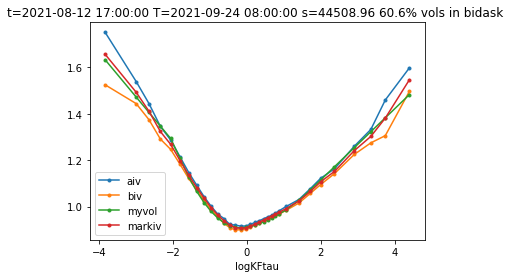

T=2021-09-24 08:00:00 t=2021-08-12 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03508175  0.10924641  0.03533475  0.14846884 -0.17399422]


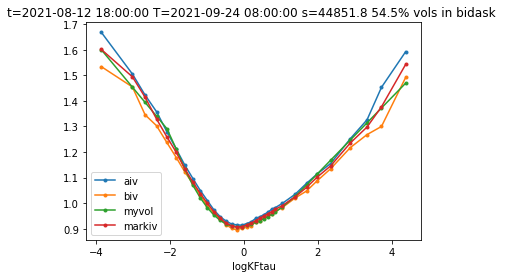

T=2021-09-24 08:00:00 t=2021-08-12 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03771697  0.11014314  0.03255753  0.15097881 -0.1638639 ]


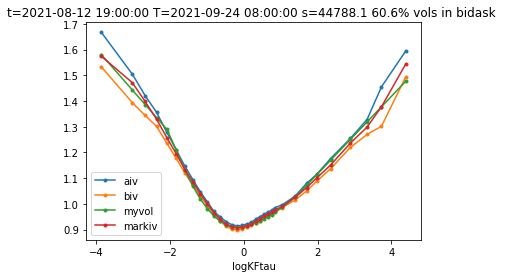

T=2021-09-24 08:00:00 t=2021-08-12 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.035257    0.10937313  0.03375044  0.14844128 -0.16313405]


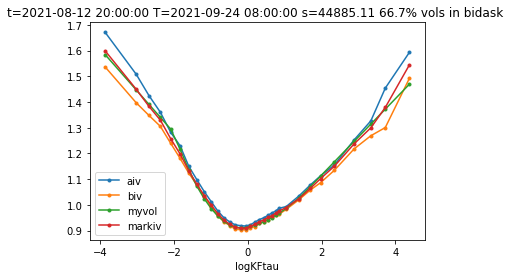

T=2021-09-24 08:00:00 t=2021-08-12 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03409944  0.10904961  0.03535753  0.15403194 -0.15971612]


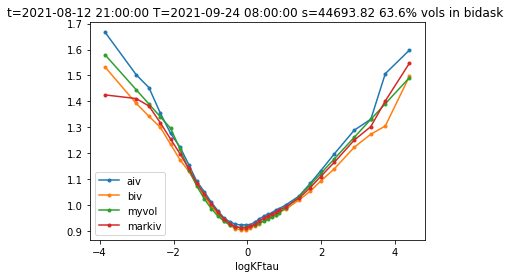

T=2021-09-24 08:00:00 t=2021-08-12 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03841173  0.10995873  0.03066685  0.15765078 -0.16701243]


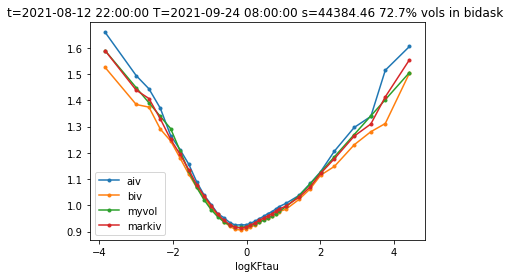

T=2021-09-24 08:00:00 t=2021-08-12 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03873407  0.11068158  0.03327602  0.15469279 -0.16773325]


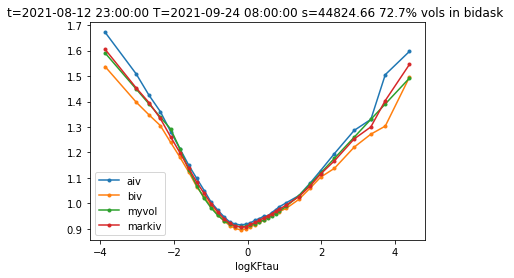

T=2021-09-24 08:00:00 t=2021-08-13 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03647548  0.1131668   0.03840874  0.15591464 -0.16571156]


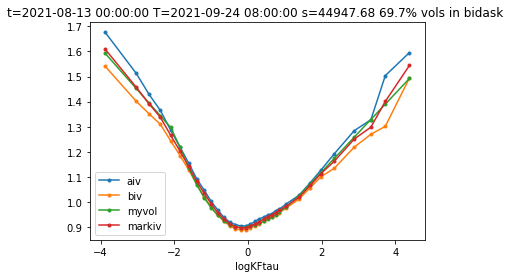

T=2021-09-24 08:00:00 t=2021-08-13 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04414405  0.11592797  0.03135864  0.16086413 -0.17815129]


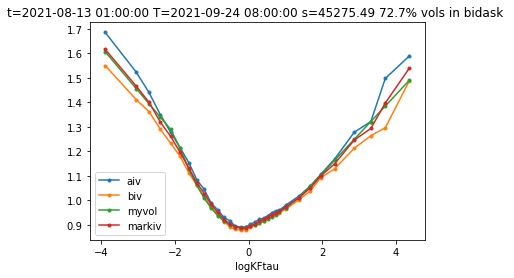

T=2021-09-24 08:00:00 t=2021-08-13 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05591682  0.12286423  0.02592523  0.16118849 -0.1912151 ]


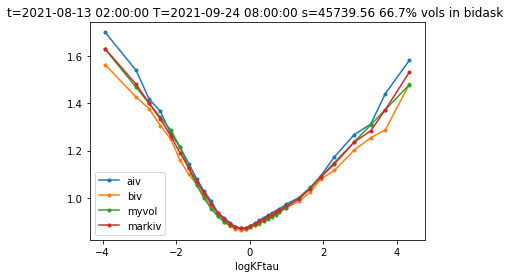

T=2021-09-24 08:00:00 t=2021-08-13 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05677945  0.12380763  0.0262205   0.16277504 -0.1828462 ]


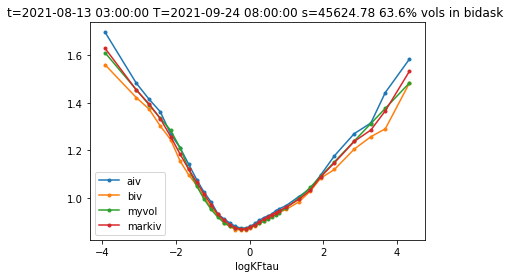

T=2021-09-24 08:00:00 t=2021-08-13 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05782228  0.12397241  0.02501743  0.15544605 -0.16484909]


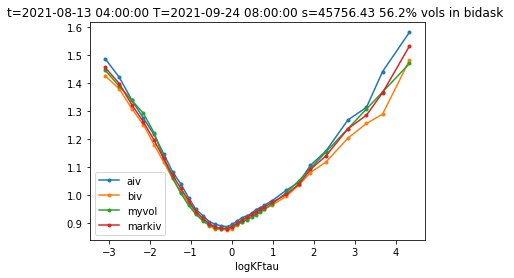

T=2021-09-24 08:00:00 t=2021-08-13 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05360481  0.12030142  0.02929506  0.16068239 -0.16399909]


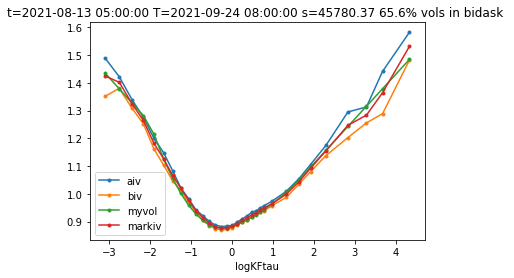

T=2021-09-24 08:00:00 t=2021-08-13 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04803554  0.11708169  0.03085115  0.15946774 -0.17414462]


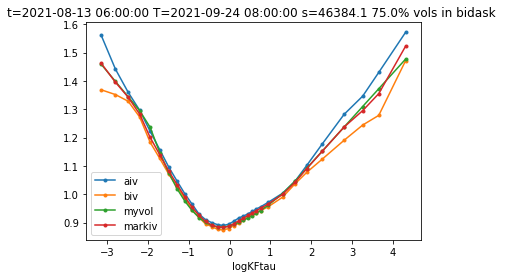

T=2021-09-24 08:00:00 t=2021-08-13 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04922575  0.11393512  0.02564082  0.16481825 -0.18115026]


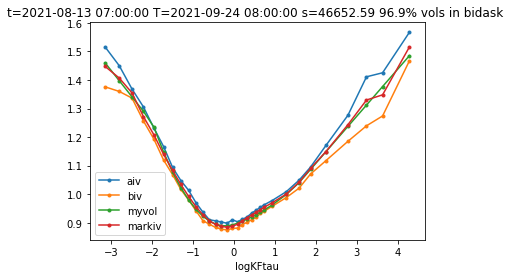

T=2021-09-24 08:00:00 t=2021-08-13 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05539318  0.12067003  0.02496933  0.15817107 -0.17416738]


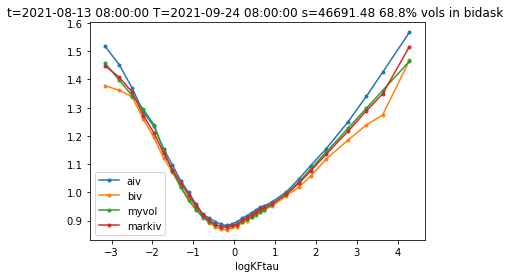

T=2021-09-24 08:00:00 t=2021-08-13 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0531995   0.11937644  0.02720567  0.15715287 -0.1786482 ]


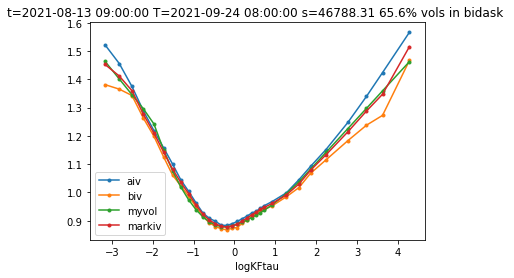

T=2021-09-24 08:00:00 t=2021-08-13 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05218815  0.11736564  0.026718    0.15702137 -0.18622234]


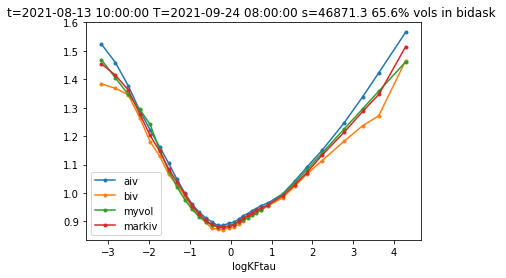

T=2021-09-24 08:00:00 t=2021-08-13 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05097935  0.11453236  0.02673722  0.15925123 -0.18689545]


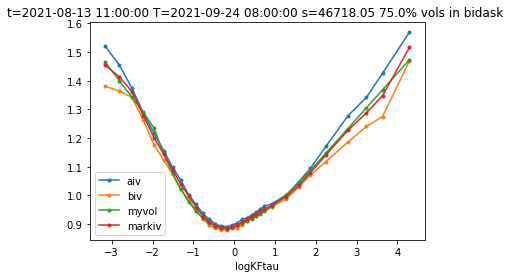

T=2021-09-24 08:00:00 t=2021-08-13 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05228865  0.11611767  0.02193668  0.15955967 -0.19340699]


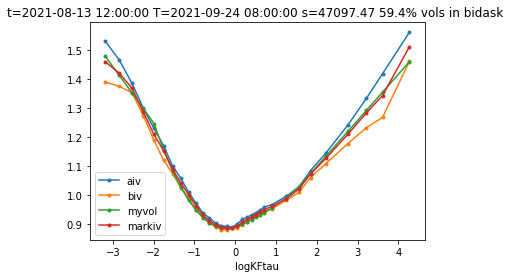

T=2021-09-24 08:00:00 t=2021-08-13 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05158644  0.11402431  0.02244502  0.15938719 -0.19589042]


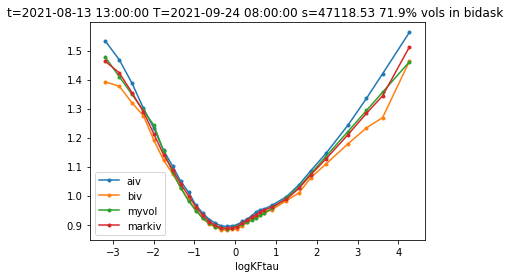

T=2021-09-24 08:00:00 t=2021-08-13 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05878907  0.1165512   0.01659013  0.15747767 -0.17619895]


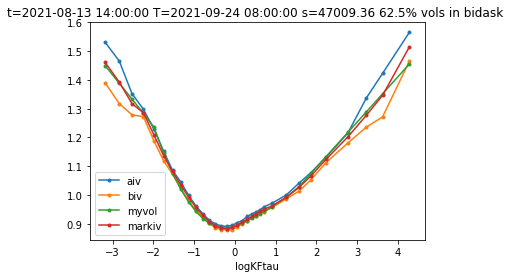

T=2021-09-24 08:00:00 t=2021-08-13 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05200654  0.11407664  0.02019612  0.16061547 -0.15127817]


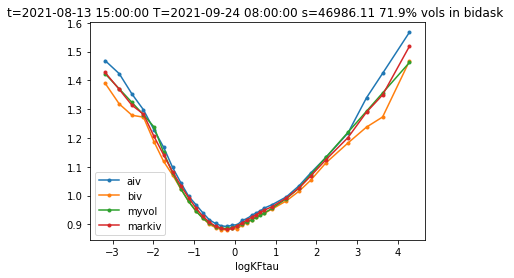

T=2021-09-24 08:00:00 t=2021-08-13 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05380716  0.11253473  0.02384328  0.15955284 -0.15555192]


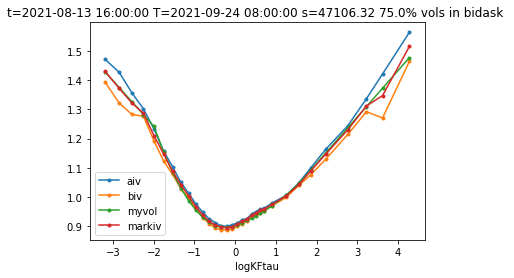

T=2021-09-24 08:00:00 t=2021-08-13 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06520903  0.11865561  0.01827746  0.15831894 -0.1574783 ]


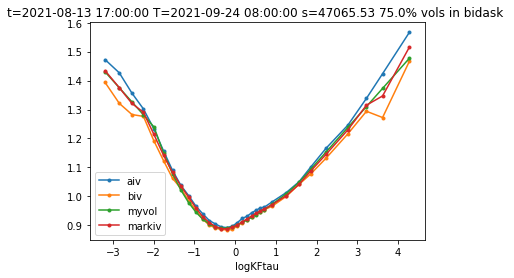

T=2021-09-24 08:00:00 t=2021-08-13 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0648682   0.11905717  0.01666867  0.15967219 -0.15682964]


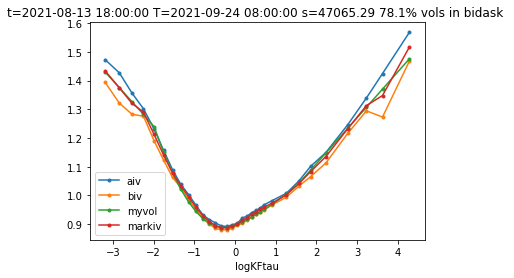

T=2021-09-24 08:00:00 t=2021-08-13 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06649968  0.12139394  0.01632176  0.15363701 -0.15101709]


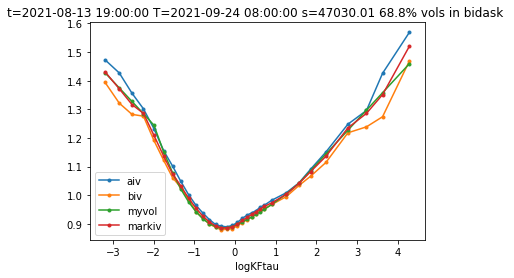

T=2021-09-24 08:00:00 t=2021-08-13 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06207052  0.11328234  0.01977698  0.14898118 -0.15752607]


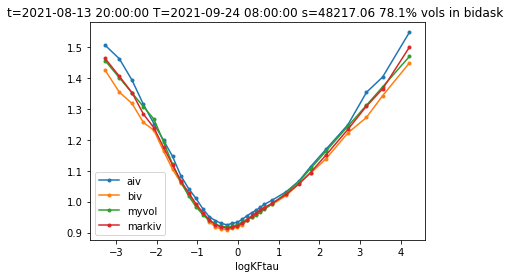

T=2021-09-24 08:00:00 t=2021-08-13 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06378675  0.10935176  0.01470746  0.15823804 -0.16756776]


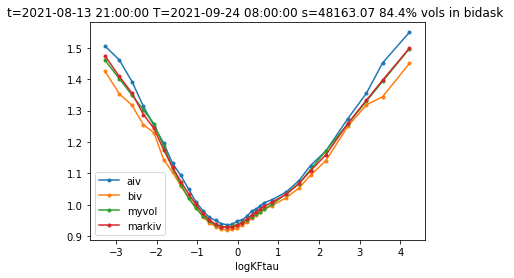

T=2021-09-24 08:00:00 t=2021-08-13 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06293089  0.11081041  0.01361161  0.15415333 -0.17342046]


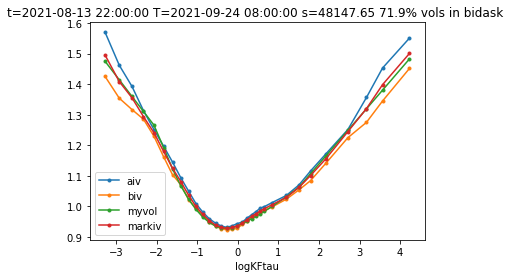

T=2021-09-24 08:00:00 t=2021-08-13 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06346688  0.11241707  0.01290211  0.15309097 -0.17594678]


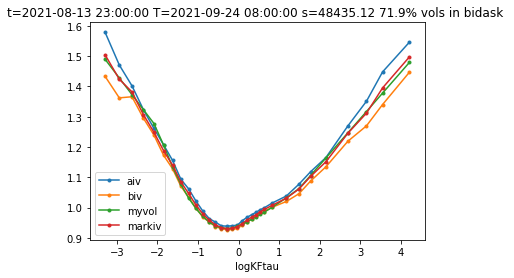

T=2021-09-24 08:00:00 t=2021-08-14 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06912767  0.11869386  0.01457265  0.15398398 -0.16102534]


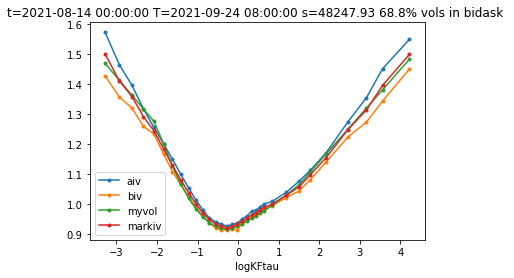

T=2021-09-24 08:00:00 t=2021-08-14 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.07138533  0.12169263  0.01000367  0.14779123 -0.1835539 ]


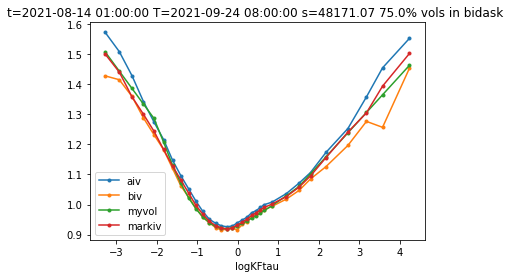

T=2021-09-24 08:00:00 t=2021-08-14 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06434659  0.11784489  0.01705952  0.15324984 -0.22935445]


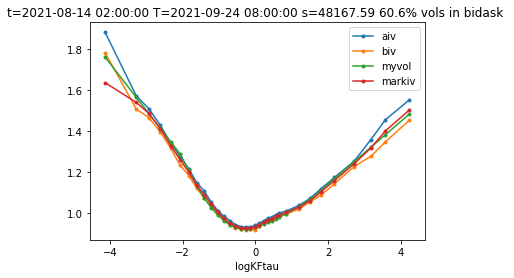

T=2021-09-24 08:00:00 t=2021-08-14 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06464868  0.11861342  0.01762141  0.15509254 -0.20530986]


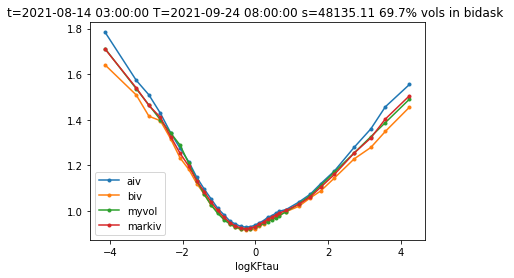

T=2021-09-24 08:00:00 t=2021-08-14 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06217219  0.11718816  0.01838009  0.15726296 -0.17167706]


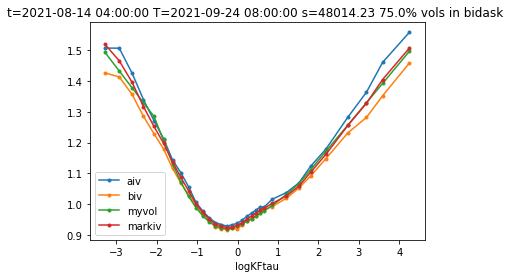

T=2021-09-24 08:00:00 t=2021-08-14 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05824696  0.11653637  0.01975404  0.15755172 -0.17173273]


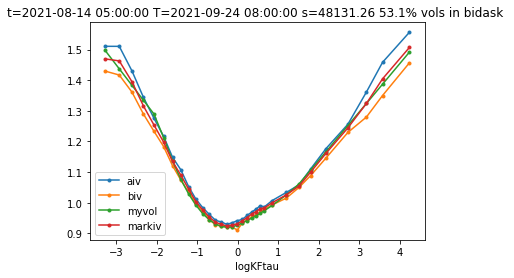

T=2021-09-24 08:00:00 t=2021-08-14 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05950937  0.1186679   0.0205117   0.15815463 -0.18246991]


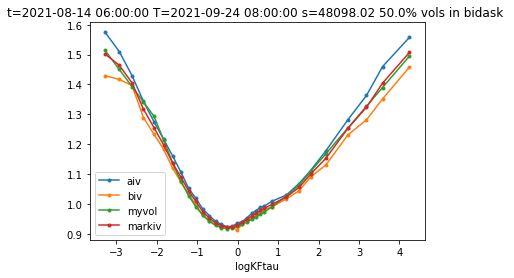

T=2021-09-24 08:00:00 t=2021-08-14 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0574657   0.1159253   0.02172492  0.15237203 -0.18046229]


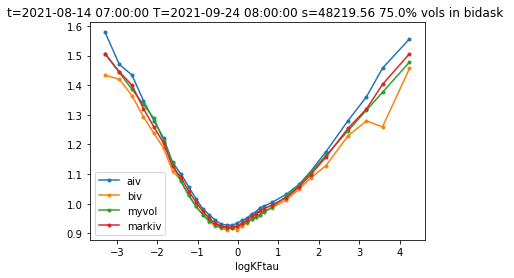

T=2021-09-24 08:00:00 t=2021-08-14 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05921755  0.11914484  0.01772329  0.16134956 -0.18350429]


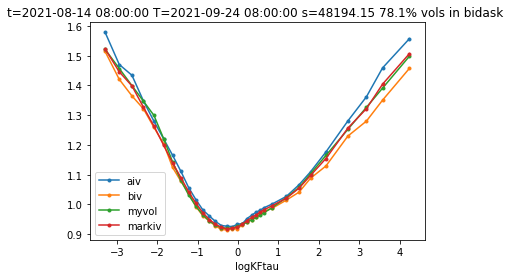

T=2021-09-24 08:00:00 t=2021-08-14 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.06046059  0.11583336  0.01591877  0.1667646  -0.17435988]


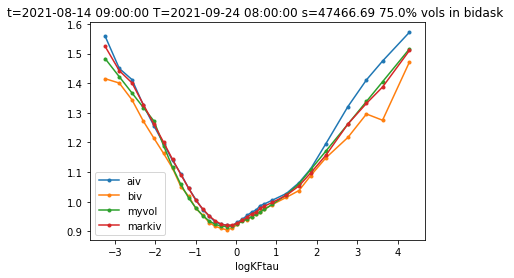

T=2021-09-24 08:00:00 t=2021-08-14 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05622151  0.11327249  0.01679045  0.1566359  -0.18140861]


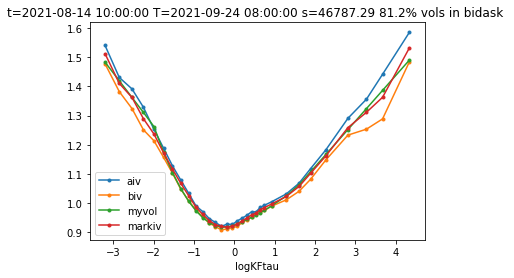

T=2021-09-24 08:00:00 t=2021-08-14 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05092281  0.10953697  0.02106009  0.15973314 -0.19333857]


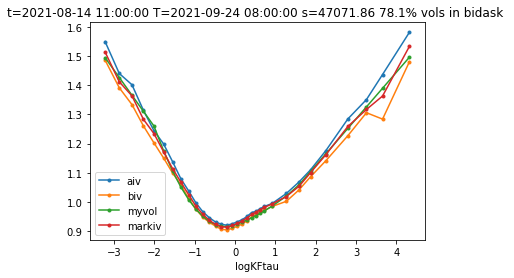

T=2021-09-24 08:00:00 t=2021-08-14 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05874987  0.11390807  0.01833699  0.15660369 -0.19521614]


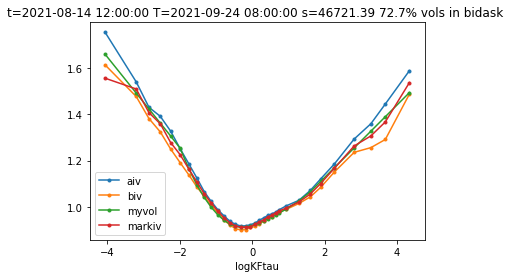

T=2021-09-24 08:00:00 t=2021-08-14 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05010457  0.10830225  0.02304564  0.15477976 -0.19220299]


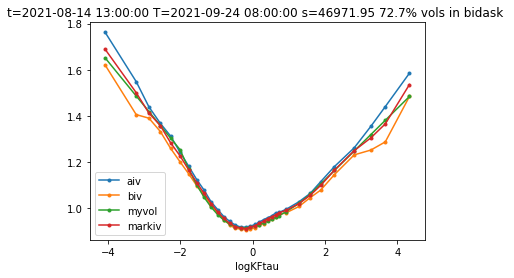

T=2021-09-24 08:00:00 t=2021-08-14 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05268905  0.11327262  0.02168397  0.15917409 -0.18722087]


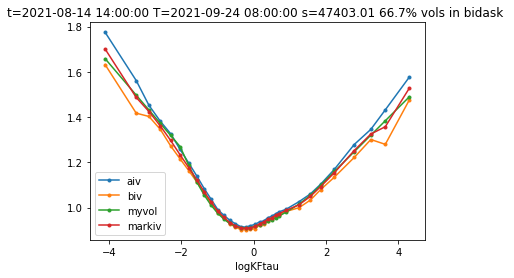

T=2021-09-24 08:00:00 t=2021-08-14 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05447264  0.11286741  0.01812598  0.1625349  -0.19228067]


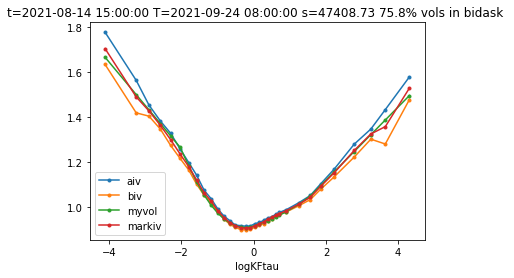

T=2021-09-24 08:00:00 t=2021-08-14 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05159185  0.11155221  0.02065058  0.16365589 -0.18166535]


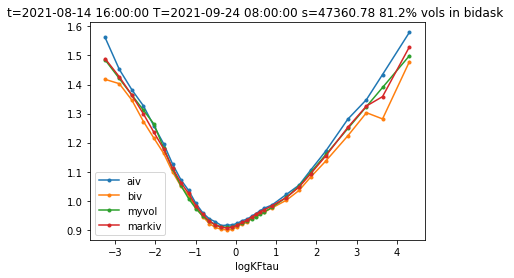

T=2021-09-24 08:00:00 t=2021-08-14 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05497953  0.11419562  0.01752275  0.16471621 -0.17779422]


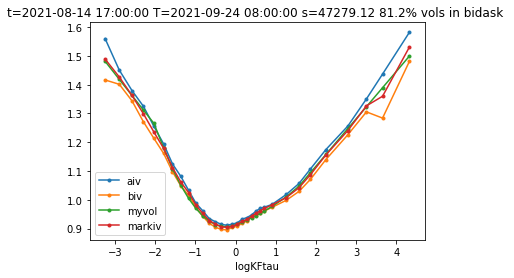

T=2021-09-24 08:00:00 t=2021-08-14 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05302899  0.11275393  0.02069487  0.15887372 -0.17940884]


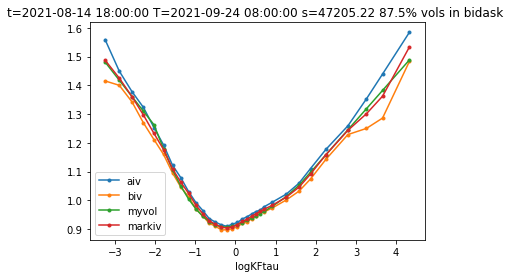

T=2021-09-24 08:00:00 t=2021-08-14 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05666763  0.11753871  0.01865637  0.16369656 -0.16004327]


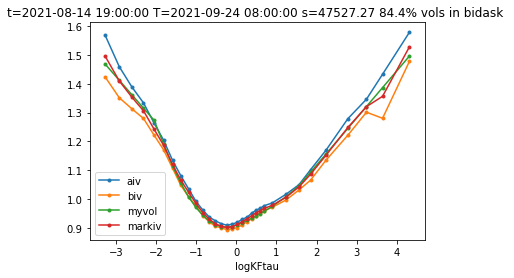

T=2021-09-24 08:00:00 t=2021-08-14 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04738167  0.11240977  0.02505602  0.16046549 -0.15575831]


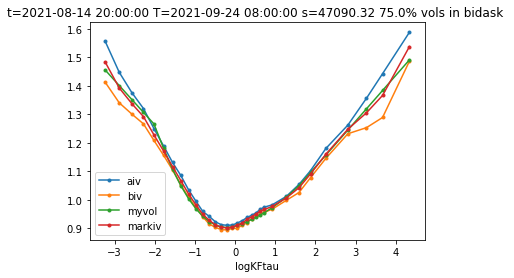

T=2021-09-24 08:00:00 t=2021-08-14 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05352139  0.11579945  0.02030355  0.16181185 -0.16091217]


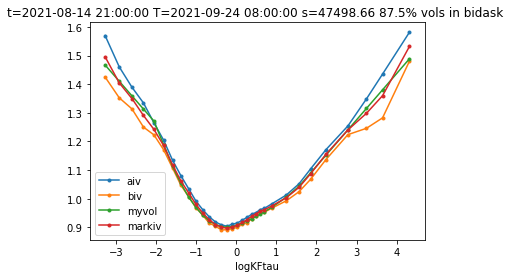

T=2021-09-24 08:00:00 t=2021-08-14 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05445905  0.11548173  0.0200476   0.16532825 -0.16453094]


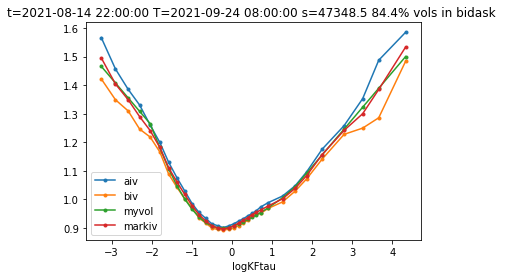

T=2021-09-24 08:00:00 t=2021-08-14 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05306846  0.11602374  0.02002262  0.16458859 -0.15173929]


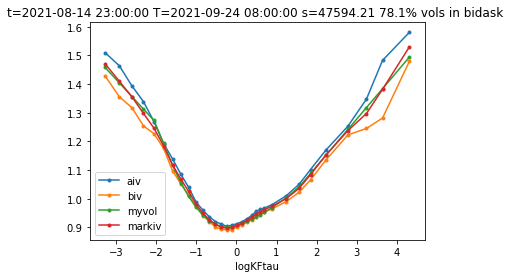

T=2021-09-24 08:00:00 t=2021-08-15 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04827694  0.11265582  0.02402521  0.1686424  -0.18694084]


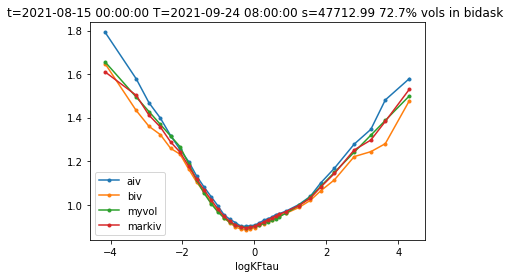

T=2021-09-24 08:00:00 t=2021-08-15 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04997713  0.11106135  0.02441597  0.16647473 -0.19706181]


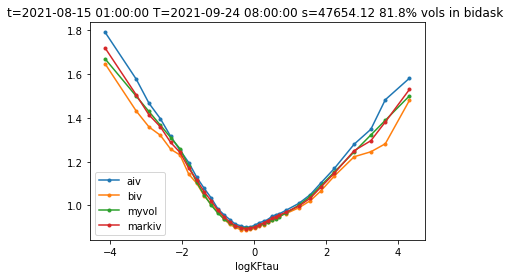

T=2021-09-24 08:00:00 t=2021-08-15 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04987723  0.11144805  0.02374891  0.16678919 -0.19592364]


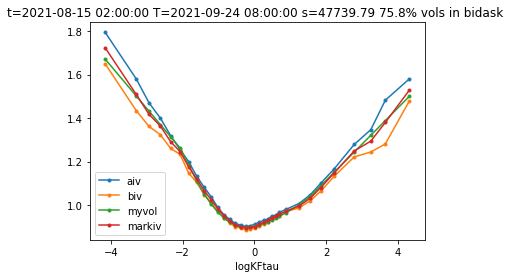

T=2021-09-24 08:00:00 t=2021-08-15 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0543569   0.11582113  0.02178204  0.17031421 -0.18864633]


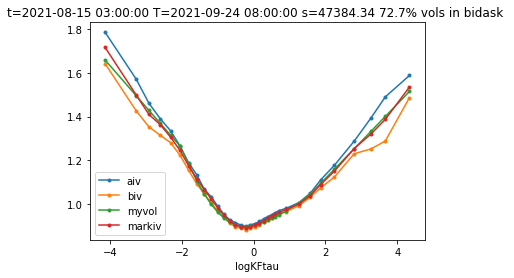

T=2021-09-24 08:00:00 t=2021-08-15 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05303978  0.11615811  0.02239391  0.17507336 -0.18045858]


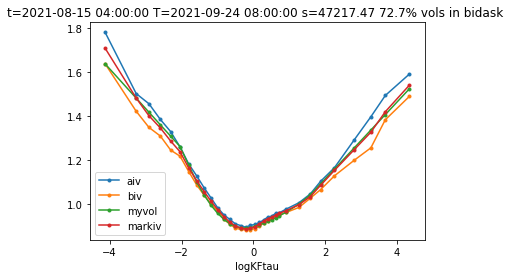

T=2021-09-24 08:00:00 t=2021-08-15 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05408764  0.11807162  0.02294583  0.17518426 -0.18751277]


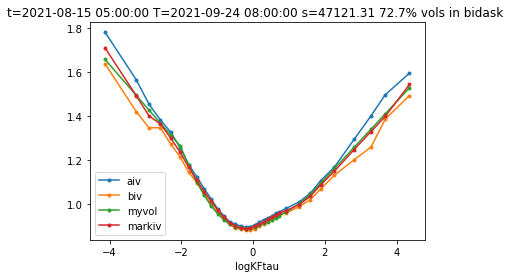

T=2021-09-24 08:00:00 t=2021-08-15 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05276072  0.11707254  0.02494768  0.17548054 -0.18651897]


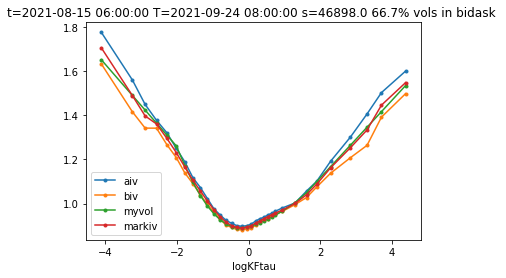

T=2021-09-24 08:00:00 t=2021-08-15 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04311221  0.10699741  0.02961285  0.17306982 -0.19577766]


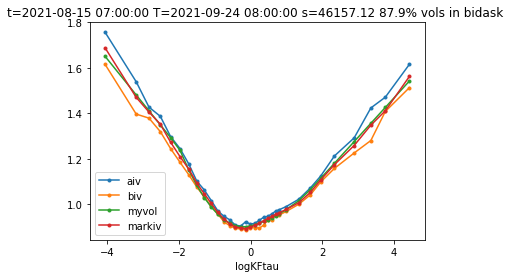

T=2021-09-24 08:00:00 t=2021-08-15 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05080238  0.11175345  0.02636749  0.17007899 -0.1932609 ]


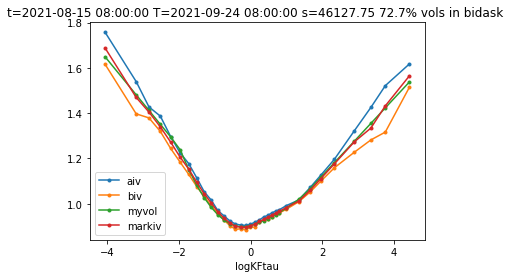

T=2021-09-24 08:00:00 t=2021-08-15 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05148193  0.11264572  0.026293    0.17384742 -0.1787538 ]


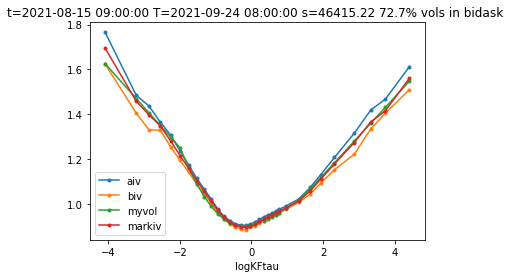

T=2021-09-24 08:00:00 t=2021-08-15 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0332311   0.10306753  0.03667666  0.16249377 -0.19460316]


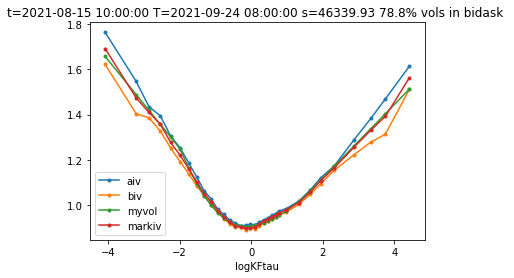

T=2021-09-24 08:00:00 t=2021-08-15 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03659276  0.10634589  0.03590495  0.16154817 -0.18002791]


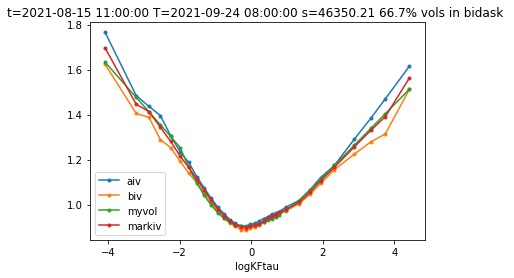

T=2021-09-24 08:00:00 t=2021-08-15 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04257222  0.11194845  0.0357992   0.15994931 -0.17348385]


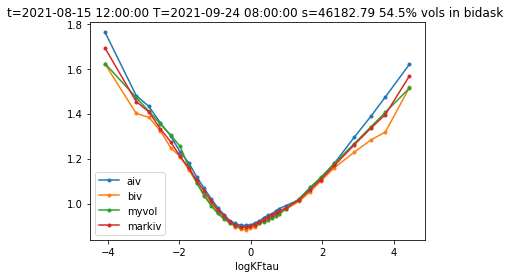

T=2021-09-24 08:00:00 t=2021-08-15 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03455236  0.10548815  0.03870533  0.16143867 -0.17634835]


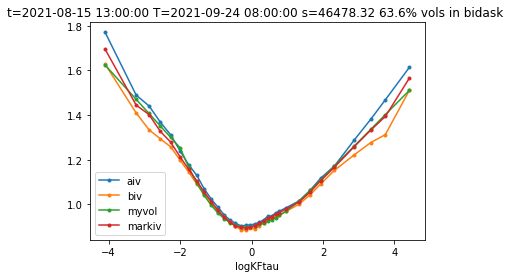

T=2021-09-24 08:00:00 t=2021-08-15 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03857401  0.1106058   0.03318622  0.16179468 -0.18754114]


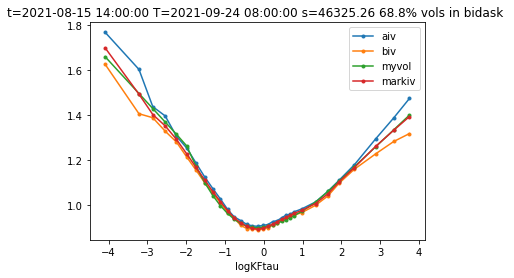

T=2021-09-24 08:00:00 t=2021-08-15 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03627491  0.11238945  0.03587621  0.16117971 -0.19401433]


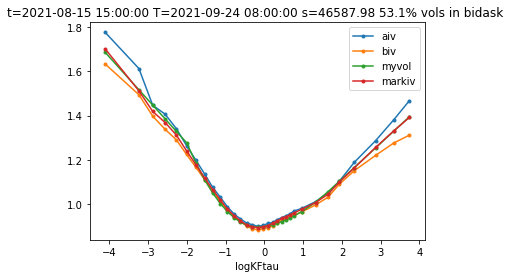

T=2021-09-24 08:00:00 t=2021-08-15 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03600656  0.11101146  0.03762863  0.16072661 -0.19735972]


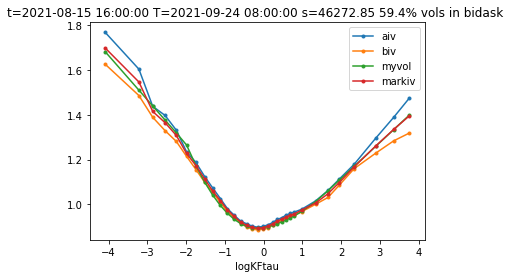

T=2021-09-24 08:00:00 t=2021-08-15 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.036271    0.111914    0.03549378  0.16298924 -0.19685314]


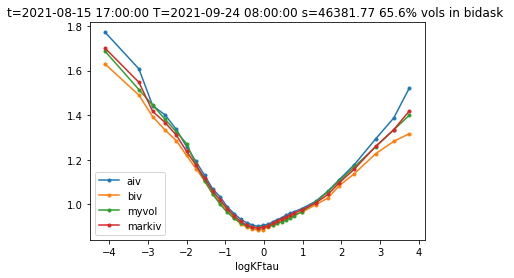

T=2021-09-24 08:00:00 t=2021-08-15 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04108496  0.11414565  0.03068615  0.1639672  -0.19095314]


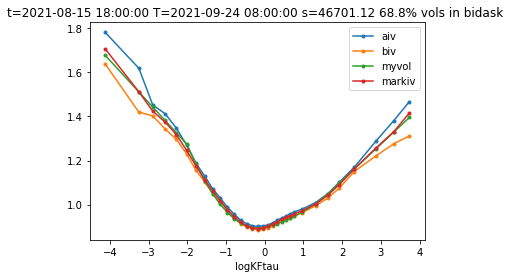

T=2021-09-24 08:00:00 t=2021-08-15 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04059641  0.11295294  0.02821065  0.1661997  -0.18570046]


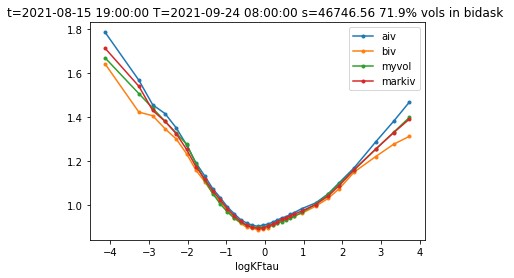

T=2021-09-24 08:00:00 t=2021-08-15 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04441008  0.1164391   0.02427441  0.16444223 -0.18608903]


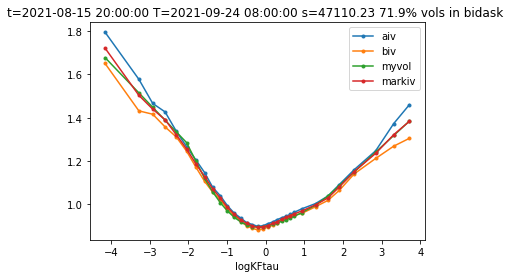

T=2021-09-24 08:00:00 t=2021-08-15 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04710055  0.115865    0.02337089  0.16227936 -0.19036955]


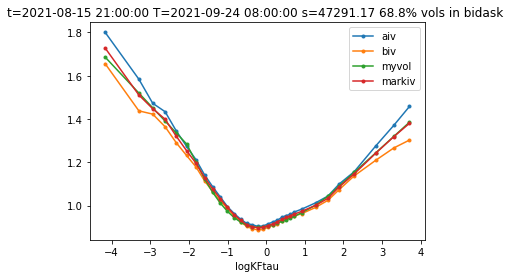

T=2021-09-24 08:00:00 t=2021-08-15 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04759154  0.11570706  0.02550309  0.15842048 -0.19624914]


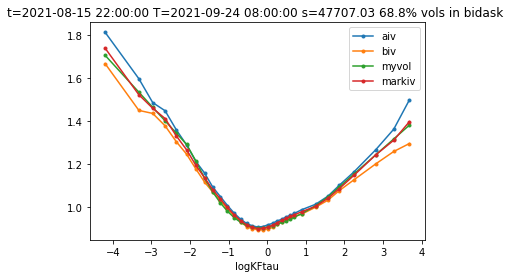

T=2021-09-24 08:00:00 t=2021-08-15 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04865448  0.11639779  0.02062344  0.16260169 -0.19017079]


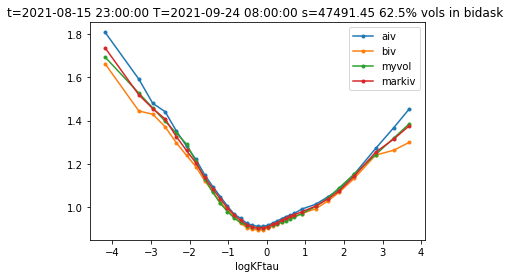

T=2021-09-24 08:00:00 t=2021-08-16 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0448555   0.11617364  0.02718445  0.15872759 -0.19236122]


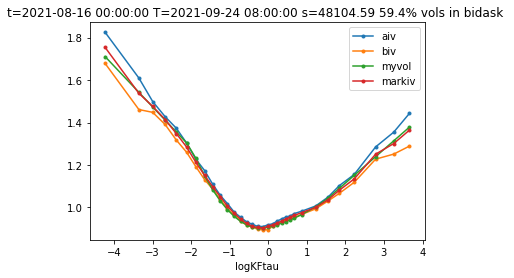

T=2021-09-24 08:00:00 t=2021-08-16 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04998205  0.11959531  0.02414579  0.16763478 -0.19244438]


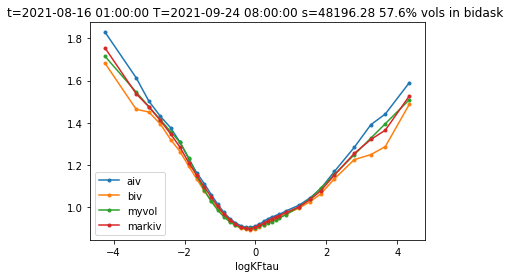

T=2021-09-24 08:00:00 t=2021-08-16 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04257059  0.11586494  0.02808983  0.16908893 -0.18579583]


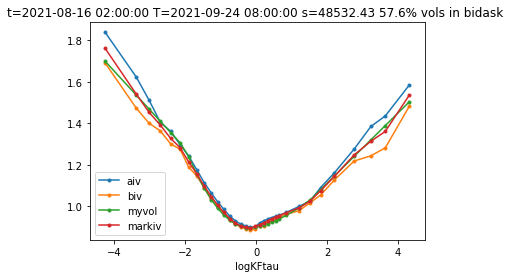

T=2021-09-24 08:00:00 t=2021-08-16 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04913113  0.11628631  0.02452746  0.16852031 -0.17908355]


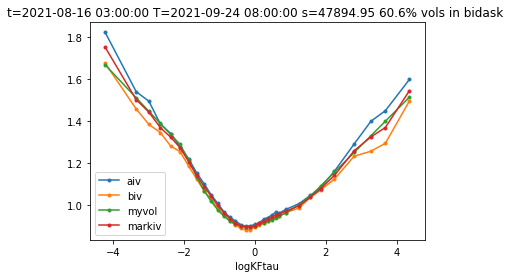

T=2021-09-24 08:00:00 t=2021-08-16 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04405667  0.11312011  0.0297717   0.16482364 -0.19006044]


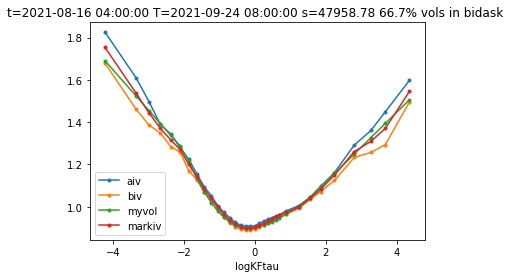

T=2021-09-24 08:00:00 t=2021-08-16 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.05001684  0.1193827   0.02351046  0.1676899  -0.15347494]


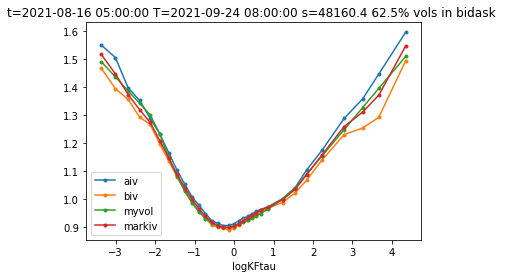

T=2021-09-24 08:00:00 t=2021-08-16 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04538645  0.11541272  0.02583659  0.16841979 -0.15516184]


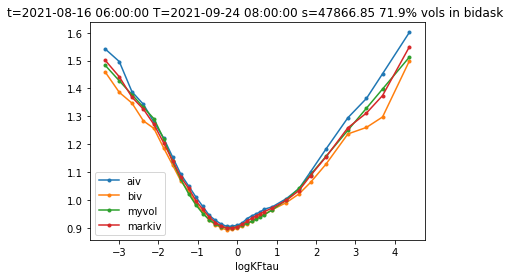

T=2021-09-24 08:00:00 t=2021-08-16 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04474913  0.11652084  0.02646734  0.16257638 -0.14165731]


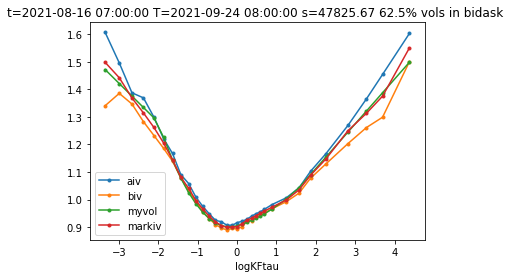

T=2021-09-24 08:00:00 t=2021-08-16 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04628732  0.11418744  0.02541612  0.16453319 -0.16855989]


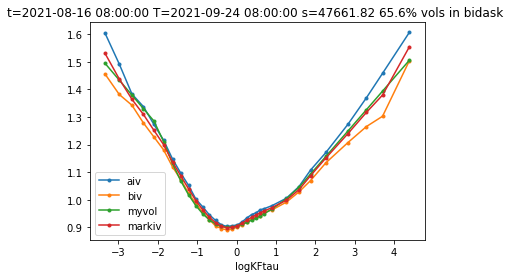

T=2021-09-24 08:00:00 t=2021-08-16 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04394235  0.11350045  0.0258961   0.16655661 -0.17131451]


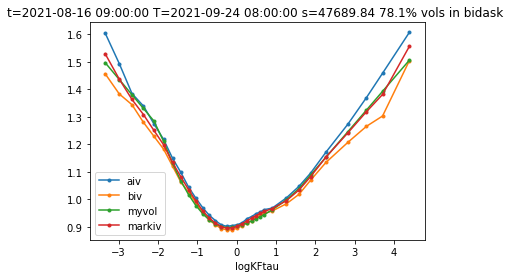

T=2021-09-24 08:00:00 t=2021-08-16 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04542846  0.11300432  0.02382666  0.16759008 -0.17951385]


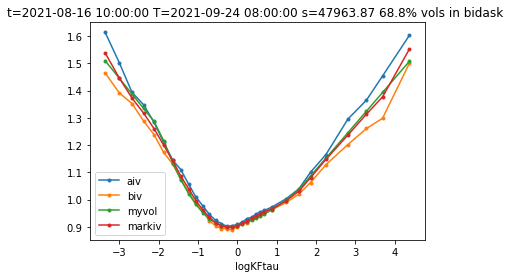

T=2021-09-24 08:00:00 t=2021-08-16 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03976243  0.11076674  0.02680223  0.16465124 -0.17976605]


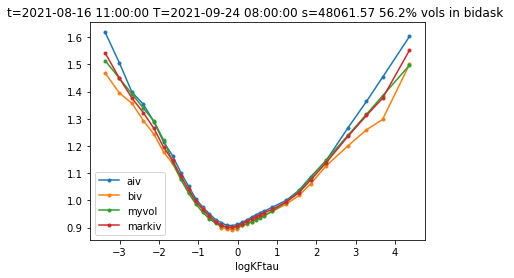

T=2021-09-24 08:00:00 t=2021-08-16 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03189988  0.10709636  0.02888371  0.1654202  -0.17045004]


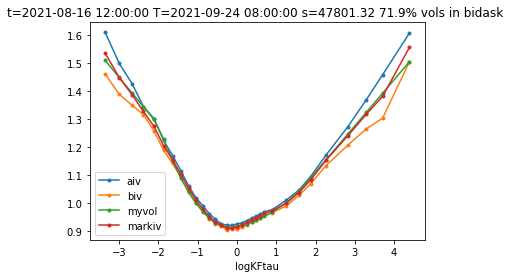

T=2021-09-24 08:00:00 t=2021-08-16 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03974735  0.11024637  0.01967297  0.16217735 -0.1753858 ]


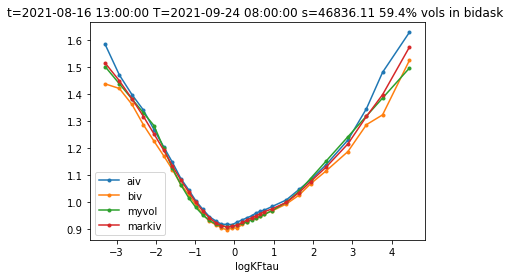

T=2021-09-24 08:00:00 t=2021-08-16 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03653792  0.10970093  0.02391887  0.16334893 -0.17342476]


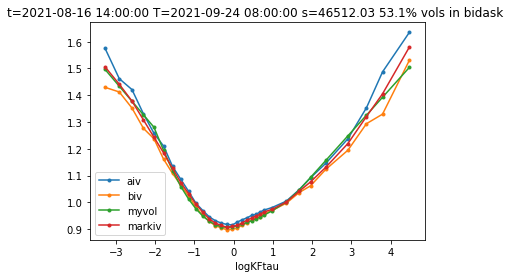

T=2021-09-24 08:00:00 t=2021-08-16 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0290111   0.10441802  0.02676406  0.16529136 -0.1691557 ]


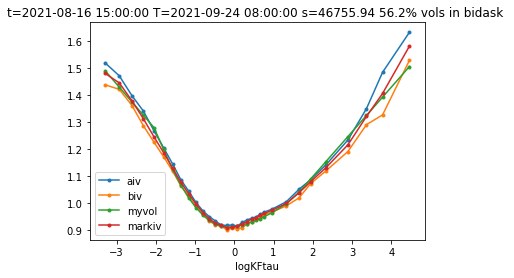

T=2021-09-24 08:00:00 t=2021-08-16 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03712017  0.10834952  0.02523086  0.1648158  -0.17180267]


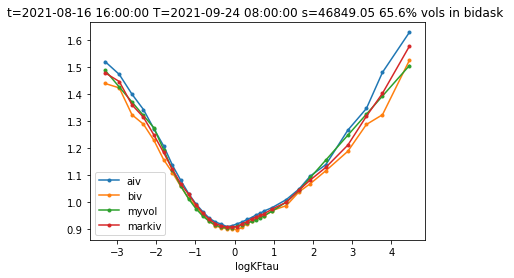

T=2021-09-24 08:00:00 t=2021-08-16 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0362094   0.10522001  0.02461703  0.16225216 -0.18238878]


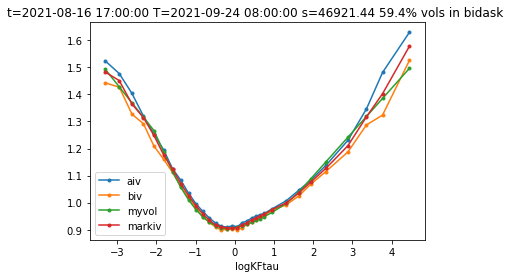

T=2021-09-24 08:00:00 t=2021-08-16 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03398123  0.10359138  0.02626837  0.16601539 -0.17306661]


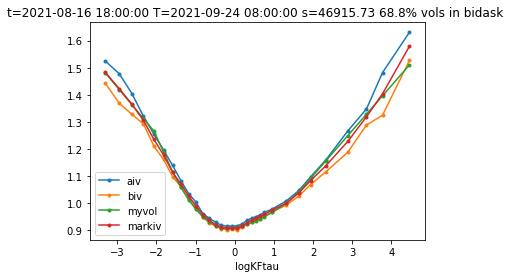

T=2021-09-24 08:00:00 t=2021-08-16 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03387886  0.10469041  0.02574507  0.16905275 -0.16451826]


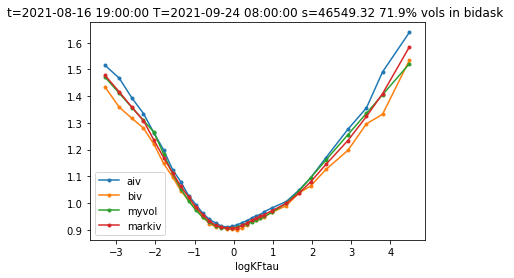

T=2021-09-24 08:00:00 t=2021-08-16 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03980552  0.10871824  0.02291124  0.16898852 -0.1639527 ]


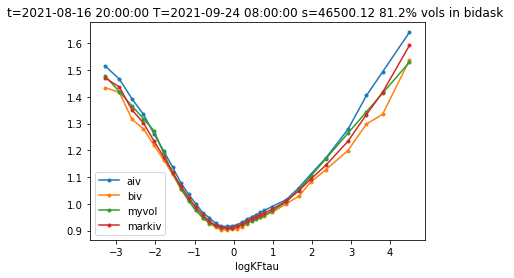

T=2021-09-24 08:00:00 t=2021-08-16 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03982465  0.10638922  0.02238906  0.16976287 -0.17427999]


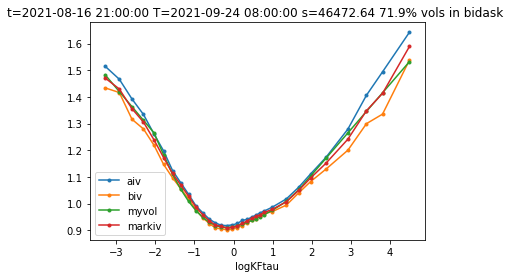

T=2021-09-24 08:00:00 t=2021-08-16 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03720908  0.10629165  0.02432087  0.17053021 -0.16199507]


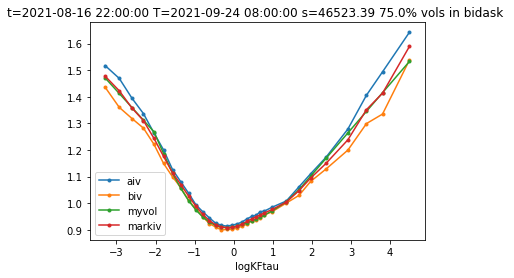

T=2021-09-24 08:00:00 t=2021-08-16 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03677864  0.10574926  0.02543576  0.17112303 -0.16160155]


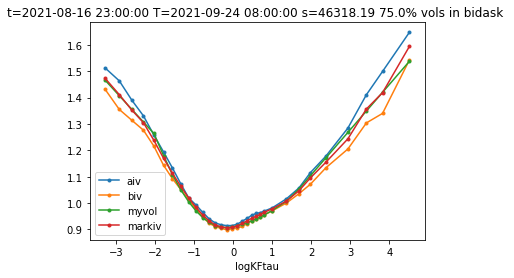

T=2021-09-24 08:00:00 t=2021-08-17 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04133353  0.10825361  0.02352855  0.1689282  -0.15907148]


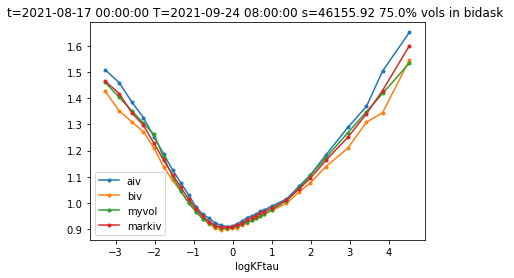

T=2021-09-24 08:00:00 t=2021-08-17 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03658562  0.10329918  0.02664142  0.16621005 -0.17682675]


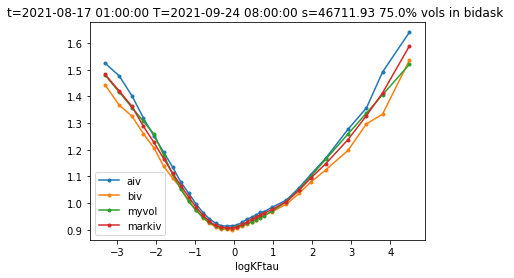

T=2021-09-24 08:00:00 t=2021-08-17 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03065625  0.09850389  0.03097679  0.16669013 -0.18559712]


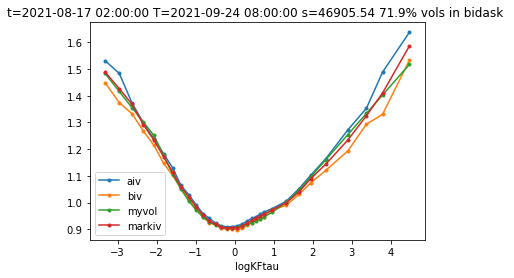

T=2021-09-24 08:00:00 t=2021-08-17 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0325721   0.10336043  0.03097359  0.16917046 -0.17006942]


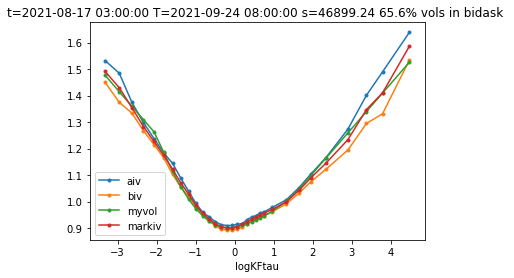

T=2021-09-24 08:00:00 t=2021-08-17 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0337082   0.10312822  0.02990426  0.16573585 -0.17240996]


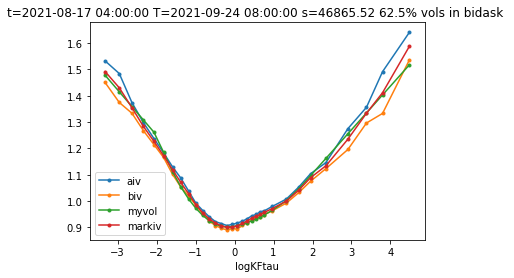

T=2021-09-24 08:00:00 t=2021-08-17 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03523831  0.1031155   0.03155351  0.17067186 -0.17294321]


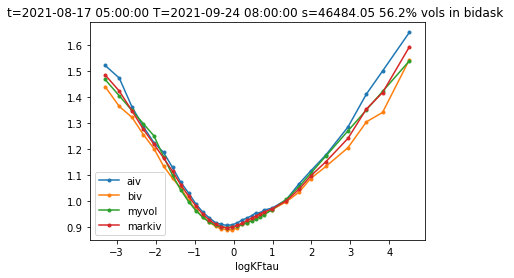

T=2021-09-24 08:00:00 t=2021-08-17 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03336985  0.10075355  0.03342397  0.17114088 -0.17306957]


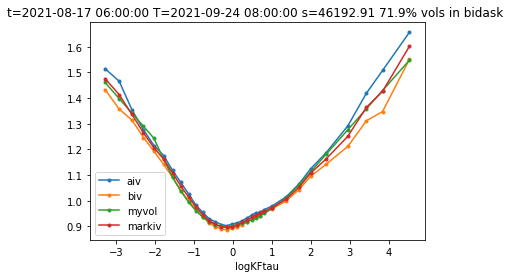

T=2021-09-24 08:00:00 t=2021-08-17 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03860201  0.10743457  0.02808877  0.17783178 -0.14428318]


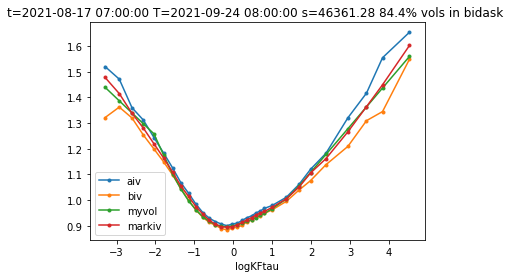

T=2021-09-24 08:00:00 t=2021-08-17 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03749578  0.10697644  0.03247084  0.17063462 -0.19122967]


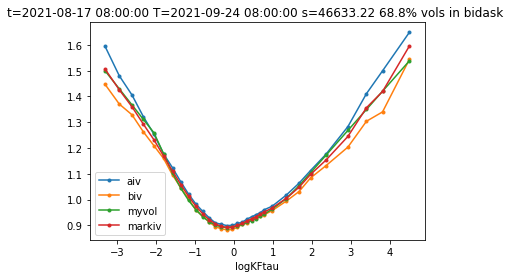

T=2021-09-24 08:00:00 t=2021-08-17 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03852468  0.10939324  0.0295141   0.16787688 -0.17713376]


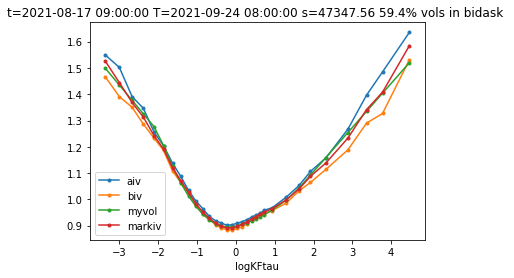

T=2021-09-24 08:00:00 t=2021-08-17 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.04207824  0.11004791  0.02774929  0.17174431 -0.18936746]


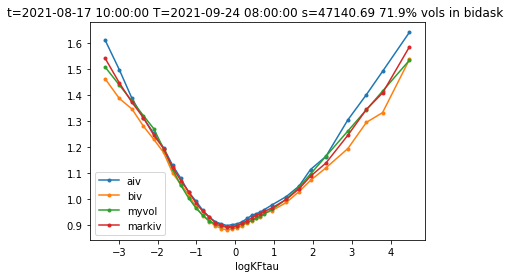

T=2021-09-24 08:00:00 t=2021-08-17 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03555753  0.10751864  0.03215083  0.16603871 -0.1914676 ]


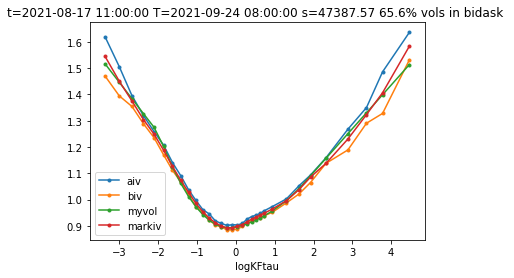

T=2021-09-24 08:00:00 t=2021-08-17 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03498406  0.10830686  0.03316387  0.16407872 -0.19382252]


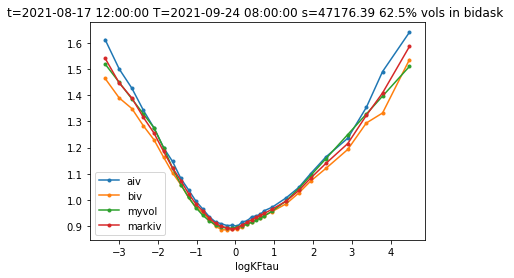

T=2021-09-24 08:00:00 t=2021-08-17 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03696313  0.10840472  0.0298739   0.1689835  -0.18857544]


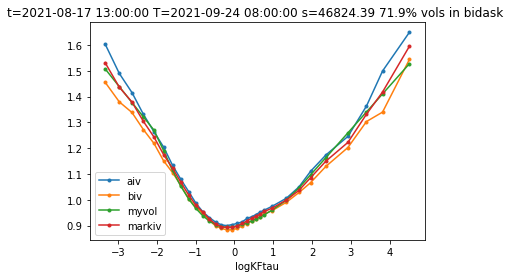

T=2021-09-24 08:00:00 t=2021-08-17 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03713513  0.1088276   0.02953103  0.17377239 -0.20004495]


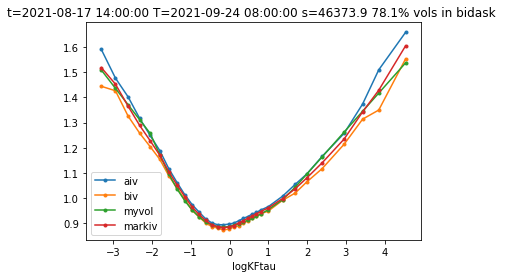

T=2021-09-24 08:00:00 t=2021-08-17 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03595282  0.10957853  0.03296358  0.17356111 -0.19093952]


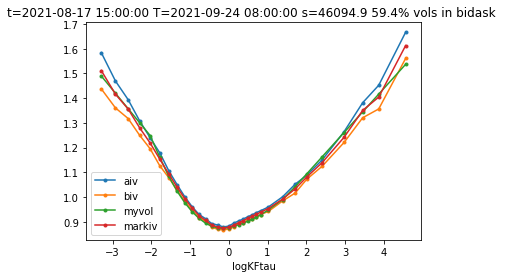

T=2021-09-24 08:00:00 t=2021-08-17 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03545777  0.10920652  0.03132135  0.1798611  -0.19094714]


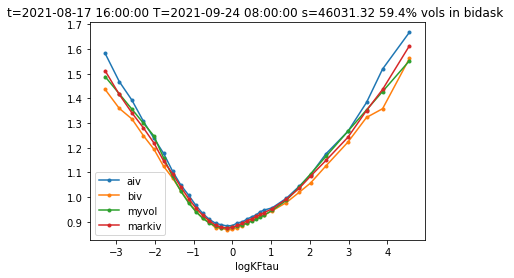

T=2021-09-24 08:00:00 t=2021-08-17 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03642434  0.11099269  0.03523814  0.17717156 -0.18979981]


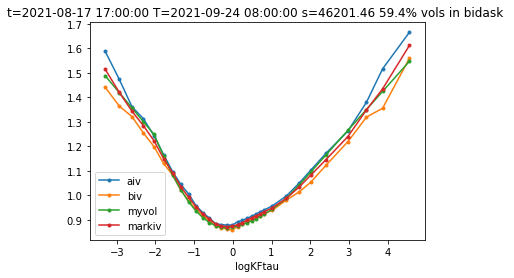

T=2021-09-24 08:00:00 t=2021-08-17 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03585847  0.1087555   0.03181413  0.17979098 -0.19107107]


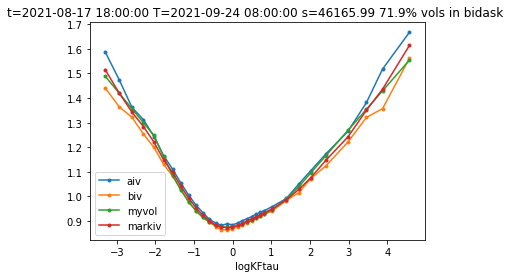

T=2021-09-24 08:00:00 t=2021-08-17 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03039123  0.10439297  0.03635614  0.1789245  -0.19814288]


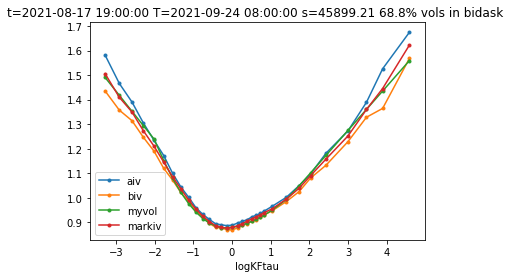

T=2021-09-24 08:00:00 t=2021-08-17 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.02950339  0.10169664  0.03259373  0.18026475 -0.18246773]


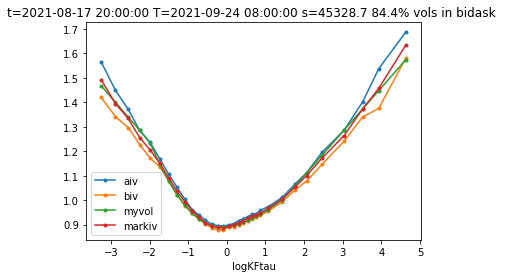

T=2021-09-24 08:00:00 t=2021-08-17 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03029861  0.10325546  0.0370455   0.17578151 -0.17886722]


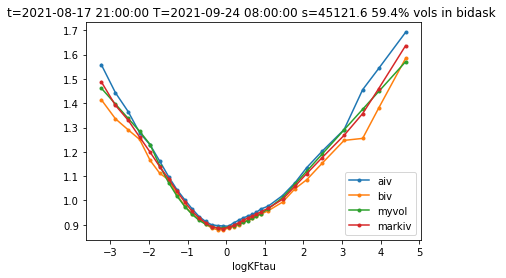

T=2021-09-24 08:00:00 t=2021-08-17 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03183596  0.10312694  0.03350659  0.17770494 -0.18544606]


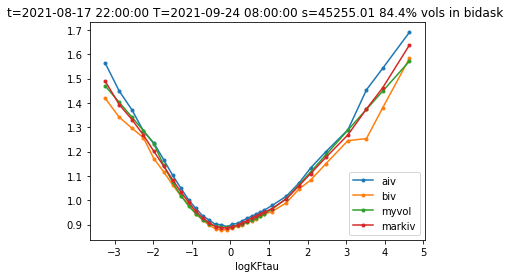

T=2021-09-24 08:00:00 t=2021-08-17 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03219592  0.10450886  0.03524498  0.17834003 -0.17617602]


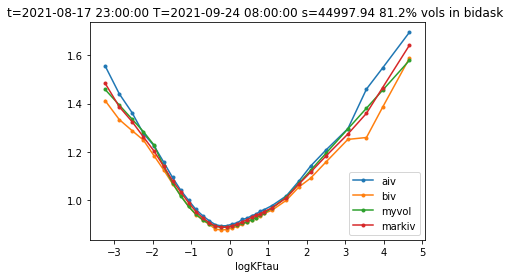

T=2021-09-24 08:00:00 t=2021-08-18 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0217821   0.10147805  0.0403828   0.1837537  -0.19323743]


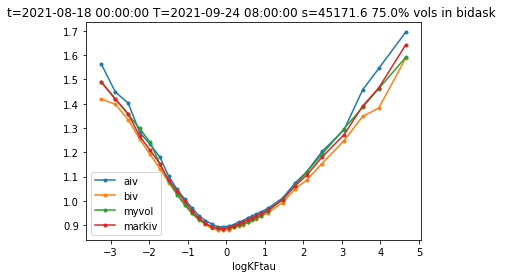

T=2021-09-24 08:00:00 t=2021-08-18 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0238321   0.1032188   0.03748335  0.18341544 -0.19402839]


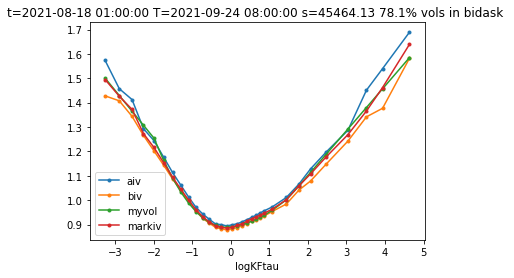

T=2021-09-24 08:00:00 t=2021-08-18 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0222626   0.10603167  0.04094935  0.16427566 -0.17274404]


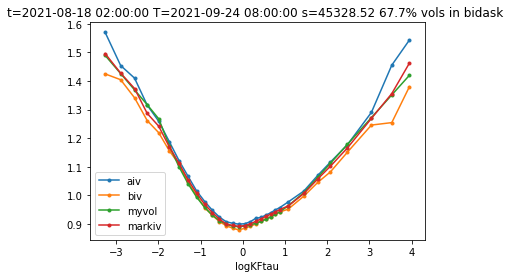

T=2021-09-24 08:00:00 t=2021-08-18 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01891466  0.10285721  0.04166126  0.16572055 -0.18227407]


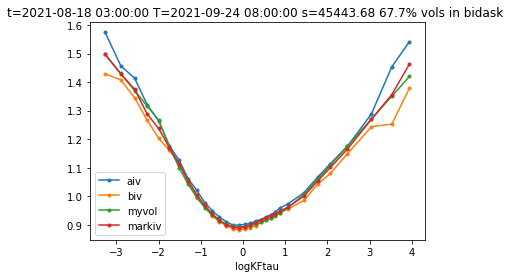

T=2021-09-24 08:00:00 t=2021-08-18 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01884443  0.10398687  0.03976779  0.16852103 -0.19194776]


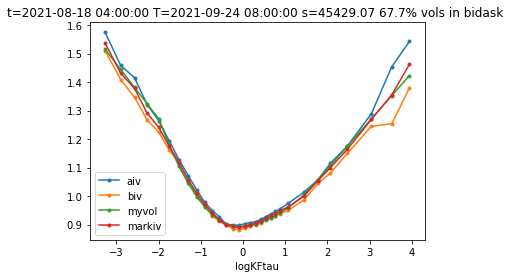

T=2021-09-24 08:00:00 t=2021-08-18 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01906153  0.103882    0.04171574  0.16517906 -0.18961381]


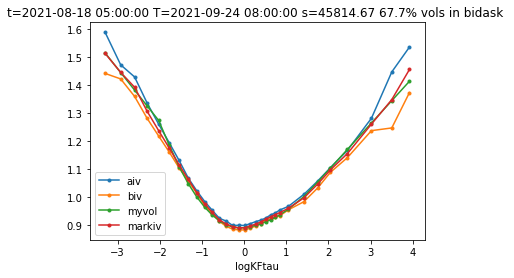

T=2021-09-24 08:00:00 t=2021-08-18 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01596143  0.10313594  0.04364389  0.16827863 -0.17004159]


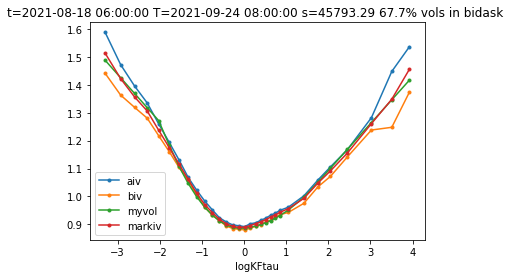

T=2021-09-24 08:00:00 t=2021-08-18 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01992913  0.09806218  0.03898753  0.17563994 -0.19279753]


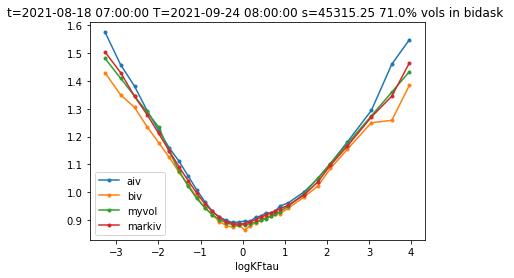

T=2021-09-24 08:00:00 t=2021-08-18 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0193924   0.09945523  0.03910117  0.1745535  -0.20059679]


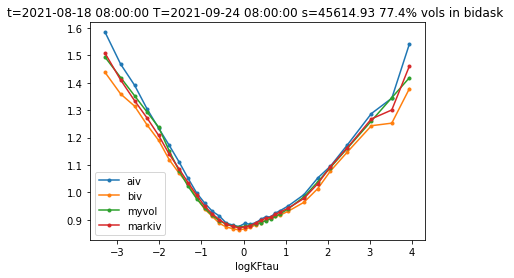

T=2021-09-24 08:00:00 t=2021-08-18 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.020627    0.10028858  0.03715334  0.17080719 -0.2000981 ]


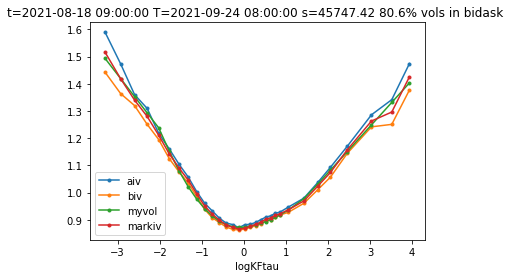

T=2021-09-24 08:00:00 t=2021-08-18 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01969959  0.10063295  0.04106585  0.17088512 -0.19800905]


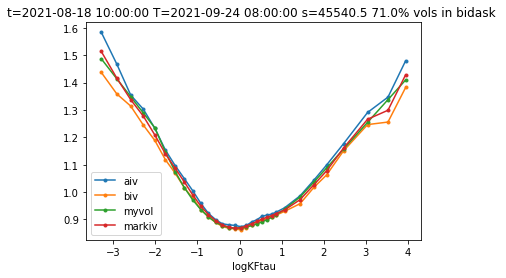

T=2021-09-24 08:00:00 t=2021-08-18 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01711969  0.09839662  0.04401808  0.16863061 -0.19820416]


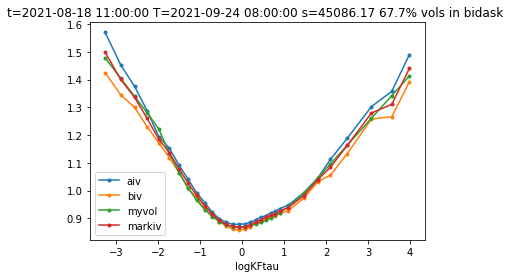

T=2021-09-24 08:00:00 t=2021-08-18 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01611828  0.09521627  0.04111121  0.1696606  -0.2033778 ]


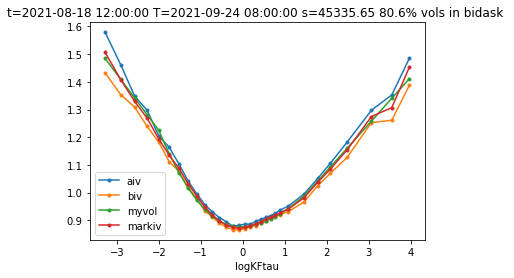

T=2021-09-24 08:00:00 t=2021-08-18 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01691976  0.09974328  0.04267019  0.16139378 -0.18288822]


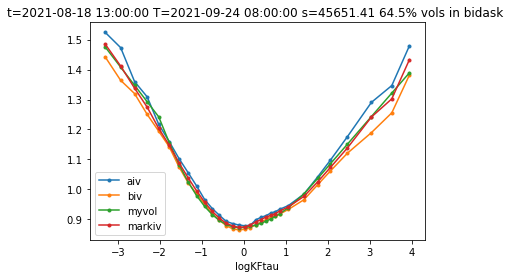

T=2021-09-24 08:00:00 t=2021-08-18 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01717303  0.09825808  0.03688754  0.16881894 -0.1865056 ]


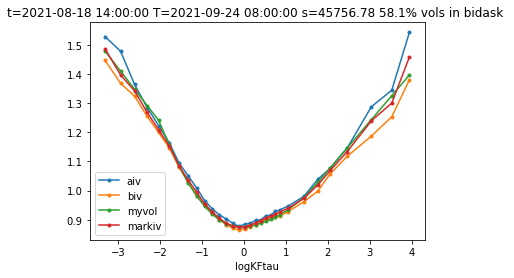

T=2021-09-24 08:00:00 t=2021-08-18 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01483856  0.1005681   0.03663709  0.16262762 -0.17883996]


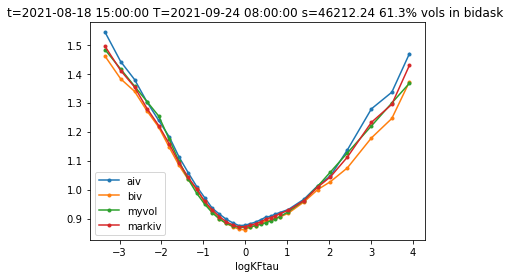

T=2021-09-24 08:00:00 t=2021-08-18 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01802554  0.10069496  0.03062226  0.16598218 -0.19222068]


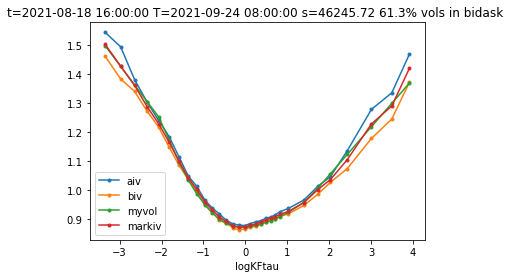

T=2021-09-24 08:00:00 t=2021-08-18 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01463495  0.09831654  0.03352263  0.16350185 -0.19482905]


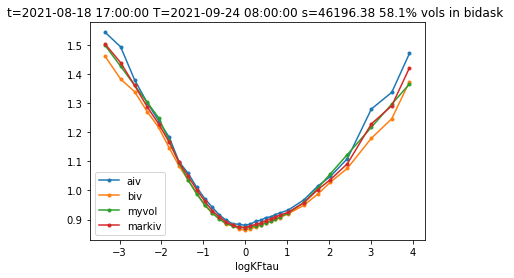

T=2021-09-24 08:00:00 t=2021-08-18 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01198075  0.09646619  0.03653418  0.16693222 -0.18930441]


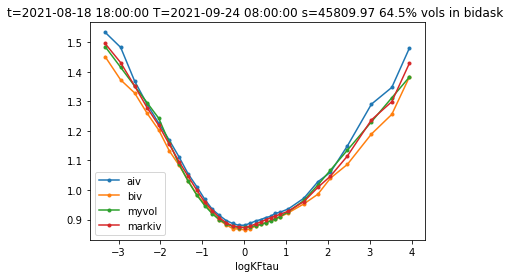

T=2021-09-24 08:00:00 t=2021-08-18 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01087561  0.0931555   0.03916682  0.16780158 -0.18346371]


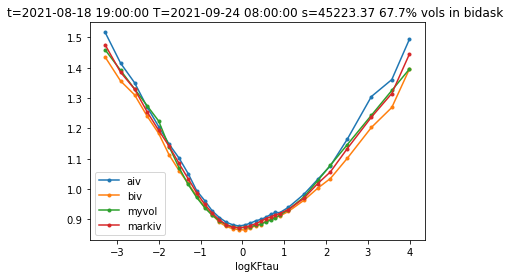

T=2021-09-24 08:00:00 t=2021-08-18 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01960696  0.09780634  0.03379301  0.17010586 -0.17442036]


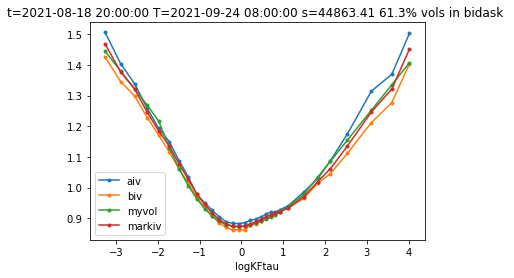

T=2021-09-24 08:00:00 t=2021-08-18 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01859034  0.09527646  0.0361101   0.16509517 -0.16876417]


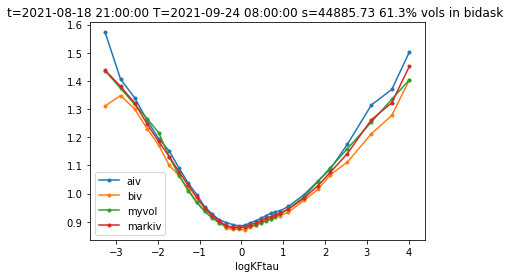

T=2021-09-24 08:00:00 t=2021-08-18 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01823349  0.0965123   0.03562964  0.16247942 -0.18456675]


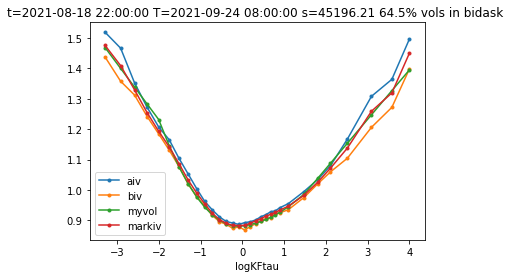

T=2021-09-24 08:00:00 t=2021-08-18 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.02182254  0.09726185  0.03243717  0.16473271 -0.18439155]


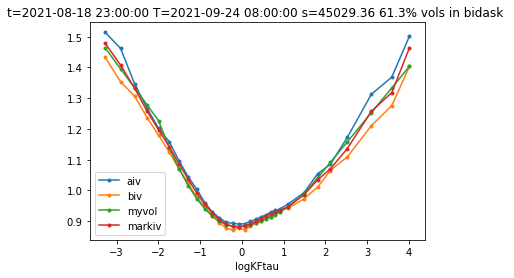

T=2021-09-24 08:00:00 t=2021-08-19 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01745744  0.09599229  0.03539548  0.16602569 -0.19008996]


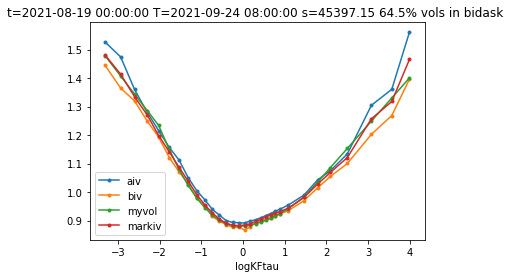

T=2021-09-24 08:00:00 t=2021-08-19 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.02120039  0.09669064  0.03040444  0.17194746 -0.19164143]


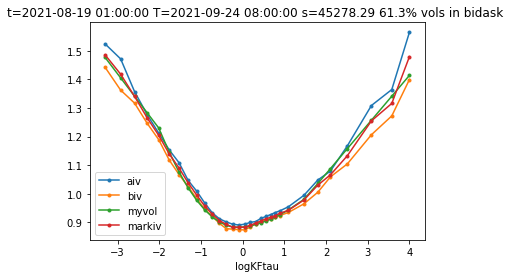

T=2021-09-24 08:00:00 t=2021-08-19 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01372909  0.09325897  0.03067846  0.17328798 -0.20061397]


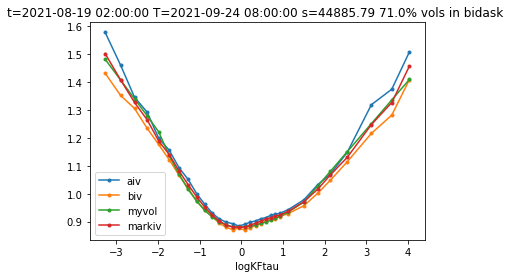

T=2021-09-24 08:00:00 t=2021-08-19 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.00959062  0.09351447  0.03288613  0.17218595 -0.19697482]


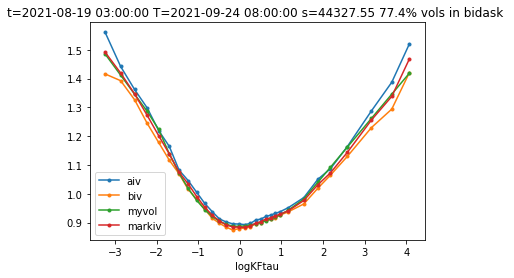

T=2021-09-24 08:00:00 t=2021-08-19 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.00390938  0.09123548  0.03747046  0.17430686 -0.19813444]


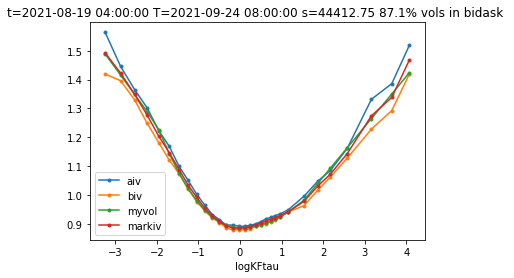

T=2021-09-24 08:00:00 t=2021-08-19 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.00632698  0.09351889  0.03694186  0.1745926  -0.19672639]


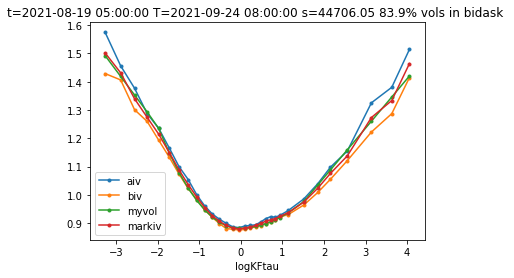

T=2021-09-24 08:00:00 t=2021-08-19 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.00858623  0.09432853  0.03586722  0.17859175 -0.20952635]


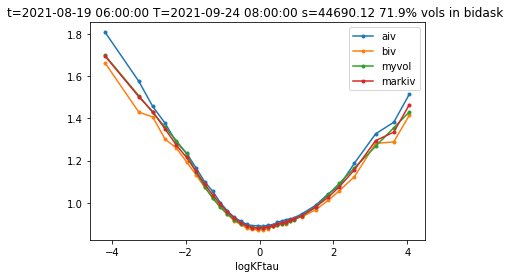

T=2021-09-24 08:00:00 t=2021-08-19 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0071013   0.09518641  0.03757045  0.18100861 -0.20638445]


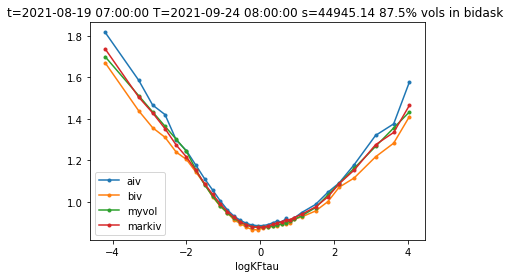

T=2021-09-24 08:00:00 t=2021-08-19 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.00410509  0.09188578  0.04213894  0.17575133 -0.21602731]


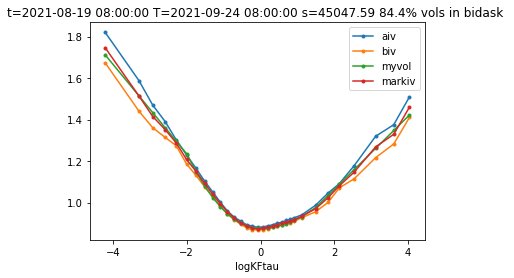

T=2021-09-24 08:00:00 t=2021-08-19 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.00041907  0.08883868  0.04554774  0.1738865  -0.21929886]


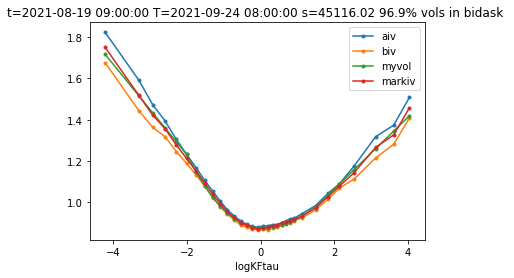

T=2021-09-24 08:00:00 t=2021-08-19 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.00504961  0.09265946  0.04390624  0.17655254 -0.21892378]


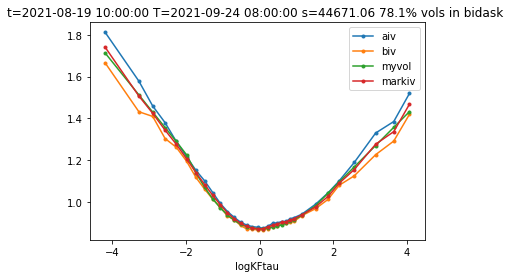

T=2021-09-24 08:00:00 t=2021-08-19 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01281976  0.09879798  0.03676884  0.1795699  -0.19686527]


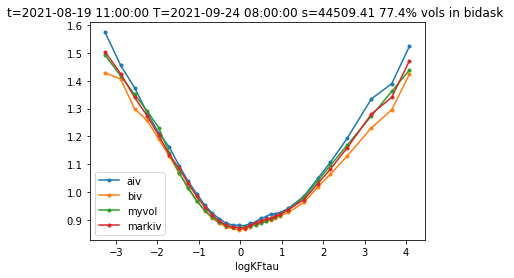

T=2021-09-24 08:00:00 t=2021-08-19 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.00749388  0.09469153  0.04009207  0.17534425 -0.19935297]


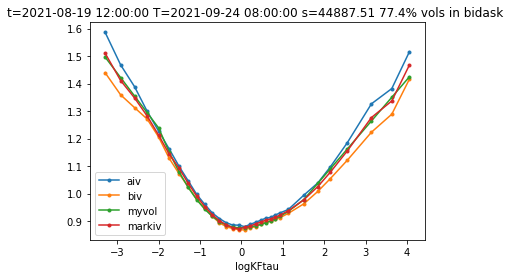

T=2021-09-24 08:00:00 t=2021-08-19 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.00235105  0.09091737  0.04426121  0.17319031 -0.20553806]


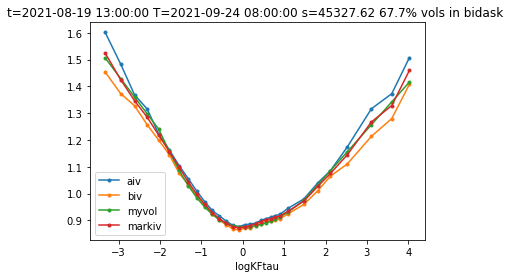

T=2021-09-24 08:00:00 t=2021-08-19 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01613643  0.10207093  0.03640461  0.17362276 -0.19235092]


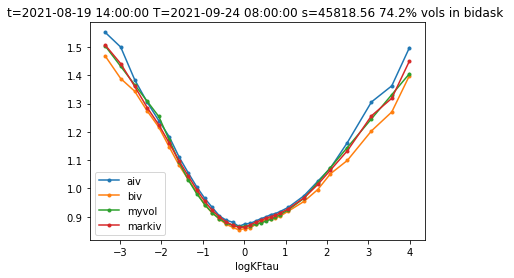

T=2021-09-24 08:00:00 t=2021-08-19 15:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01752621  0.10549925  0.0345605   0.17558605 -0.15994657]


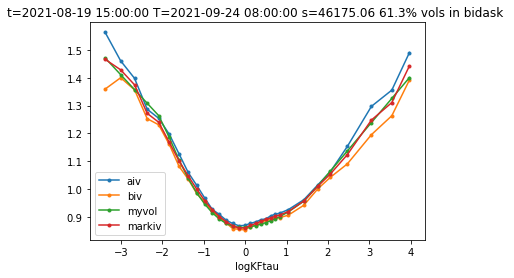

T=2021-09-24 08:00:00 t=2021-08-19 16:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0150097   0.10015514  0.03629094  0.17590874 -0.16073785]


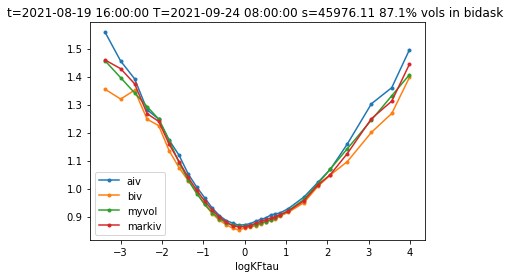

T=2021-09-24 08:00:00 t=2021-08-19 17:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01760817  0.09991981  0.03479092  0.17759685 -0.16624773]


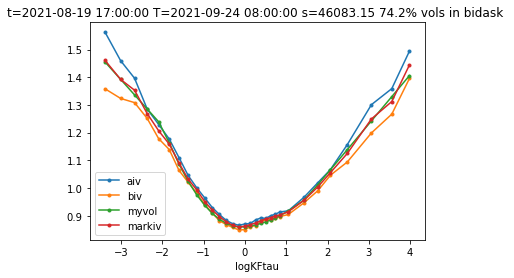

T=2021-09-24 08:00:00 t=2021-08-19 18:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.00979789  0.09529001  0.03503662  0.17399574 -0.17673481]


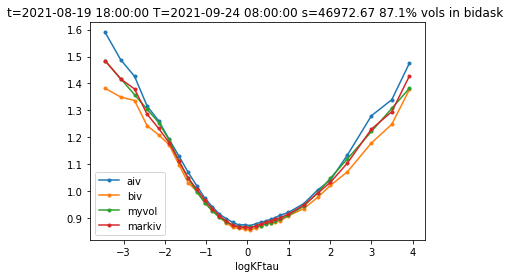

T=2021-09-24 08:00:00 t=2021-08-19 19:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01976272  0.10025235  0.03398825  0.16672073 -0.1762992 ]


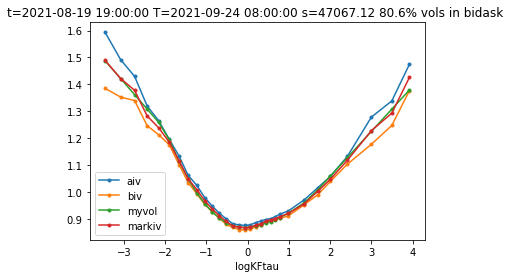

T=2021-09-24 08:00:00 t=2021-08-19 20:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01985216  0.09943226  0.03189144  0.16988118 -0.17823678]


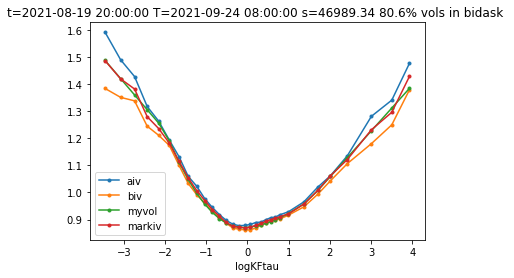

T=2021-09-24 08:00:00 t=2021-08-19 21:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01796559  0.09757007  0.03439498  0.17577663 -0.20929161]


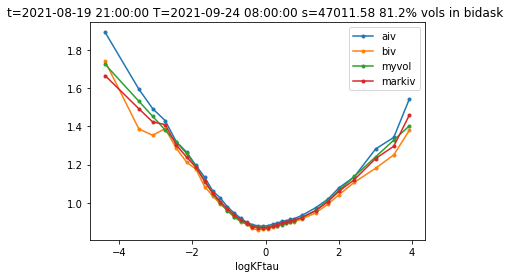

T=2021-09-24 08:00:00 t=2021-08-19 22:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0240801   0.09890721  0.02682304  0.17349726 -0.21680012]


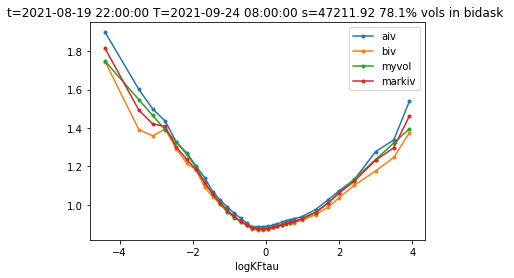

T=2021-09-24 08:00:00 t=2021-08-19 23:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01503894  0.0947196   0.02963823  0.18649441 -0.22137005]


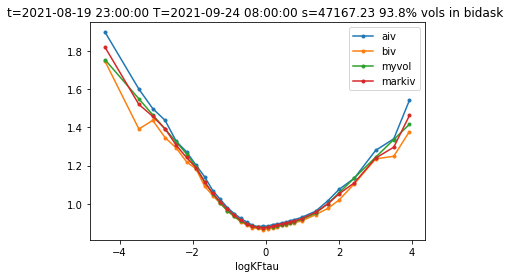

T=2021-09-24 08:00:00 t=2021-08-20 00:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.02592689  0.0998178   0.02205644  0.17853422 -0.22829094]


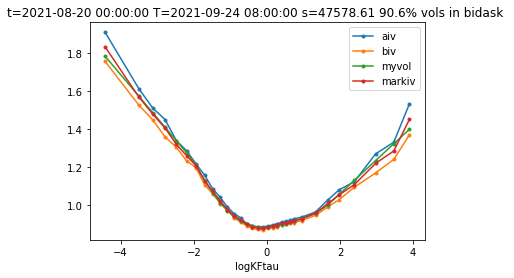

T=2021-09-24 08:00:00 t=2021-08-20 01:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.02842229  0.10000682  0.0219898   0.18127064 -0.2389643 ]


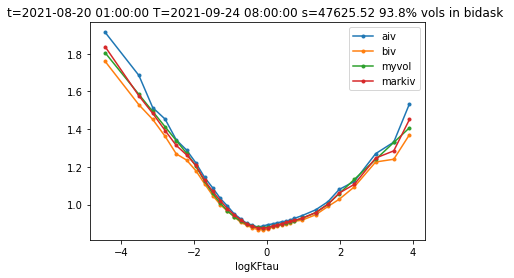

T=2021-09-24 08:00:00 t=2021-08-20 02:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0220853   0.09719177  0.03128302  0.1772127  -0.2270465 ]


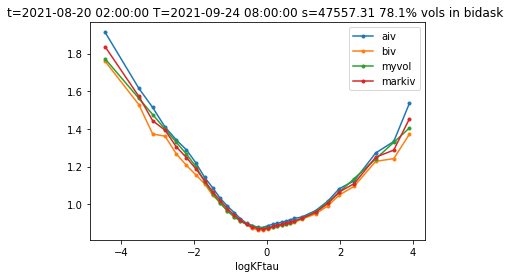

T=2021-09-24 08:00:00 t=2021-08-20 03:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.02548779  0.10104744  0.02802737  0.18724727 -0.23143603]


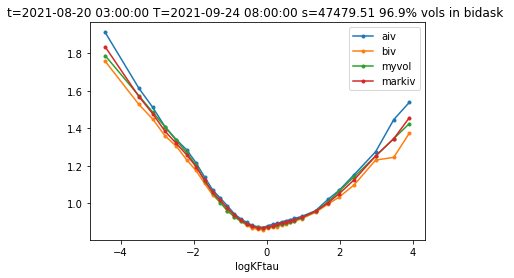

T=2021-09-24 08:00:00 t=2021-08-20 04:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03007878  0.10028101  0.0233886   0.18834828 -0.20276099]


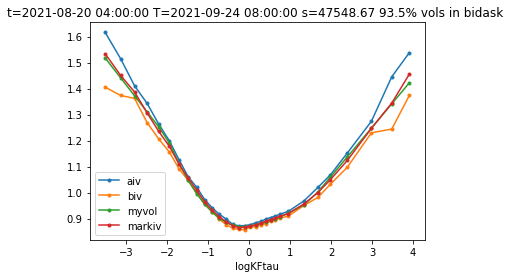

T=2021-09-24 08:00:00 t=2021-08-20 05:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03033367  0.10182682  0.02556879  0.1871576  -0.19978013]


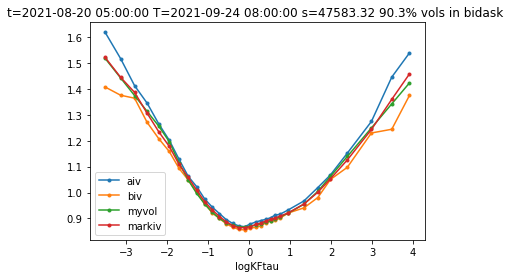

T=2021-09-24 08:00:00 t=2021-08-20 06:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.03033249  0.10211531  0.02517893  0.18761842 -0.20159997]


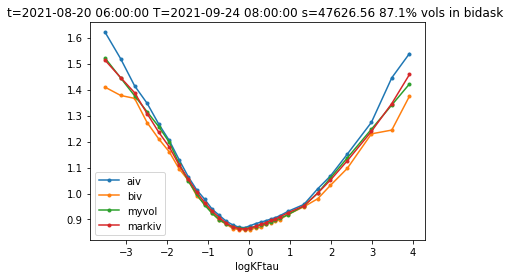

T=2021-09-24 08:00:00 t=2021-08-20 07:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.02336821  0.10292623  0.03341565  0.18657114 -0.20049569]


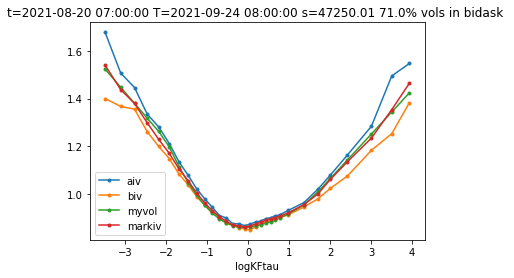

T=2021-09-24 08:00:00 t=2021-08-20 08:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01838397  0.10030057  0.03745102  0.1755224  -0.19406595]


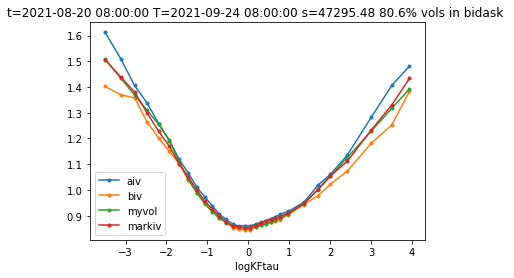

T=2021-09-24 08:00:00 t=2021-08-20 09:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01202529  0.09873161  0.04921326  0.19001162 -0.19641542]


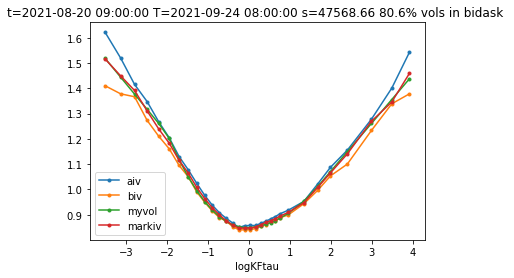

T=2021-09-24 08:00:00 t=2021-08-20 10:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01400234  0.10195907  0.04838007  0.19083623 -0.20375831]


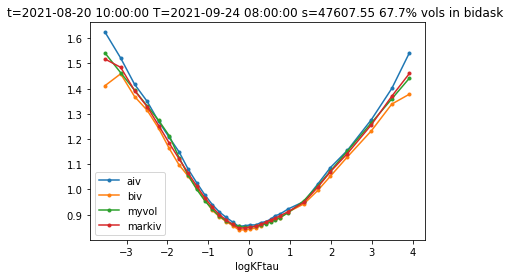

T=2021-09-24 08:00:00 t=2021-08-20 11:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01653401  0.10406792  0.04774105  0.18766939 -0.19751047]


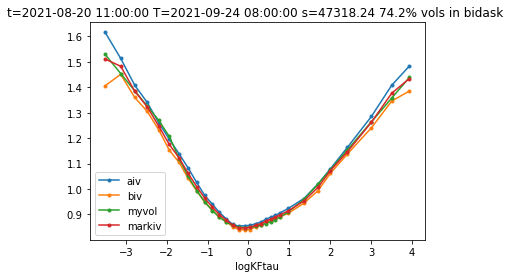

T=2021-09-24 08:00:00 t=2021-08-20 12:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.01689571  0.10716903  0.05024664  0.18176081 -0.19706755]


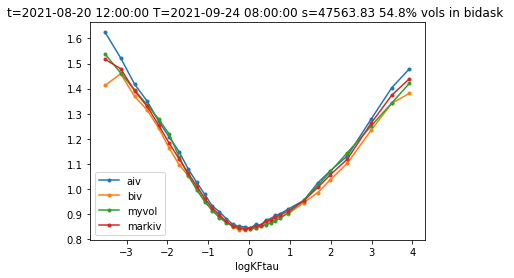

T=2021-09-24 08:00:00 t=2021-08-20 13:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.02766389  0.11152262  0.04202467  0.18283768 -0.19274515]


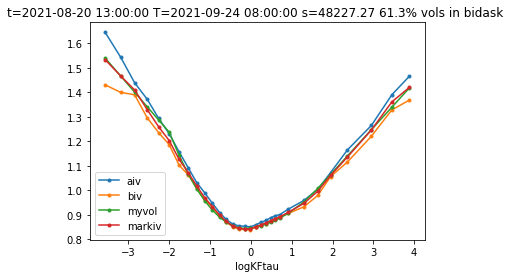

T=2021-09-24 08:00:00 t=2021-08-20 14:00:00
prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2] model=errfunc_parabolic_linear6
optimized params:[ 0.2         0.0470277   0.11003224  0.02744187  0.17699788 -0.22491137]


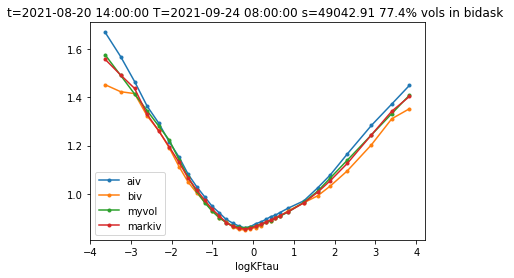

[{'t': Timestamp('2021-08-06 15:00:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.8556019135,
  's': 42653.91,
  'rr': 0.00394389594312794,
  'conv': 0.001655606851751923,
  'perc': 0.8275862068965517,
  'p0': 0.2,
  'p1': 0.019665609876485975,
  'p2': 0.10283582023027728,
  'p3': 0.056778324963319506,
  'p4': 0.18210087691089077,
  'p5': -0.1656487797618814},
 {'t': Timestamp('2021-08-06 16:00:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.8607453065,
  's': 43029.23,
  'rr': 0.007110058975201228,
  'conv': 0.0017327126353444688,
  'perc': 0.6333333333333333,
  'p0': 0.2,
  'p1': 0.03101308724068134,
  'p2': 0.10524783356626553,
  'p3': 0.05397130227628508,
  'p4': 0.15810181804704682,
  'p5': -0.16323669442753058},
 {'t': Timestamp('2021-08-06 17:00:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.8582033725000001,
  's': 43389.3,
  'rr': 0.006951683888796523,
  'conv': 0.0016908217220675814,
  'perc': 0.8666666666666667,
  'p0': 0.2,
  'p1': 0

In [59]:
#same skew
volfit(df.query("tm >'2021-08-06 14:00:00' and tm< '2021-08-20 14:10:00' "),plot=3,model='errfunc_parabolic_linear6',kleft=-2,kright=1.5)

T=2021-09-24 08:00:00 t=2021-08-06 15:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.0087025   0.08237891  0.16958936 -0.19722569]


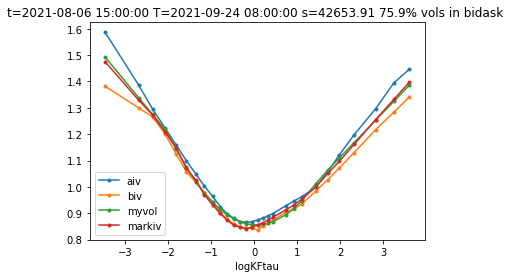

T=2021-09-24 08:00:00 t=2021-08-06 16:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.00065891  0.08234106  0.14571036 -0.19817802]


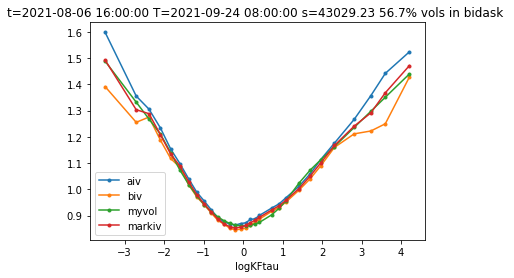

T=2021-09-24 08:00:00 t=2021-08-06 17:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.0036975   0.08133113  0.1576275  -0.21668956]


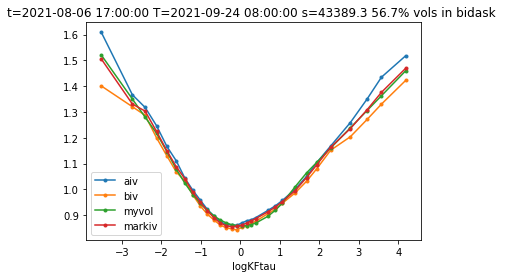

T=2021-09-24 08:00:00 t=2021-08-06 18:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.0010882   0.08253524  0.15383118 -0.21573069]


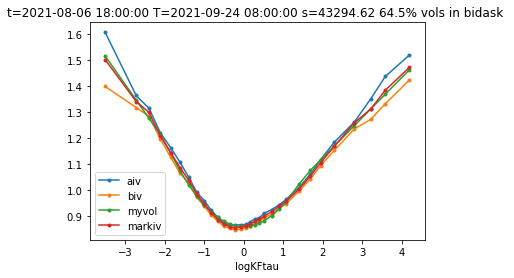

T=2021-09-24 08:00:00 t=2021-08-06 19:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00426688  0.08280631  0.15241888 -0.21635867]


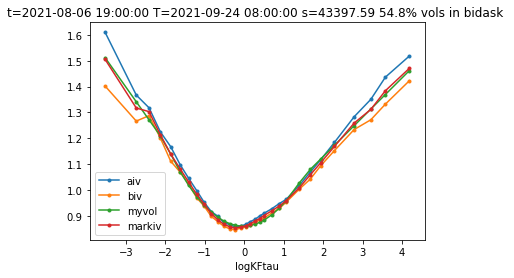

T=2021-09-24 08:00:00 t=2021-08-06 20:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00410672  0.08409534  0.15267777 -0.20726818]


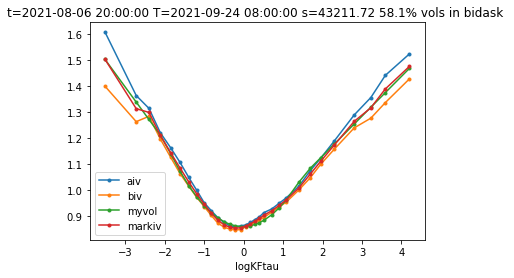

T=2021-09-24 08:00:00 t=2021-08-06 21:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00433964  0.08529312  0.15710728 -0.20431592]


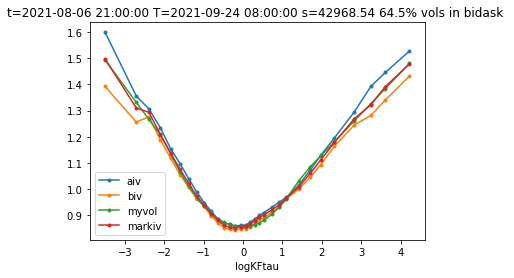

T=2021-09-24 08:00:00 t=2021-08-06 22:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00555904  0.08380693  0.1555094  -0.21593293]


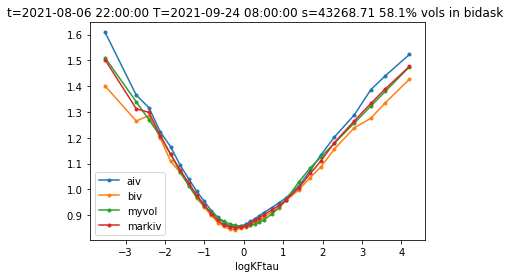

T=2021-09-24 08:00:00 t=2021-08-06 23:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00603264  0.08434332  0.15621563 -0.21637081]


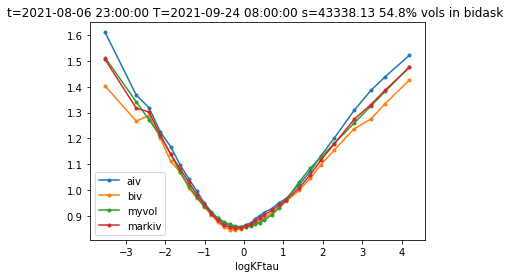

T=2021-09-24 08:00:00 t=2021-08-07 00:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00467884  0.08285928  0.1553573  -0.22277197]


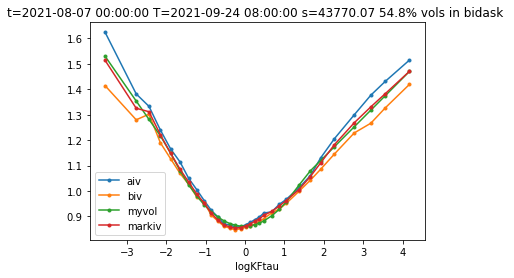

T=2021-09-24 08:00:00 t=2021-08-07 01:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00409575  0.08251734  0.15725884 -0.22388896]


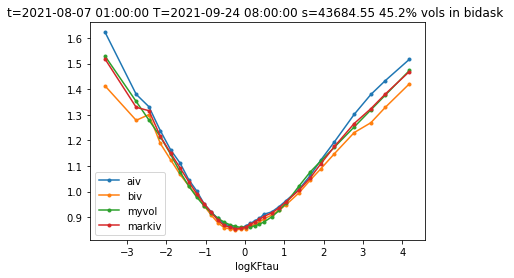

T=2021-09-24 08:00:00 t=2021-08-07 02:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00399981  0.08318346  0.15535726 -0.22652143]


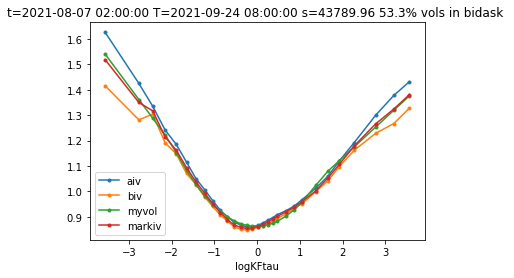

T=2021-09-24 08:00:00 t=2021-08-07 03:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00453944  0.08631375  0.15552028 -0.22011949]


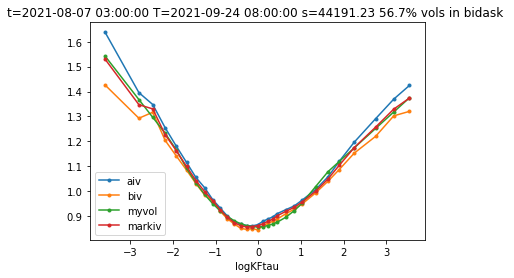

T=2021-09-24 08:00:00 t=2021-08-07 04:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00152726  0.08762156  0.16269133 -0.20731873]


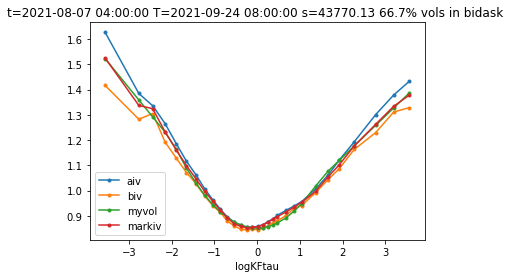

T=2021-09-24 08:00:00 t=2021-08-07 05:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00105026  0.08823861  0.16373476 -0.2132549 ]


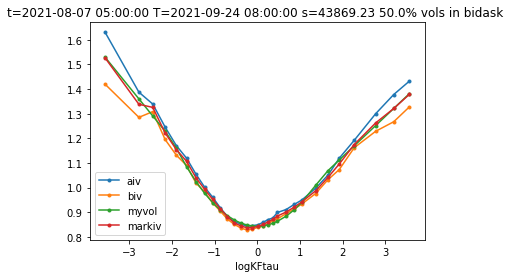

T=2021-09-24 08:00:00 t=2021-08-07 06:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00123552  0.09104802  0.16482548 -0.20146972]


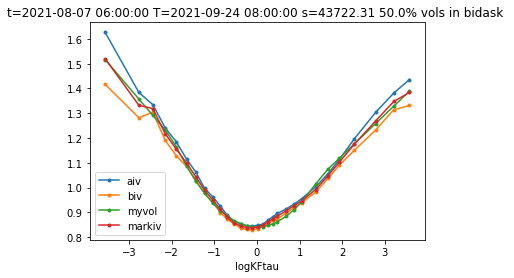

T=2021-09-24 08:00:00 t=2021-08-07 07:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00155179  0.09162821  0.16055936 -0.2256463 ]


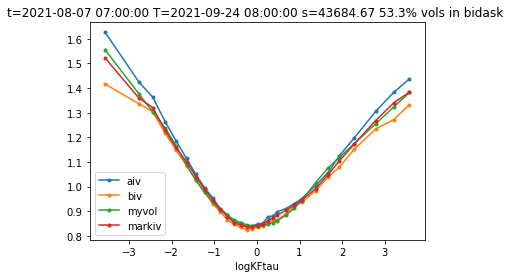

T=2021-09-24 08:00:00 t=2021-08-07 08:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.00069095  0.09177909  0.16698396 -0.20597465]


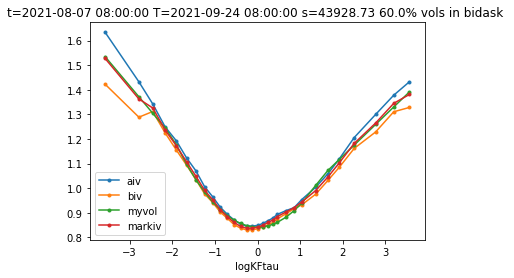

T=2021-09-24 08:00:00 t=2021-08-07 09:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.00045106  0.09073822  0.16180774 -0.21443436]


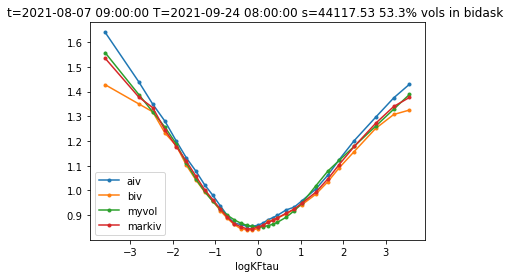

T=2021-09-24 08:00:00 t=2021-08-07 10:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[ 0.00123584  0.08527304  0.15720819 -0.2215021 ]


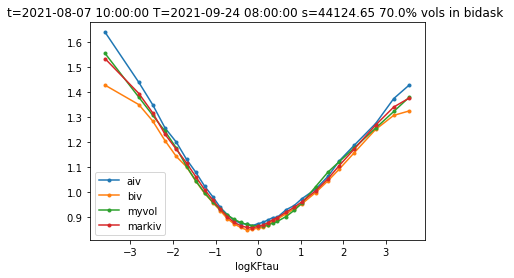

T=2021-09-24 08:00:00 t=2021-08-07 11:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.00109521  0.08777661  0.15822635 -0.21808673]


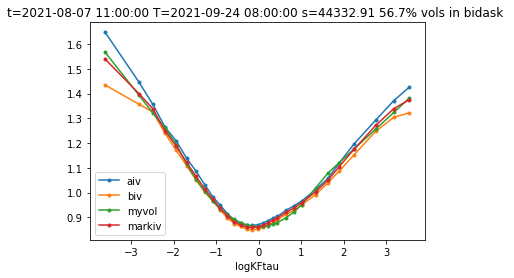

T=2021-09-24 08:00:00 t=2021-08-07 12:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.00310872  0.09008183  0.16086412 -0.21089411]


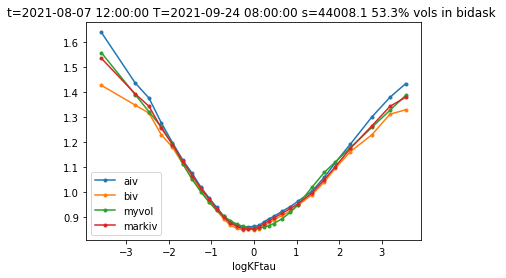

T=2021-09-24 08:00:00 t=2021-08-07 13:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.00311798  0.09079954  0.1531895  -0.20580083]


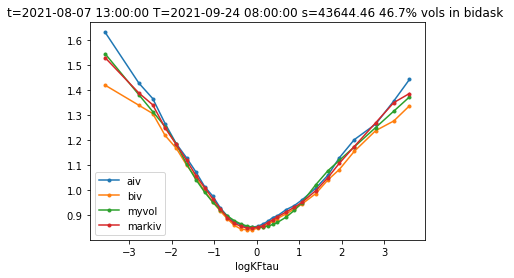

T=2021-09-24 08:00:00 t=2021-08-07 14:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.00342313  0.08921178  0.16094985 -0.21495229]


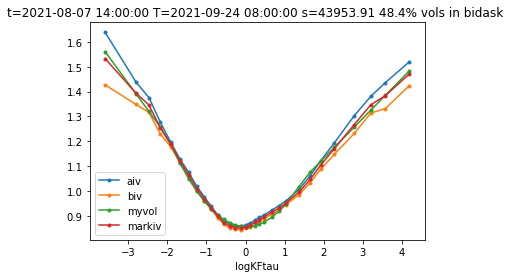

[{'t': Timestamp('2021-08-06 15:00:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.8556019135,
  's': 42653.91,
  'rr': -0.002808125441386311,
  'conv': 0.0019244117250999393,
  'perc': 0.7586206896551724,
  'p0': -0.008702499966482822,
  'p1': 0.08237890900740731,
  'p2': 0.1695893616111506,
  'p3': -0.19722568721005576},
 {'t': Timestamp('2021-08-06 16:00:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.8607453065,
  's': 43029.23,
  'rr': -0.00041274762745535654,
  'conv': 0.00187991128691678,
  'perc': 0.5666666666666667,
  'p0': -0.0006589076386127842,
  'p1': 0.0823410600007855,
  'p2': 0.14571036262987833,
  'p3': -0.19817802154380268},
 {'t': Timestamp('2021-08-06 17:00:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.8582033725000001,
  's': 43389.3,
  'rr': -0.0013067696955990638,
  'conv': 0.0018262412553615714,
  'perc': 0.5666666666666667,
  'p0': -0.003697499405679054,
  'p1': 0.08133113015618938,
  'p2': 0.15762749803418247,
  'p3': -

In [56]:
volfit(df.query("tm >'2021-08-06 14:00:00' and tm< '2021-08-07 14:10:00' "),plot=3,model='errfunc_parabolic_linear4',kleft=-2,kright=1.5)

T=2021-09-24 08:00:00 t=2021-08-06 15:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.00022611 0.04917725 0.09163111 0.03496565]
plot=3


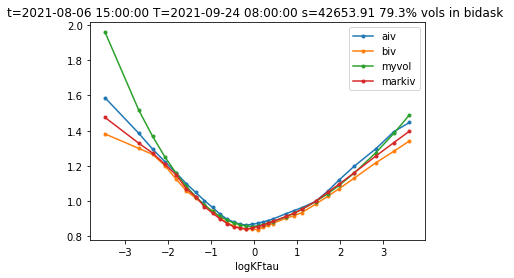

T=2021-09-24 08:00:00 t=2021-08-06 16:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.01507631 0.05992393 0.09610287 0.03083935]
plot=3


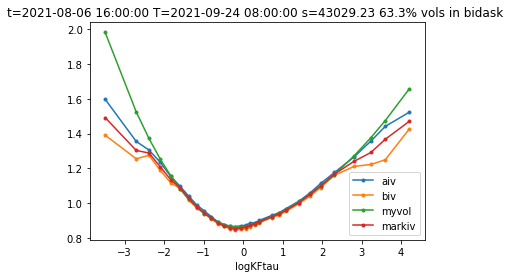

T=2021-09-24 08:00:00 t=2021-08-06 17:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.02087112 0.04910256 0.10056864 0.03603959]
plot=3


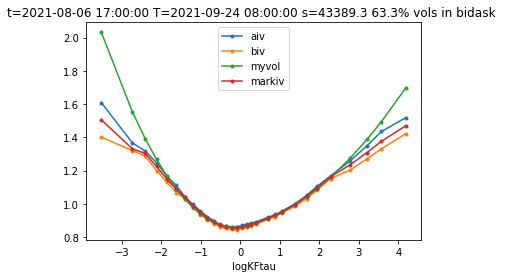

T=2021-09-24 08:00:00 t=2021-08-06 18:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.02103165 0.05588158 0.09953078 0.03475933]
plot=3


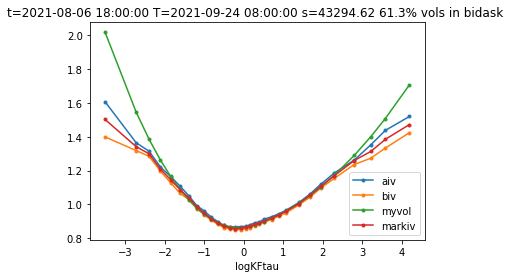

T=2021-09-24 08:00:00 t=2021-08-06 19:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.02819702 0.05987402 0.10216727 0.03381204]
plot=3


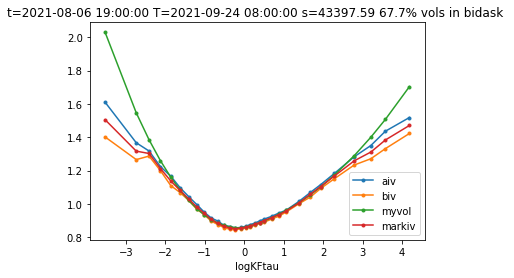

T=2021-09-24 08:00:00 t=2021-08-06 20:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.02648291 0.06313977 0.10318454 0.03258691]
plot=3


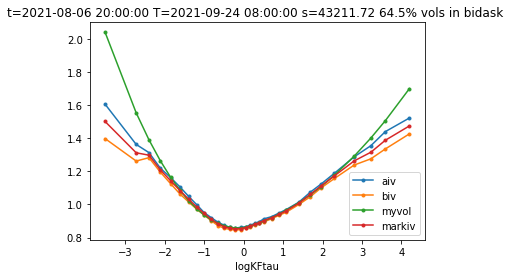

T=2021-09-24 08:00:00 t=2021-08-06 21:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.01962797 0.06608872 0.09884466 0.03173408]
plot=3


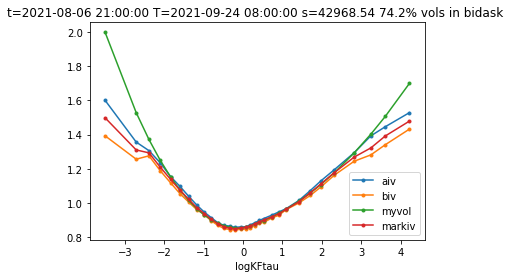

T=2021-09-24 08:00:00 t=2021-08-06 22:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.02826183 0.06491343 0.10257298 0.0318785 ]
plot=3


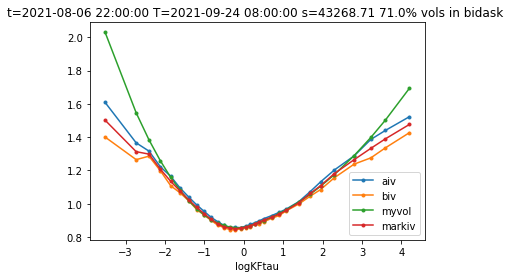

T=2021-09-24 08:00:00 t=2021-08-06 23:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.02858751 0.06386679 0.1028387  0.03349068]
plot=3


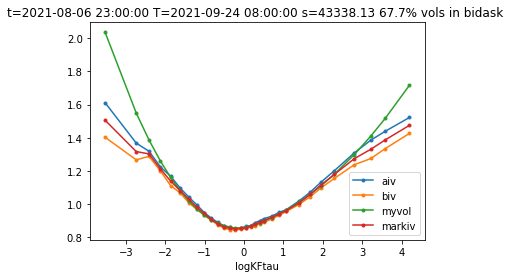

T=2021-09-24 08:00:00 t=2021-08-07 00:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.02699106 0.05973148 0.1009031  0.03429679]
plot=3


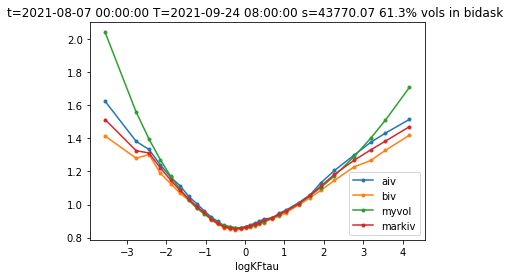

T=2021-09-24 08:00:00 t=2021-08-07 01:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.02548329 0.05903114 0.09985229 0.03435351]
plot=3


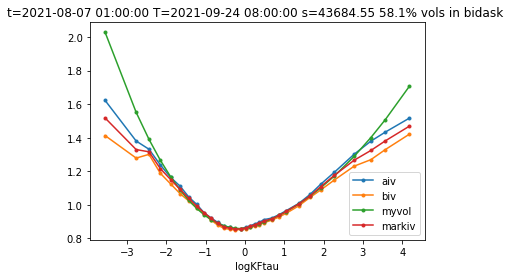

T=2021-09-24 08:00:00 t=2021-08-07 02:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.03201332 0.05903654 0.10553795 0.03437576]
plot=3


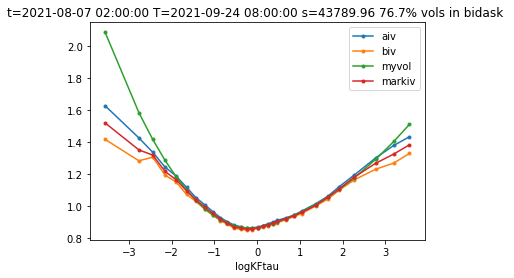

T=2021-09-24 08:00:00 t=2021-08-07 03:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.01265288 0.07449046 0.09425553 0.02687709]
plot=3


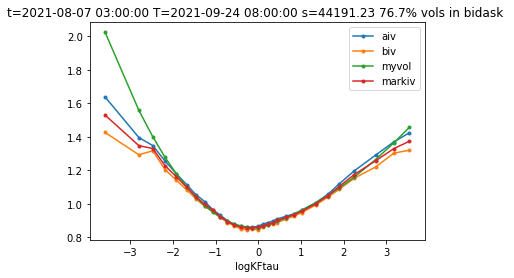

T=2021-09-24 08:00:00 t=2021-08-07 04:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.00954313 0.06220529 0.09538064 0.03511856]
plot=3


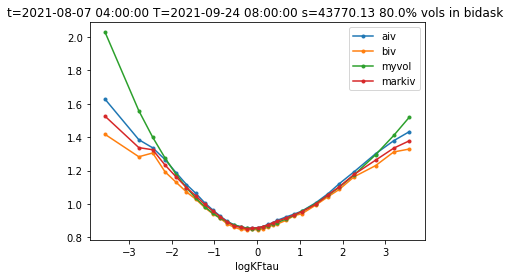

T=2021-09-24 08:00:00 t=2021-08-07 05:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.01916726 0.06300258 0.10376288 0.0341499 ]
plot=3


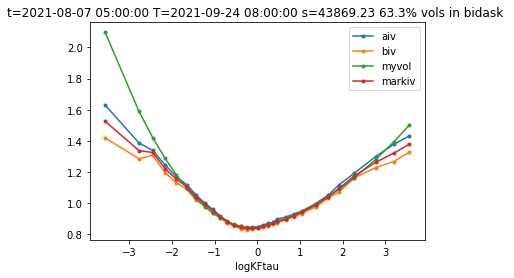

T=2021-09-24 08:00:00 t=2021-08-07 06:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.00882534 0.07031943 0.09979485 0.03208529]
plot=3


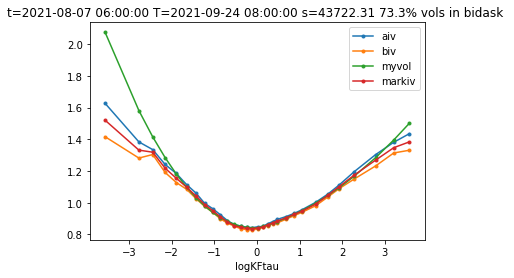

T=2021-09-24 08:00:00 t=2021-08-07 07:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.02449959 0.06572084 0.1098944  0.03502462]
plot=3


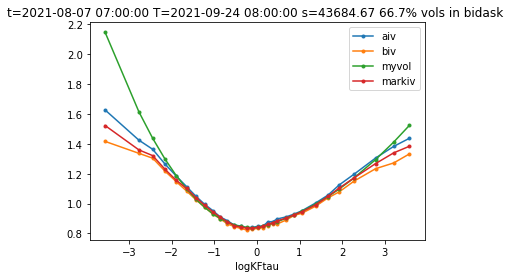

T=2021-09-24 08:00:00 t=2021-08-07 08:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.01266275 0.06231484 0.10381628 0.03684141]
plot=3


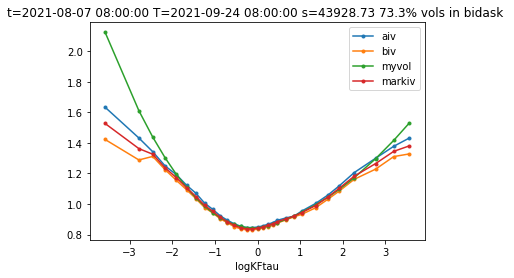

T=2021-09-24 08:00:00 t=2021-08-07 09:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.01960448 0.06743748 0.10741009 0.0321192 ]
plot=3


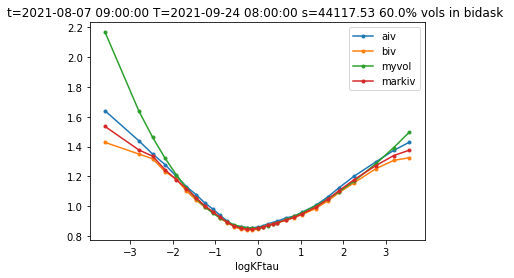

T=2021-09-24 08:00:00 t=2021-08-07 10:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.01754284 0.05741515 0.09938084 0.03626666]
plot=3


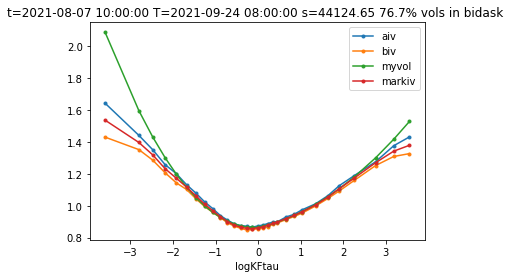

T=2021-09-24 08:00:00 t=2021-08-07 11:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.01122631 0.06331812 0.09865378 0.03228152]
plot=3


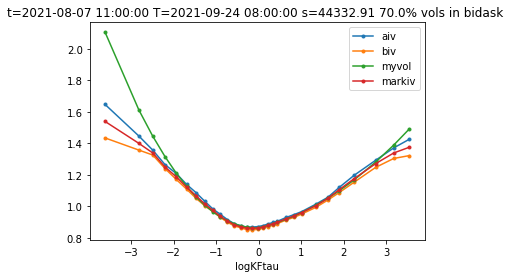

T=2021-09-24 08:00:00 t=2021-08-07 12:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.00775101 0.06233686 0.09994147 0.03386139]
plot=3


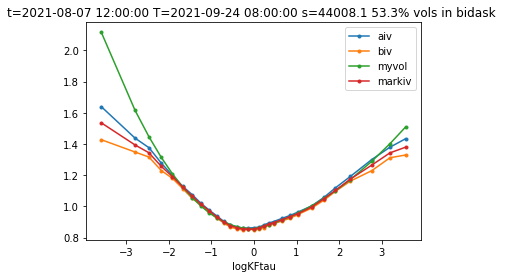

T=2021-09-24 08:00:00 t=2021-08-07 13:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.01047766 0.0629763  0.10321104 0.03343606]
plot=3


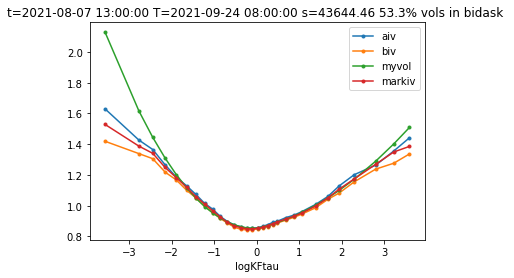

T=2021-09-24 08:00:00 t=2021-08-07 14:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic4
optimized params:[0.01395296 0.06112419 0.10368989 0.03349631]
plot=3


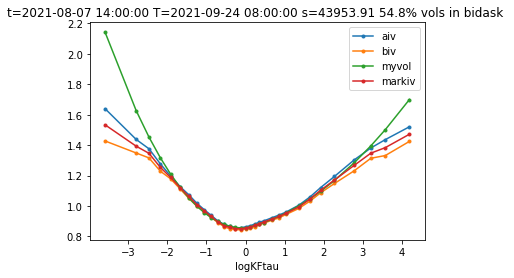

[{'t': Timestamp('2021-08-06 15:00:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.8556019135,
  's': 42653.91,
  'rr': 0.0047038637931847704,
  'conv': 0.004603381670191475,
  'perc': 0.7931034482758621,
  'p0': 0.0002261090034982204,
  'p1': 0.0491772454996594,
  'p2': 0.09163110570407557,
  'p3': 0.034965651416591775},
 {'t': Timestamp('2021-08-06 16:00:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.8607453065,
  's': 43029.23,
  'rr': 0.008443926078101516,
  'conv': 0.0044240345544350745,
  'perc': 0.6333333333333333,
  'p0': 0.015076310717404876,
  'p1': 0.059923926975902785,
  'p2': 0.09610287359737306,
  'p3': 0.03083935149225643},
 {'t': Timestamp('2021-08-06 17:00:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.8582033725000001,
  's': 43389.3,
  'rr': 0.007830074858798497,
  'conv': 0.003400166787305481,
  'perc': 0.6333333333333333,
  'p0': 0.02087111742753564,
  'p1': 0.04910256164417218,
  'p2': 0.10056864447460956,
  'p3': 0.0360395

In [49]:
volfit(df.query("tm >'2021-08-06 14:00:00' and tm< '2021-08-07 14:10:00' "),plot=3,model='errfunc_parabolic4',kleft=-2,kright=1.5)

T=2021-09-24 08:00:00 t=2021-09-06 14:05:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


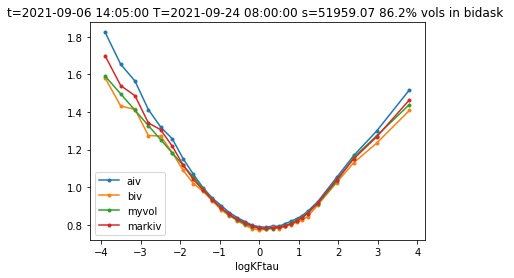

[{'t': Timestamp('2021-09-06 14:05:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.78118813875,
  's': 51959.07,
  'rr': -0.015197801737832028,
  'conv': 0.004933736276015899,
  'perc': 0.8620689655172413,
  'p0': -0.03214854393754286,
  'p1': 0.08174553255074808,
  'p2': 0.2,
  'p3': -0.24088046759541845}]

In [18]:
volfit(df.query("tm >'2021-09-06 14:00:00' and tm< '2021-09-06 14:10:00' "),plot=3,model='errfunc_parabolic_linear4',kleft=-1.5,kright=2.3)

In [20]:
resvf={'t': pd.Timestamp('2021-09-06 14:05:00'),
  'T': pd.Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.78118813875,
  's': 51959.07,
  'rr': -0.015197801737832028,
  'conv': 0.004933736276015899,
  'perc': 0.8620689655172413,
  'p0': -0.03214854393754286,
  'p1': 0.08174553255074808,
  'p2': 0.2,
  'p3': -0.24088046759541845}

In [21]:
resvf

{'t': Timestamp('2021-09-06 14:05:00'),
 'T': Timestamp('2021-09-24 08:00:00'),
 'volATM': 0.78118813875,
 's': 51959.07,
 'rr': -0.015197801737832028,
 'conv': 0.004933736276015899,
 'perc': 0.8620689655172413,
 'p0': -0.03214854393754286,
 'p1': 0.08174553255074808,
 'p2': 0.2,
 'p3': -0.24088046759541845}

T=2021-09-24 08:00:00 t=2021-09-06 14:05:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


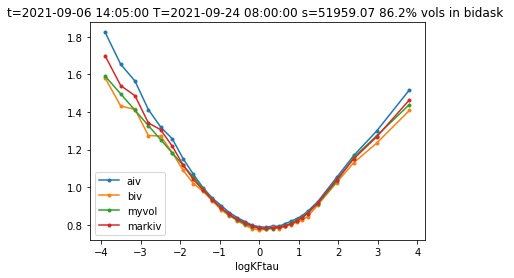

T=2021-09-24 08:00:00 t=2021-09-06 14:10:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


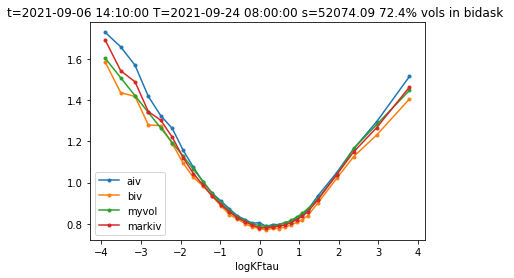

T=2021-09-24 08:00:00 t=2021-09-06 14:15:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


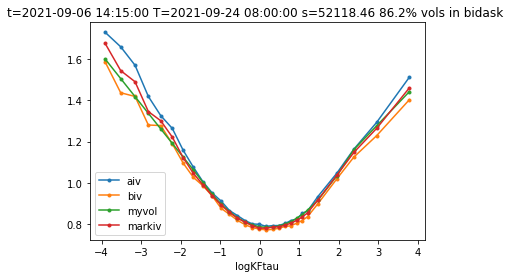

T=2021-09-24 08:00:00 t=2021-09-06 14:20:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


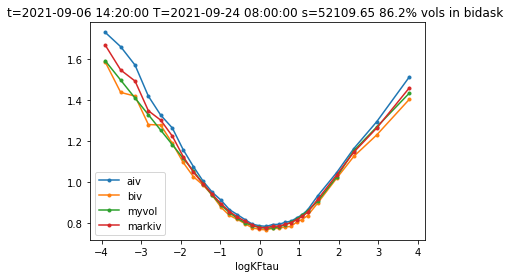

T=2021-09-24 08:00:00 t=2021-09-06 14:25:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


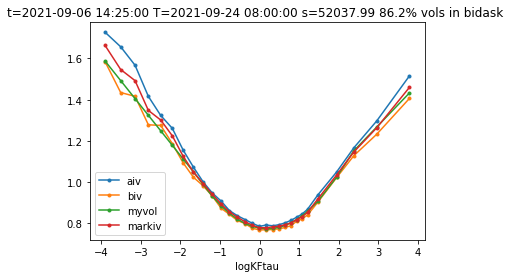

T=2021-09-24 08:00:00 t=2021-09-06 14:30:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


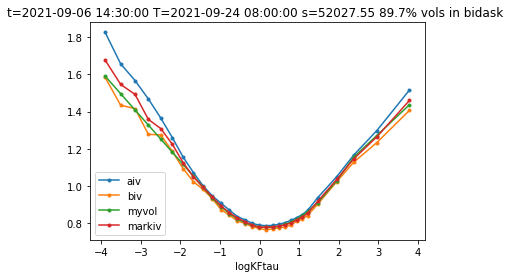

T=2021-09-24 08:00:00 t=2021-09-06 14:35:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


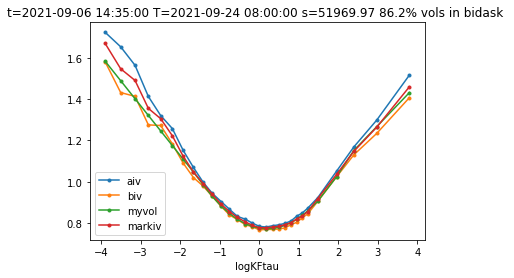

T=2021-09-24 08:00:00 t=2021-09-06 14:40:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


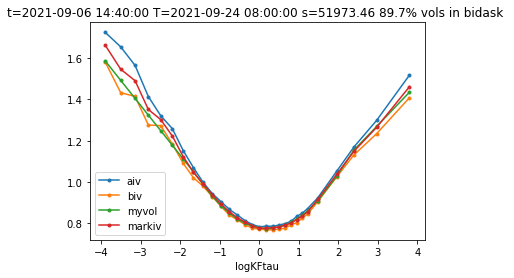

T=2021-09-24 08:00:00 t=2021-09-06 14:45:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


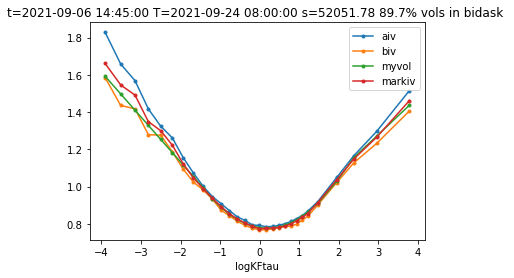

T=2021-09-24 08:00:00 t=2021-09-06 14:50:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


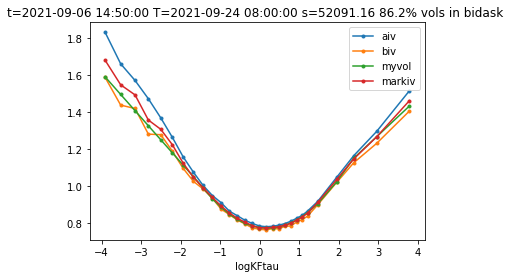

T=2021-09-24 08:00:00 t=2021-09-06 14:55:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


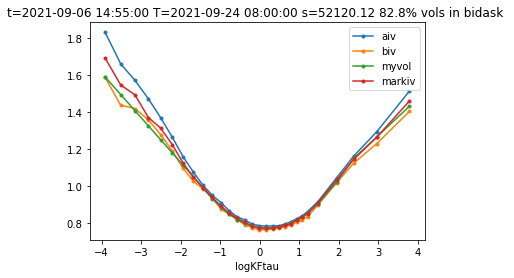

T=2021-09-24 08:00:00 t=2021-09-06 15:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


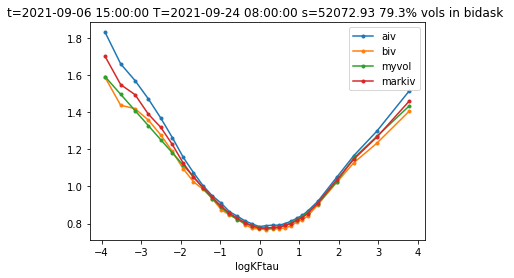

T=2021-09-24 08:00:00 t=2021-09-06 15:05:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


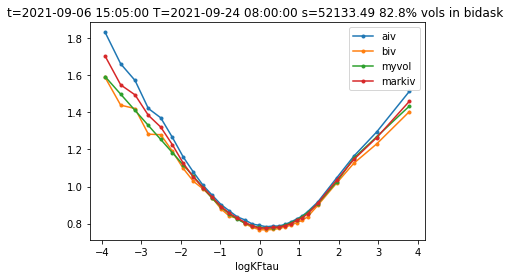

T=2021-09-24 08:00:00 t=2021-09-06 15:10:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


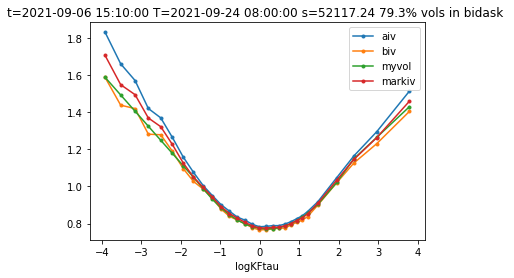

T=2021-09-24 08:00:00 t=2021-09-06 15:15:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


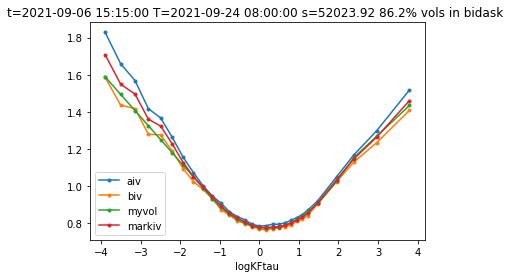

T=2021-09-24 08:00:00 t=2021-09-06 15:20:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


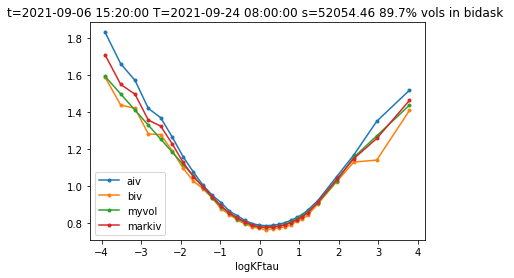

T=2021-09-24 08:00:00 t=2021-09-06 15:25:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


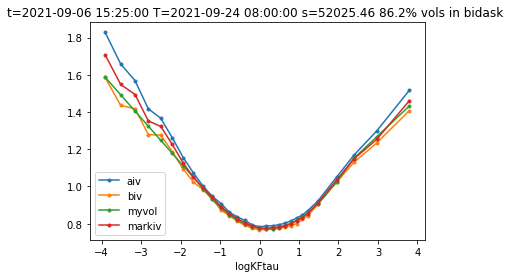

T=2021-09-24 08:00:00 t=2021-09-06 15:30:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


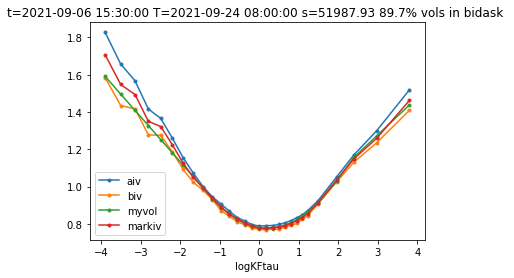

T=2021-09-24 08:00:00 t=2021-09-06 15:35:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


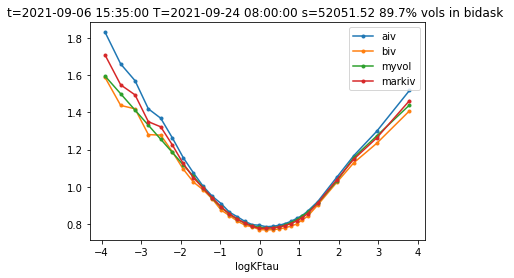

T=2021-09-24 08:00:00 t=2021-09-06 15:40:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


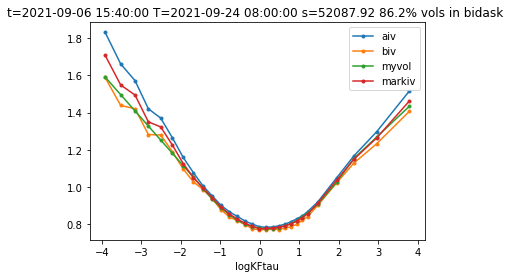

T=2021-09-24 08:00:00 t=2021-09-06 15:45:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


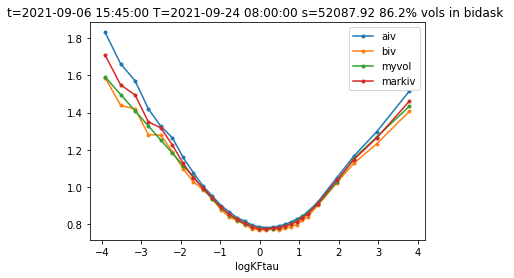

T=2021-09-24 08:00:00 t=2021-09-06 15:50:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


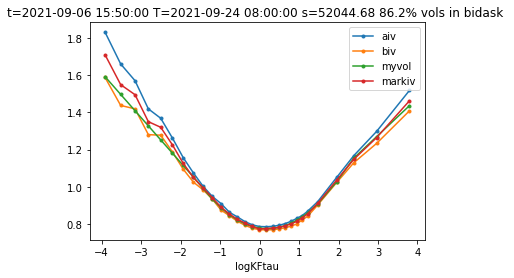

T=2021-09-24 08:00:00 t=2021-09-06 15:55:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


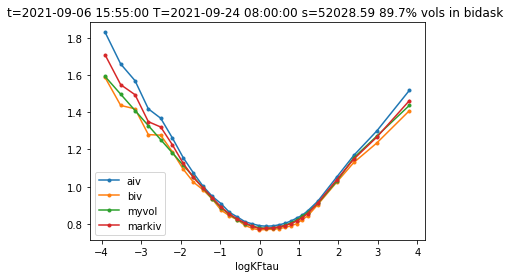

T=2021-09-24 08:00:00 t=2021-09-06 16:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


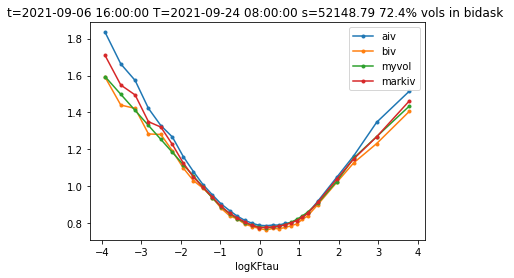

T=2021-09-24 08:00:00 t=2021-09-06 16:05:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


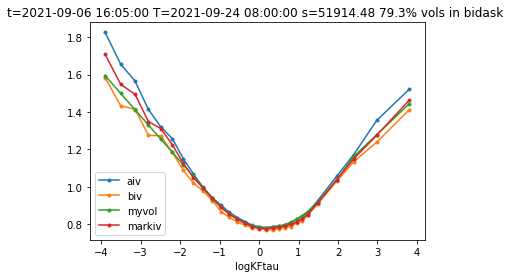

T=2021-09-24 08:00:00 t=2021-09-06 16:10:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


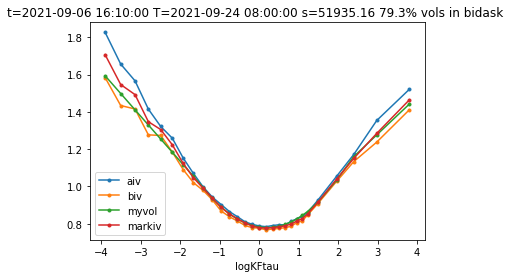

T=2021-09-24 08:00:00 t=2021-09-06 16:15:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


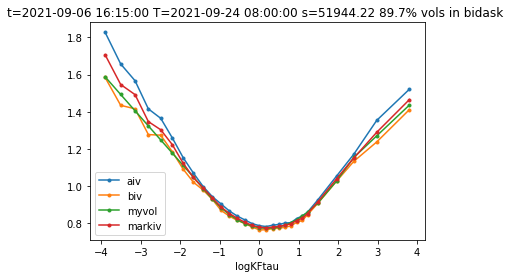

T=2021-09-24 08:00:00 t=2021-09-06 16:20:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


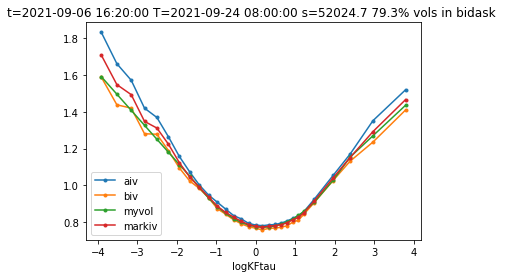

T=2021-09-24 08:00:00 t=2021-09-06 16:25:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


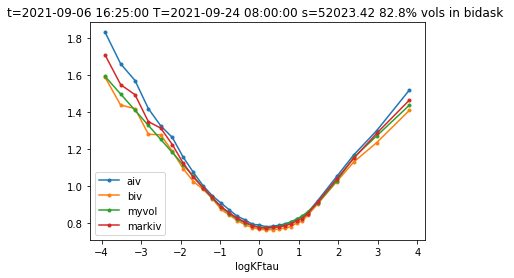

T=2021-09-24 08:00:00 t=2021-09-06 16:30:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


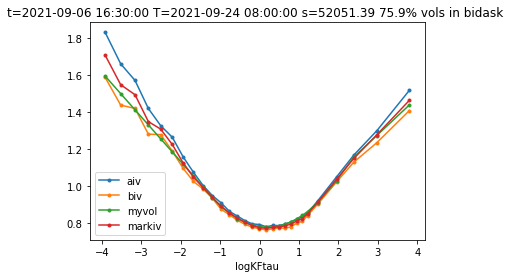

T=2021-09-24 08:00:00 t=2021-09-06 16:35:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


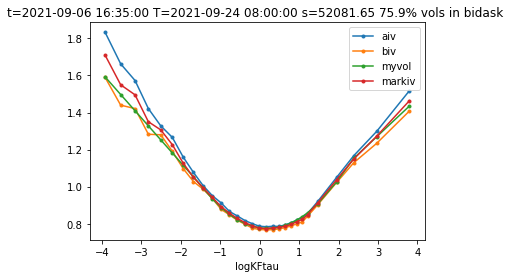

T=2021-09-24 08:00:00 t=2021-09-06 16:40:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


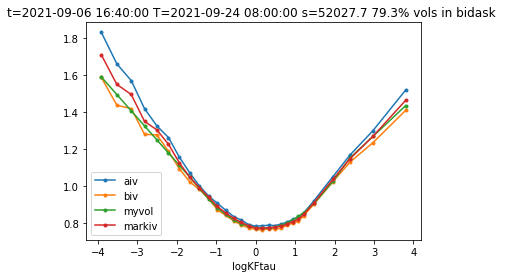

T=2021-09-24 08:00:00 t=2021-09-06 16:45:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


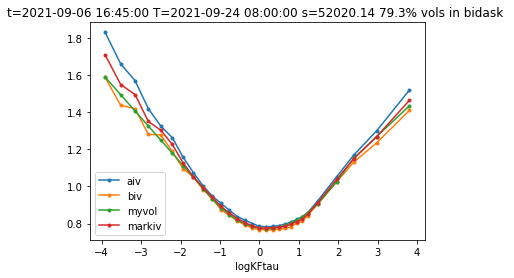

T=2021-09-24 08:00:00 t=2021-09-06 16:50:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


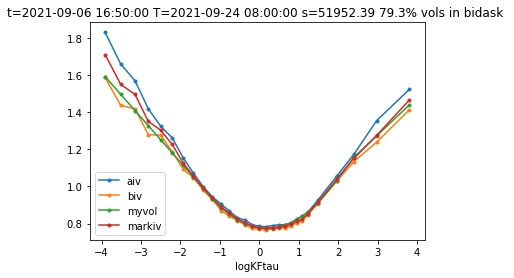

T=2021-09-24 08:00:00 t=2021-09-06 16:55:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


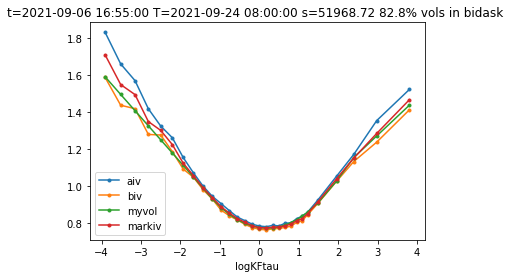

T=2021-09-24 08:00:00 t=2021-09-06 17:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


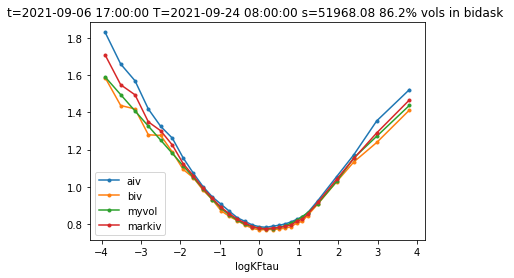

T=2021-09-24 08:00:00 t=2021-09-06 17:05:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


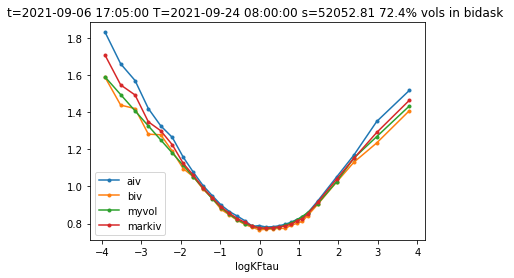

T=2021-09-24 08:00:00 t=2021-09-06 17:10:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


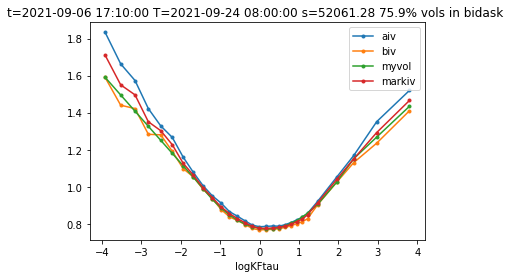

T=2021-09-24 08:00:00 t=2021-09-06 17:15:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


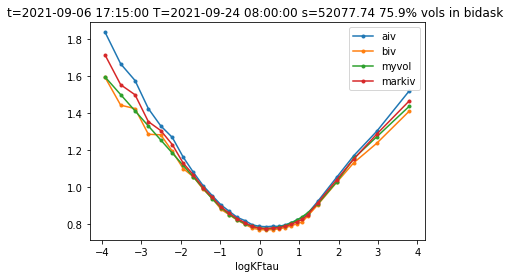

T=2021-09-24 08:00:00 t=2021-09-06 17:20:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


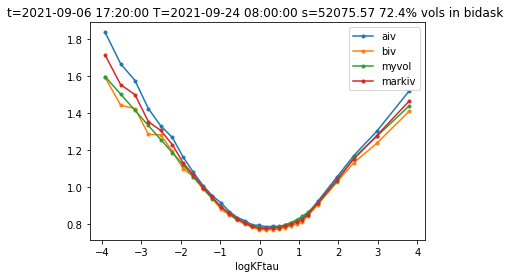

T=2021-09-24 08:00:00 t=2021-09-06 17:25:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


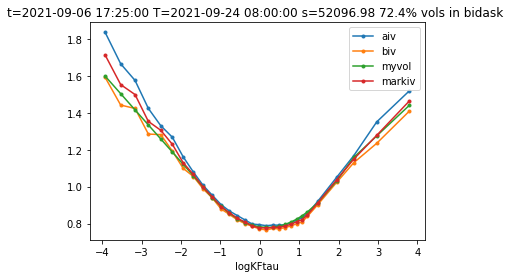

T=2021-09-24 08:00:00 t=2021-09-06 17:30:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


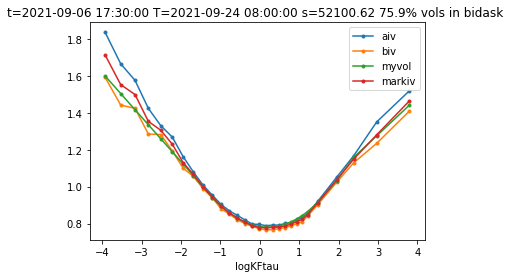

T=2021-09-24 08:00:00 t=2021-09-06 17:35:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


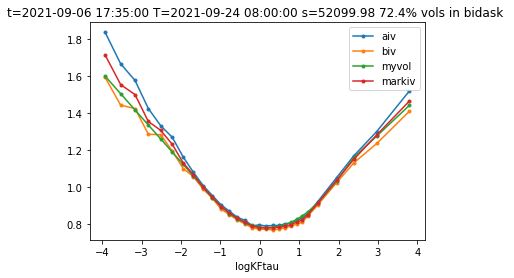

T=2021-09-24 08:00:00 t=2021-09-06 17:40:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


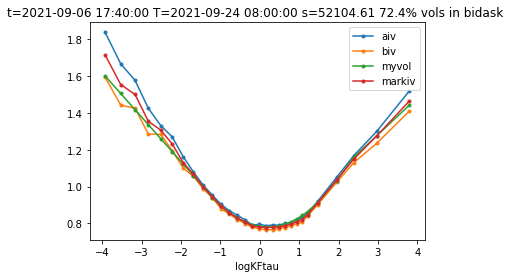

T=2021-09-24 08:00:00 t=2021-09-06 17:45:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


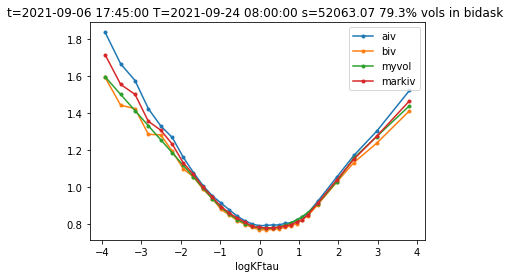

T=2021-09-24 08:00:00 t=2021-09-06 17:50:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


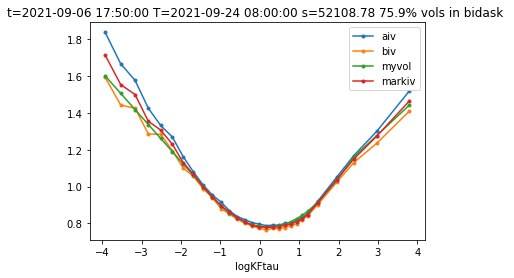

T=2021-09-24 08:00:00 t=2021-09-06 17:55:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


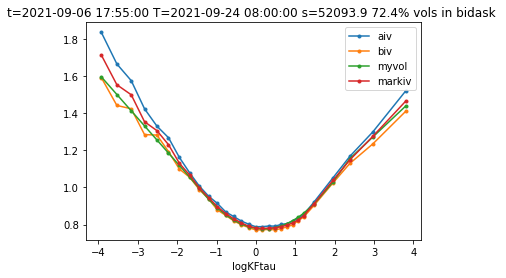

[{'t': Timestamp('2021-09-06 14:05:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.78118813875,
  's': 51959.07,
  'rr': -0.015197801737832028,
  'conv': 0.004933736276015899,
  'perc': 0.8620689655172413,
  'p0': -0.03214854393754286,
  'p1': 0.08174553255074808,
  'p2': 0.2,
  'p3': -0.24088046759541845},
 {'t': Timestamp('2021-09-06 14:10:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.790840642,
  's': 52074.09,
  'rr': -0.015112611973525647,
  'conv': 0.004942072641796247,
  'perc': 0.7241379310344828,
  'p0': -0.03214854393754286,
  'p1': 0.08174553255074808,
  'p2': 0.2,
  'p3': -0.24088046759541845},
 {'t': Timestamp('2021-09-06 14:15:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.787479467,
  's': 52118.46,
  'rr': -0.015068534218880547,
  'conv': 0.004934677229141093,
  'perc': 0.8620689655172413,
  'p0': -0.03214854393754286,
  'p1': 0.08174553255074808,
  'p2': 0.2,
  'p3': -0.24088046759541845},
 {'t': Timestamp('2021-09-06 14:20:00'

In [32]:
#backtest dynamic
def dynamic_errfunc_parabolic_linear4(x,usevega=False,df=None,PRICECALL=False,plot=0,Ref=None,SSR=None,volRef=None,info="",**kwargs): #left skew and right skew
    #print(f"plot={plot}")
    figsflask=not isnotebook()
    res={}
    figs=[]
    skew=x[0]
    conv=x[1]
    rightwing=x[2]
    leftwing=x[3]
    df['m']=0.5*(df['aiv']+df['biv'])
    S=df['s'].iloc[0]
    try:
        volATM=interp1d(df.index, df['m'])([S])[0]
    except Exception as e:
        print(str(e))
        print('dfindex',df.index)
        print('dfm',df['m'])
        resprice={'rr':np.nan,'conv':np.nan,'volATM':np.nan,'err':str(e)}
        if PRICECALL:
            if plot>2:
                img=plotstart()
                plt.figure(figsize=(4,4))
                plt.text(0.1,0.9,f'{str(e)} {info}')
                resprice['figs']=[plotend(img)]
            return resprice
        return 0
    #display(df)
    kright=kwargs['kright']
    kleft=kwargs['kleft']
    
    df.loc[(df.logKFtau>0)&(df.logKFtau<kright),'myvol']=volATM+(skew*df['logKFtau']+conv*df['logKFtau']**2)
    
#     xright=df.loc[(df.logKFtau>0)&(df.logKFtau<kright)].iloc[-1]['logKFtau']
#     yright=df.loc[(df.logKFtau>0)&(df.logKFtau<kright),'myvol'].iloc[-1]
    
    #print(f'xright={xright} yright={yright}')
       
    df.loc[(df.logKFtau<0)&(df.logKFtau>kleft),'myvol']=volATM+(skew*df['logKFtau']+conv*df['logKFtau']**2)
    
#     xleft=df.loc[(df.logKFtau<0)&(df.logKFtau>kleft)].iloc[-1]['logKFtau']
#     yleft=df.loc[(df.logKFtau<0)&(df.logKFtau>kleft),'myvol'].iloc[-1]
    
            
    #wings
#     df.loc[(df.logKFtau>kright),'myvol']=rightwing*(df['logKFtau']-xright)+yright
#     df.loc[(df.logKFtau<kleft),'myvol']=leftwing*(df['logKFtau']-xleft)+yleft

    yright=volATM+(skew*kright+conv*kright**2)
    yleft=volATM+(skew*kleft+conv*kleft**2)
    
    df.loc[(df.logKFtau>kright),'myvol']=rightwing*(df['logKFtau']-kright)+yright
    df.loc[(df.logKFtau<kleft),'myvol']=leftwing*(df['logKFtau']-kleft)+yleft
    
    
    
    df['insidebidask']=False
    df.loc[(df.myvol>df.biv)&(df.myvol<df.aiv),'insidebidask']=True
    if PRICECALL and plot>2:
                
        
#         df[['aiv','biv','myvol','markiv']].plot(title=f"{info} s={S} {df['insidebidask'].sum()/len(df):.1%} vols in bidask " ,style='.-')
#         plt.show()
#         plt.figure(figsize=(5,5))
        df[['aiv','biv','myvol','markiv','logKFtau']].set_index('logKFtau').plot(title=f"{info} s={S} {df['insidebidask'].sum()/len(df):.1%} vols in bidask " ,style='.-')
        plt.show()
    res=(df['myvol']-df['m'])**2 
    if usevega:
        res*=df['vega']
        ws=np.ones(len(df))
        df['w']=np.ones(len(df))
        df.loc[df['logKFtau']>2,'w']=0
        df.loc[df['logKFtau']<-2,'w']=0
        res*=df['w']
    if PRICECALL:
        resprice={'volATM':volATM}
        resprice['perc']=df['insidebidask'].sum()/len(df)
        try:
            volp5=interp1d(df.index,df['myvol'])([S*(1.05)])[0]
            volm5=interp1d(df.index,df['myvol'])([S*(0.95)])[0]
            skew=volp5-volm5 #risk reversal 5%
            conv=0.5*(volp5+volm5)-volATM #butterfly 
            resprice['rr']=skew
            resprice['conv']=conv
        except Exception as e:
            resprice['rr']=np.nan
            resprice['conv']=np.nan
            print(f"!volfit {str(e)}")

        if plot:
            resprice['figs']=figs
        return resprice
    return res.sum() 


def dynamic_volfit(df,plot=False,model='errfunc_parabolic_linear2',dynamic=False,Ref=10,SSR=0,**kwargs):
    
    figsflask=not isnotebook()
    #res={}
    figs=[]
    ts=df.index.get_level_values('tm').drop_duplicates()
    #ts=ts[:Nts] if Nts else ts
#    ipdb.set_trace()
    res=[]
    dynamic_fit_res=None
    for t in ts:
        dft=df.loc[[t]].droplevel('tm')
        Ts=dft.index.get_level_values('expire').drop_duplicates()
     #   Ts=Ts[:NTs] if NTs else Ts
        for T in Ts:
            dftT=dft.loc[[T]].droplevel('expire').drop_duplicates()
            
            tau=(T-t)/pd.to_timedelta(1, unit='D')/365
            dftT['logKFtau']=np.log(dftT.index/dftT['s'])/np.sqrt(tau)
            S=dftT['s'].iloc[0]
            dftTOTM=dftT[((dftT.ty==1)&(S<dftT.index))|((dftT.ty==-1)&(S>dftT.index))]
            if len(dftTOTM)==0:
                continue
            #after this can be empy cuz all ITM
            print(f"T={T} t={t}")
            #display(dft.loc[[T]])
            #display(dftTOTM)
            #dftTOTM[['aiv','biv']].plot(title=f' t={t} T={T} S={S}',style='o')
            usevega=True
            #lookup initvals from res df , if exist
            prevparams=[0.2,0.2,0.2,-0.2] if model[-1]=='4' else [0.2]*int(model[-1])
            print(f"prevparams={prevparams} model={model}")
            if (dynamic_fit_res is None and dynamic) or dynamic is False:
                minres = minimize(partial(eval(model),usevega=usevega,df=dftTOTM,PRICECALL=False,stats=False,plot=False,kleft=kwargs['kleft'],kright=kwargs['kright']), prevparams, method='L-BFGS-B', options={'eps': 1e-09, 'maxfun': 100, 'maxiter': 100})
                print("\nfitting finish..")
                dynamic_fit_res=minres.x
            else:
                pass
            #minres = minimize(partial(errfunc_parabolic_linear1,usevega=usevega,df=dftTOTM,PRICECALL=False,plot=False,kleft=-2,kright=2), [0.2,0.2,0.01,0.01,0.2,-0.2], method='L-BFGS-B', options={'eps': 1e-08, 'maxfun': 100, 'maxiter': 100})
            #TODO: put previous params as initial guess fot t+1, same T
            print(f"optimized params:{minres.x}")
            
            plotres=partial(eval(model),usevega=usevega,df=dftTOTM,PRICECALL=True,plot=plot,info=f't={t} T={T}',kleft=kwargs['kleft'],kright=kwargs['kright'])(dynamic_fit_res)
            if plot:
                figs.extend(plotres['figs'])
            resd={'t':t,'T':T,'volATM':plotres['volATM'],'s':S,'rr':plotres['rr'],'conv':plotres['conv'],'perc':plotres['perc']}
            for i in range(len(dynamic_fit_res)):
                resd['p'+str(i)]=dynamic_fit_res[i]
            res.append(resd)
    return res

dynamic_volfit(df.query("tm >'2021-09-06 14:00:00' and tm< '2021-09-06 18:00:00' "),plot=3,model='errfunc_parabolic_linear4',dynamic=True,kleft=-1.5,kright=2.3)

In [33]:
# draw sigma ATM (spot)

T=2021-09-24 08:00:00 t=2021-09-06 14:05:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03214854  0.08174553  0.2        -0.24088047]


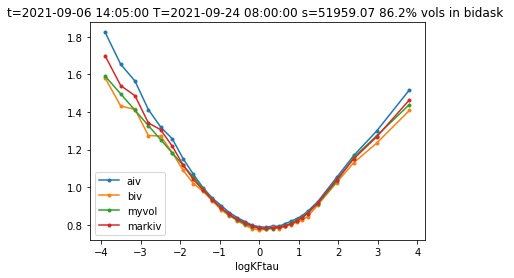

T=2021-09-24 08:00:00 t=2021-09-06 14:10:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.034799    0.07600916  0.2        -0.24654806]


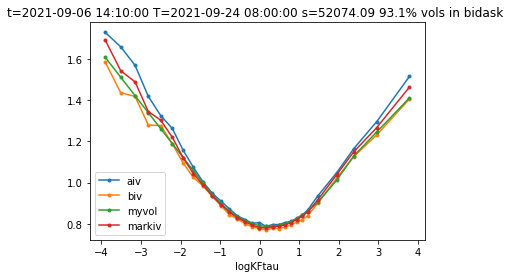

T=2021-09-24 08:00:00 t=2021-09-06 14:15:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03405054  0.07799652  0.2        -0.24935453]


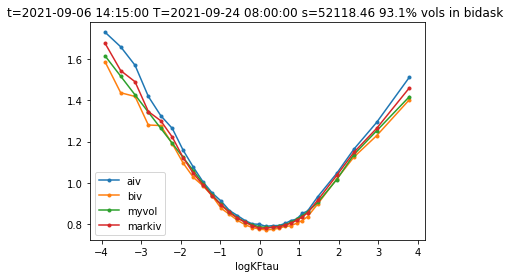

T=2021-09-24 08:00:00 t=2021-09-06 14:20:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03474927  0.0830986   0.2        -0.23838806]


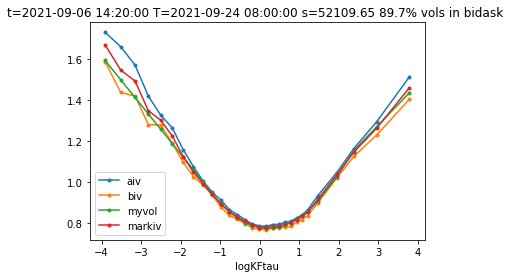

T=2021-09-24 08:00:00 t=2021-09-06 14:25:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03360352  0.08475807  0.2        -0.23589775]


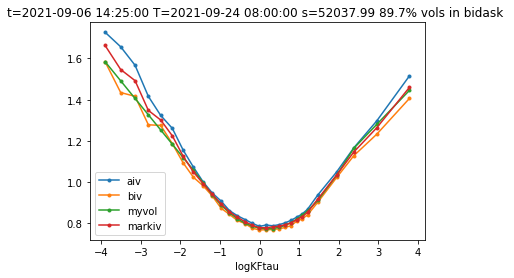

T=2021-09-24 08:00:00 t=2021-09-06 14:30:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03367392  0.08255383  0.2        -0.23879539]


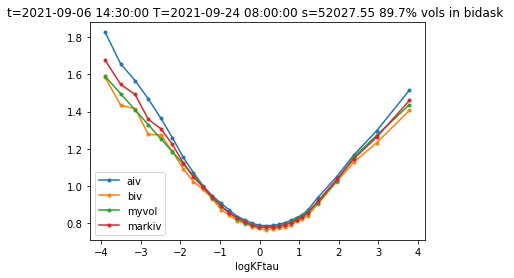

T=2021-09-24 08:00:00 t=2021-09-06 14:35:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03452062  0.08521613  0.2        -0.22836207]


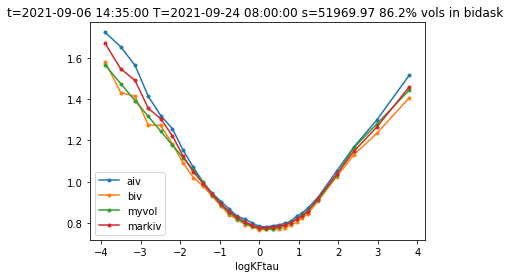

T=2021-09-24 08:00:00 t=2021-09-06 14:40:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03454869  0.08384293  0.2        -0.23128723]


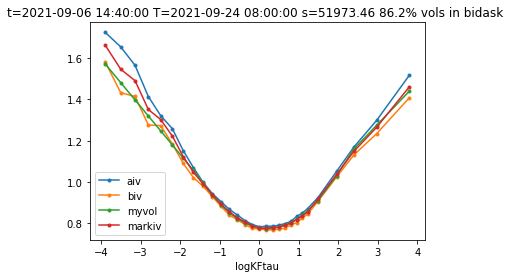

T=2021-09-24 08:00:00 t=2021-09-06 14:45:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03443985  0.08173661  0.2        -0.24106717]


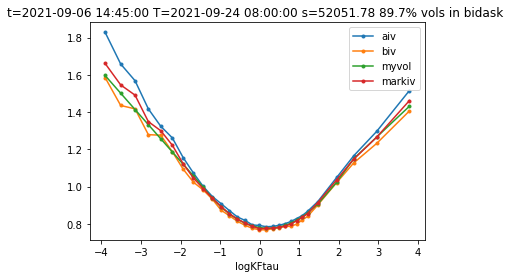

T=2021-09-24 08:00:00 t=2021-09-06 14:50:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03578611  0.08449262  0.2        -0.2315493 ]


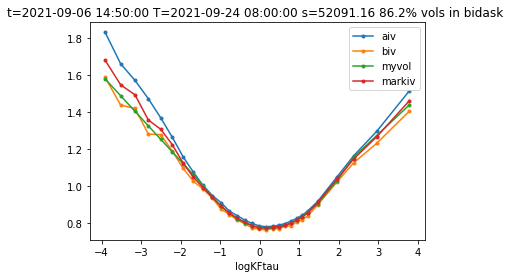

T=2021-09-24 08:00:00 t=2021-09-06 14:55:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03590433  0.0843789   0.2        -0.23284913]


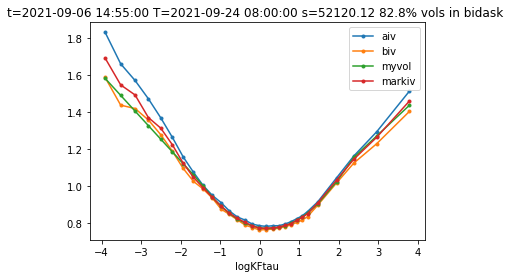

T=2021-09-24 08:00:00 t=2021-09-06 15:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03524946  0.0836555   0.2        -0.2347041 ]


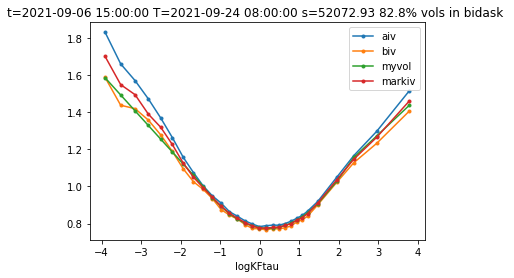

T=2021-09-24 08:00:00 t=2021-09-06 15:05:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.036161    0.08275662  0.2        -0.23743374]


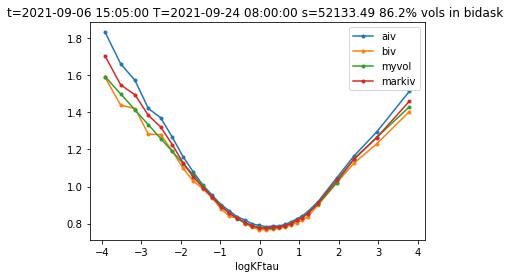

T=2021-09-24 08:00:00 t=2021-09-06 15:10:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03511607  0.08533723  0.2        -0.23660136]


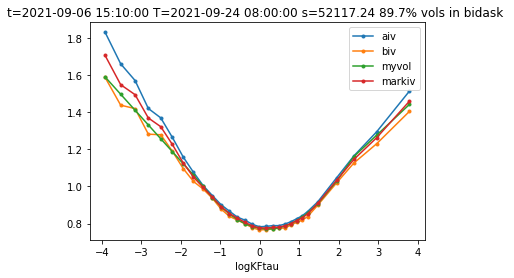

T=2021-09-24 08:00:00 t=2021-09-06 15:15:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03358708  0.08428028  0.2        -0.23866762]


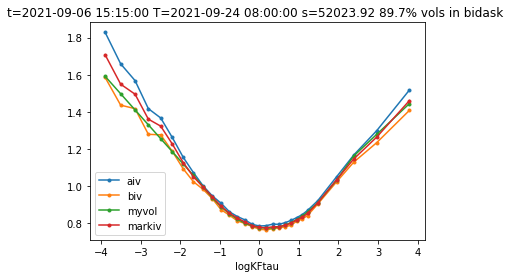

T=2021-09-24 08:00:00 t=2021-09-06 15:20:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03449143  0.08297987  0.2        -0.23939949]


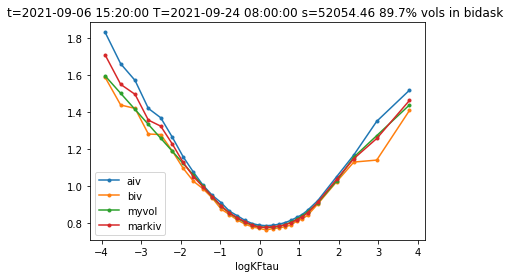

T=2021-09-24 08:00:00 t=2021-09-06 15:25:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03360879  0.08492904  0.2        -0.23856021]


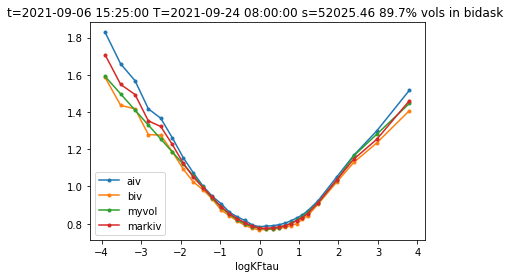

T=2021-09-24 08:00:00 t=2021-09-06 15:30:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03278522  0.08223213  0.2        -0.24512643]


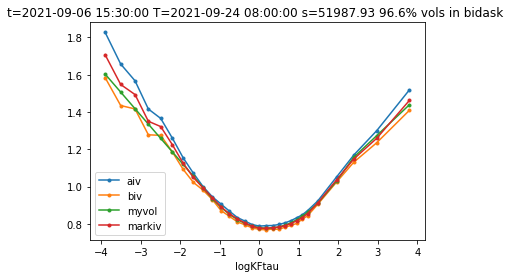

T=2021-09-24 08:00:00 t=2021-09-06 15:35:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03471619  0.08105213  0.2        -0.24319343]


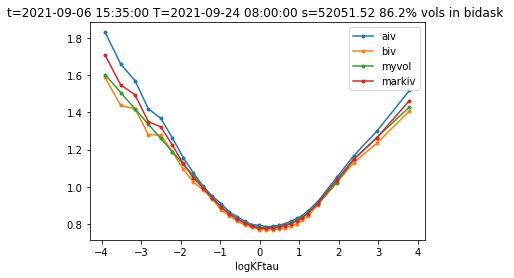

T=2021-09-24 08:00:00 t=2021-09-06 15:40:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03523502  0.08351434  0.2        -0.23967531]


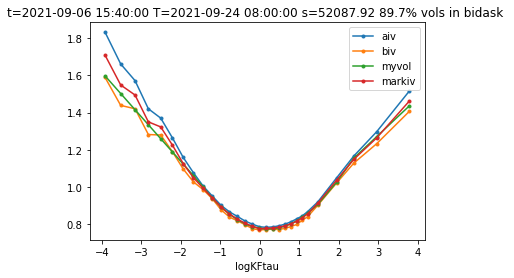

T=2021-09-24 08:00:00 t=2021-09-06 15:45:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03500769  0.08289589  0.2        -0.24276848]


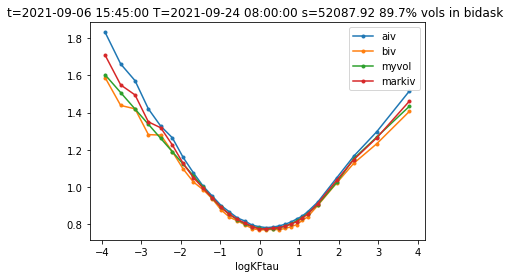

T=2021-09-24 08:00:00 t=2021-09-06 15:50:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03444156  0.08319935  0.2        -0.23972439]


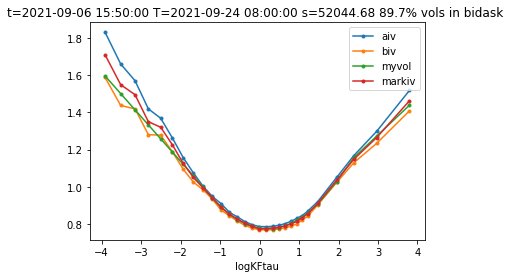

T=2021-09-24 08:00:00 t=2021-09-06 15:55:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03392109  0.08270169  0.2        -0.24149513]


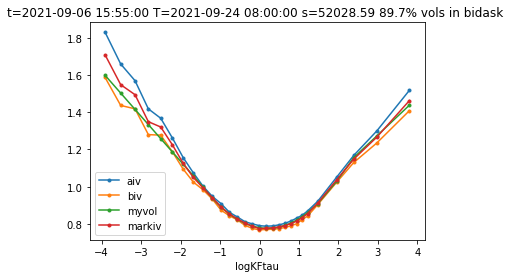

T=2021-09-24 08:00:00 t=2021-09-06 16:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03765533  0.08203788  0.2        -0.23867687]


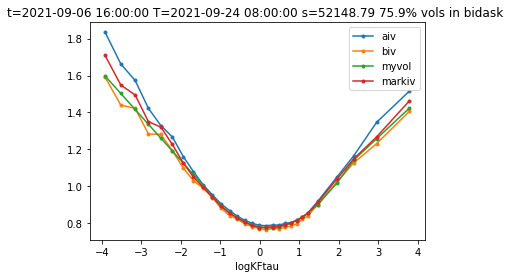

T=2021-09-24 08:00:00 t=2021-09-06 16:05:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03386901  0.07788412  0.2        -0.25229449]


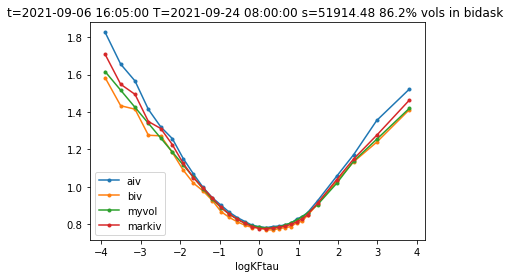

T=2021-09-24 08:00:00 t=2021-09-06 16:10:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03416862  0.07917524  0.2        -0.24858786]


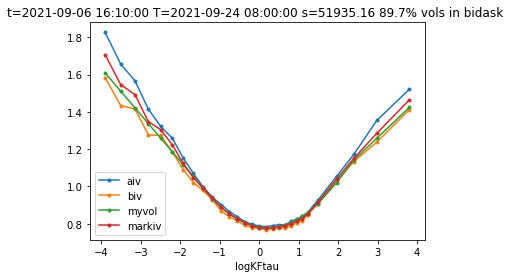

T=2021-09-24 08:00:00 t=2021-09-06 16:15:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03513212  0.08347177  0.2        -0.23446449]


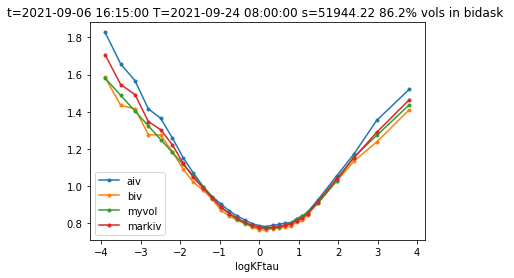

T=2021-09-24 08:00:00 t=2021-09-06 16:20:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.0374096   0.08360358  0.2        -0.22883629]


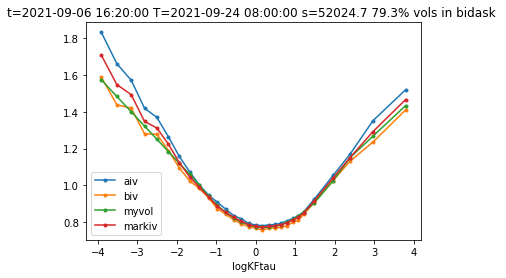

T=2021-09-24 08:00:00 t=2021-09-06 16:25:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03734533  0.08197758  0.2        -0.23286893]


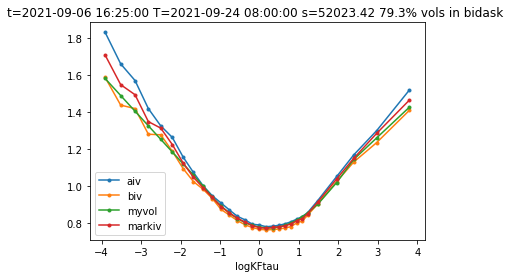

T=2021-09-24 08:00:00 t=2021-09-06 16:30:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03744562  0.08011685  0.2        -0.23933234]


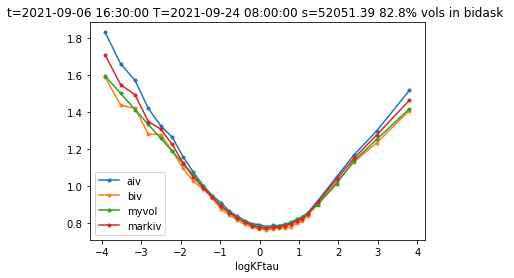

T=2021-09-24 08:00:00 t=2021-09-06 16:35:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03830134  0.08319039  0.2        -0.22906085]


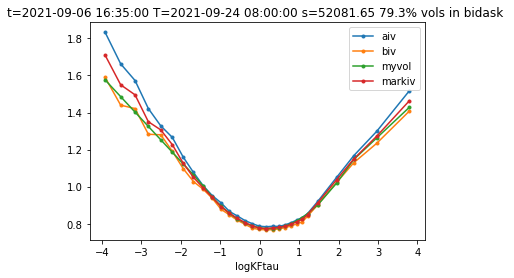

T=2021-09-24 08:00:00 t=2021-09-06 16:40:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03674025  0.08356813  0.2        -0.23196214]


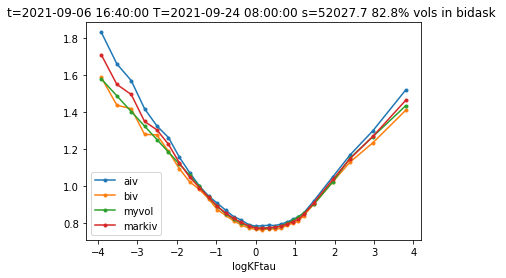

T=2021-09-24 08:00:00 t=2021-09-06 16:45:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03773347  0.08434383  0.2        -0.23646903]


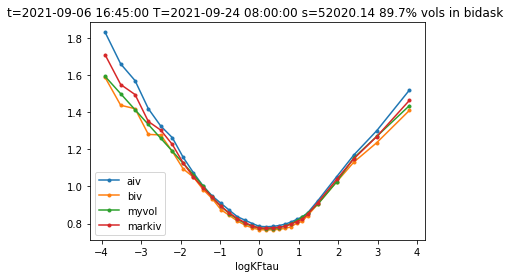

T=2021-09-24 08:00:00 t=2021-09-06 16:50:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.0356355   0.08267894  0.2        -0.24606219]


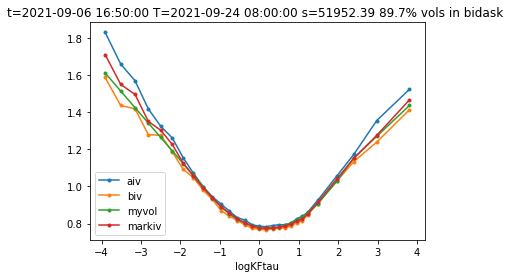

T=2021-09-24 08:00:00 t=2021-09-06 16:55:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03629276  0.08357986  0.2        -0.24188342]


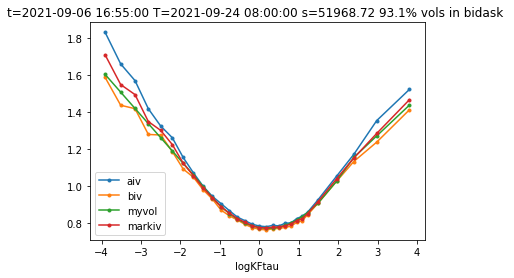

T=2021-09-24 08:00:00 t=2021-09-06 17:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03573244  0.0836476   0.2        -0.24382067]


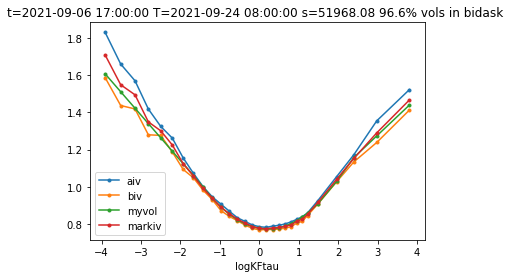

T=2021-09-24 08:00:00 t=2021-09-06 17:05:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03707797  0.08364354  0.2        -0.24488705]


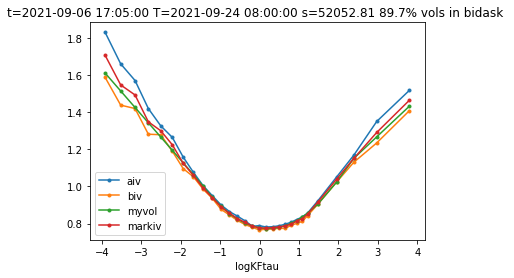

T=2021-09-24 08:00:00 t=2021-09-06 17:10:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03782758  0.08452509  0.2        -0.2409024 ]


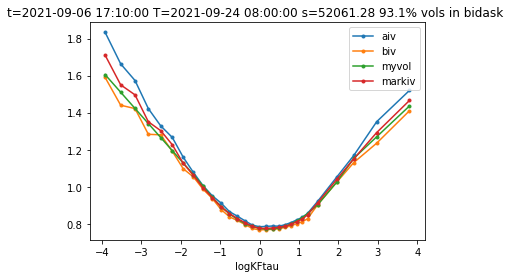

T=2021-09-24 08:00:00 t=2021-09-06 17:15:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03773564  0.0834107   0.2        -0.24389536]


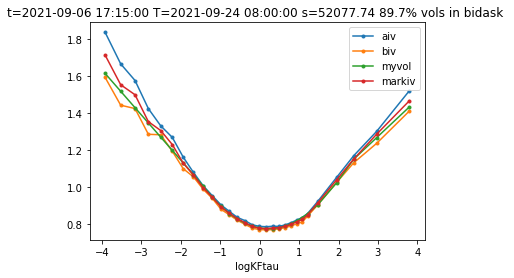

T=2021-09-24 08:00:00 t=2021-09-06 17:20:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03818024  0.08212865  0.2        -0.24290613]


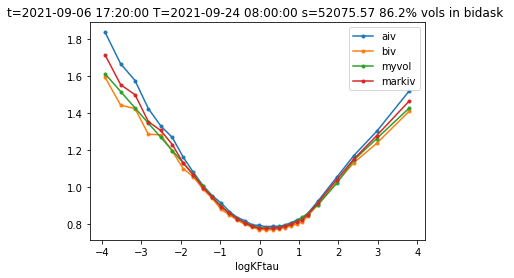

T=2021-09-24 08:00:00 t=2021-09-06 17:25:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03846225  0.08046802  0.2        -0.24670365]


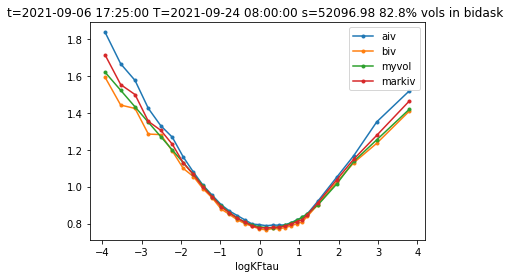

T=2021-09-24 08:00:00 t=2021-09-06 17:30:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03848879  0.08015848  0.2        -0.24740321]


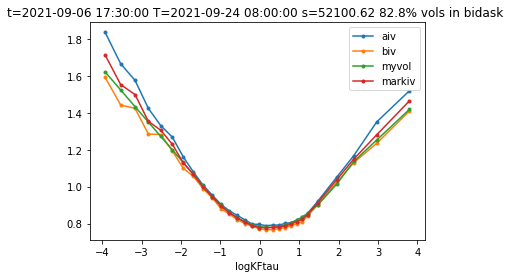

T=2021-09-24 08:00:00 t=2021-09-06 17:35:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03785082  0.08017599  0.2        -0.25105739]


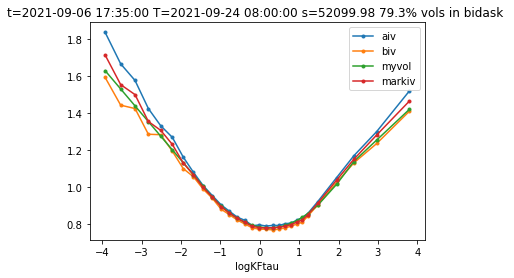

T=2021-09-24 08:00:00 t=2021-09-06 17:40:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03850547  0.0800003   0.2        -0.2479764 ]


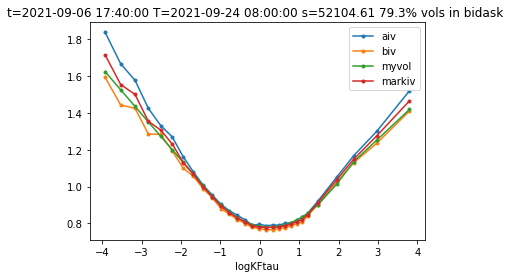

T=2021-09-24 08:00:00 t=2021-09-06 17:45:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03733586  0.08367777  0.2        -0.23947327]


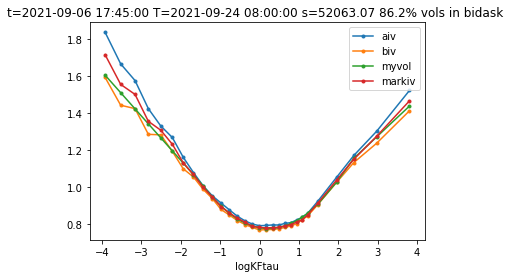

T=2021-09-24 08:00:00 t=2021-09-06 17:50:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03875955  0.08017427  0.2        -0.24420799]


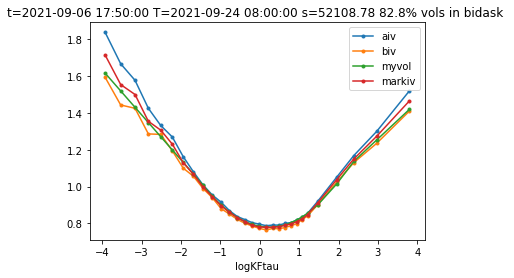

T=2021-09-24 08:00:00 t=2021-09-06 17:55:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4

fitting finish..
optimized params:[-0.03838037  0.08308844  0.2        -0.23855911]


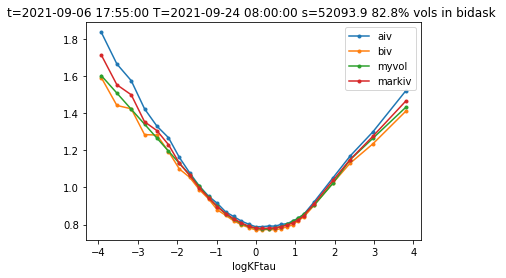

[{'t': Timestamp('2021-09-06 14:05:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.78118813875,
  's': 51959.07,
  'rr': -0.015197801737832028,
  'conv': 0.004933736276015899,
  'perc': 0.8620689655172413,
  'p0': -0.03214854393754286,
  'p1': 0.08174553255074808,
  'p2': 0.2,
  'p3': -0.24088046759541845},
 {'t': Timestamp('2021-09-06 14:10:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.790840642,
  's': 52074.09,
  'rr': -0.016279275142548455,
  'conv': 0.0046264920140255406,
  'perc': 0.9310344827586207,
  'p0': -0.034798995338922716,
  'p1': 0.07600916363088145,
  'p2': 0.2,
  'p3': -0.2465480631345179},
 {'t': Timestamp('2021-09-06 14:15:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.787479467,
  's': 52118.46,
  'rr': -0.015910029068312848,
  'conv': 0.004729916156303027,
  'perc': 0.9310344827586207,
  'p0': -0.03405053999015455,
  'p1': 0.07799651775199702,
  'p2': 0.2,
  'p3': -0.2493545266162845},
 {'t': Timestamp('2021-09-06 14:20:00'

In [31]:
#atm vol gets recalculated, F gets updated

# should we have volATM = function of spot only  like in orc vc=
# The current volatility (vc) at central skew point (Ref is reference price).
# vc = vr - VCR * SSR * (F - Ref) / Ref
# F =(ATM)^SSR *  (ref)^(1-SSR)

dynamic_volfit(df.query("tm >'2021-09-06 14:00:00' and tm< '2021-09-06 18:00:00' "),plot=3,model='errfunc_parabolic_linear4',dynamic=False,kleft=-1.5,kright=2.3)

In [162]:
volfit(df.query("tm >'2021-09-07 00:00' and tm <'2021-09-07 00:10'"),plot=0,model='errfunc_parabolic_linear4',kleft=kleft,kright=kright)

T=2021-09-24 08:00:00 t=2021-09-07 00:05:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03469844  0.07407787  0.18485573 -0.26888471]


[{'t': Timestamp('2021-09-07 00:05:00'),
  'T': Timestamp('2021-09-24 08:00:00'),
  'volATM': 0.79599117,
  's': 53182.34,
  'rr': -0.016617058912285265,
  'conv': 0.004404130017126029,
  'perc': 0.896551724137931,
  'p0': -0.034698441644094094,
  'p1': 0.07407787495252861,
  'p2': 0.18485573446468212,
  'p3': -0.2688847084533852}]

In [168]:
dfs=[]
for kleft in np.linspace(-1,-4,10):
    for kright in np.linspace(1,4,10):
        df1=DF(volfit(df,plot=0,model='errfunc_parabolic_linear4',kleft=kleft,kright=kright)) #.query("tm >'2021-09-07 00:00' and tm <'2021-09-07 00:10'")
        df1['kleft']=kleft
        df1['kright']=kright
        dfs.append(df1)  #.query("tm >'2021-07-01 00:00' and tm <'2021-07-01 23:50'"

T=2021-09-24 08:00:00 t=2021-09-07 00:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03409929  0.07213353  0.18486427 -0.26485661]
T=2021-09-24 08:00:00 t=2021-09-07 00:05:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03469844  0.07407787  0.18485573 -0.26888471]
T=2021-09-24 08:00:00 t=2021-09-07 00:10:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03312959  0.07520215  0.18394198 -0.26730084]
T=2021-09-24 08:00:00 t=2021-09-07 00:15:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.034605    0.08015455  0.18289126 -0.25466742]
T=2021-09-24 08:00:00 t=2021-09-07 00:20:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03705101  0.07490338  0.19373513 -0.25911619]
T=2021-09-24 08:00:00 t=2021-09-07 00:25:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized p

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [171]:
pd.concat(dfs)

,t,T,volATM,s,rr,conv,perc,p0,p1,p2,p3,kleft,kright
0,2021-09-07 00:00:00,2021-09-24 08:00:00,0.79882321,53104.4,-0.01632492387,0.004356670243,0.8965517241,-0.0340992866,0.07213352563,0.1848642653,-0.2648566115,-1,1
1,2021-09-07 00:05:00,2021-09-24 08:00:00,0.79599117,53182.34,-0.01661705891,0.004404130017,0.8965517241,-0.03469844164,0.07407787495,0.1848557345,-0.2688847085,-1,1
2,2021-09-07 00:10:00,2021-09-24 08:00:00,0.795764568,53097.12,-0.01585087101,0.0045051872,0.8965517241,-0.03312959092,0.0752021544,0.1839419819,-0.2673008436,-1,1
3,2021-09-07 00:15:00,2021-09-24 08:00:00,0.793967824,53011.14,-0.01642793986,0.004797241774,0.8275862069,-0.03460499966,0.08015455376,0.1828912551,-0.2546674188,-1,1
4,2021-09-07 00:20:00,2021-09-24 08:00:00,0.7933459215,52899.03,-0.01734217382,0.004496214051,0.8275862069,-0.03705100538,0.07490338185,0.1937351309,-0.2591161918,-1,1
5,2021-09-07 00:25:00,2021-09-24 08:00:00,0.793781325,52914.75,-0.01679086621,0.004484864482,0.7931034483,-0.03578602672,0.07468249898,0.1915707125,-0.2587221336,-1,1
6,2021-09-07 00:30:00,2021-09-24 08:00:00,0.793724719,52908.36,-0.01632914303,0.004505262982,0.7931034483,-0.03479374855,0.0751466668,0.1900912678,-0.2595350681,-1,1
7,2021-09-07 00:35:00,2021-09-24 08:00:00,0.7908474937,52895.75,-0.0168894818,0.004540411022,0.8275862069,-0.03608360497,0.07580367232,0.1918189418,-0.2571773663,-1,1
8,2021-09-07 00:40:00,2021-09-24 08:00:00,0.793856974,52821.71,-0.0160264719,0.004463194505,0.7931034483,-0.03424028917,0.07399736245,0.1889469351,-0.2588930295,-1,1
9,2021-09-07 00:45:00,2021-09-24 08:00:00,0.7924610787,52903.79,-0.01709260586,0.004516442129,0.7586206897,-0.03645737175,0.07515887959,0.1901684671,-0.2587788287,-1,1


In [203]:
1

1

In [ ]:
1

In [186]:

df1=pd.concat(dfs)#.query("t=='2021-09-07 00:00:00'")

2021-09-07T00:00:00.000000000


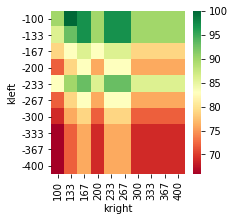

2021-09-07T00:05:00.000000000


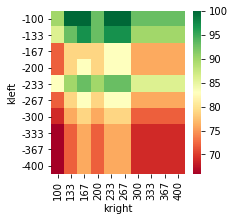

2021-09-07T00:10:00.000000000


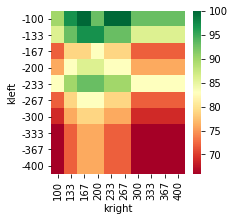

2021-09-07T00:15:00.000000000


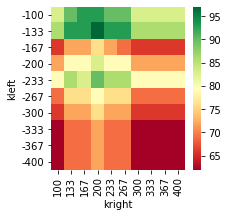

2021-09-07T00:20:00.000000000


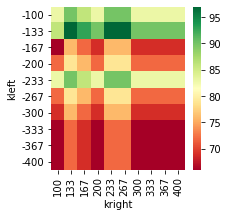

2021-09-07T00:25:00.000000000


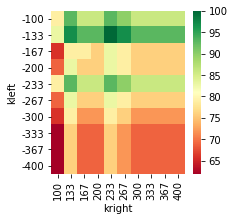

2021-09-07T00:30:00.000000000


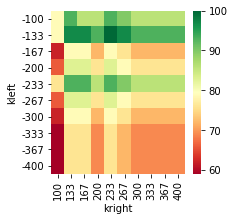

2021-09-07T00:35:00.000000000


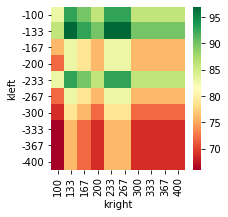

2021-09-07T00:40:00.000000000


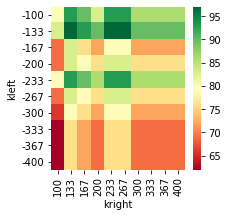

2021-09-07T00:45:00.000000000


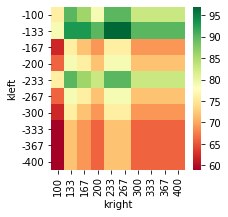

2021-09-07T00:50:00.000000000


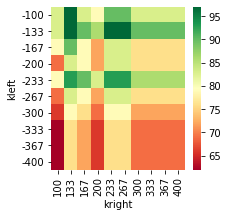

2021-09-07T00:55:00.000000000


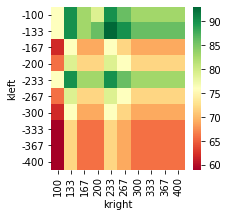

2021-09-07T01:00:00.000000000


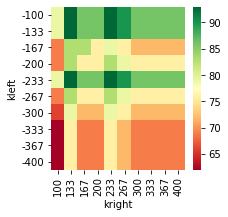

2021-09-07T01:05:00.000000000


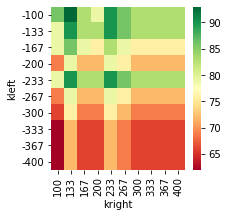

2021-09-07T01:10:00.000000000


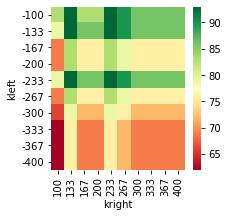

2021-09-07T01:15:00.000000000


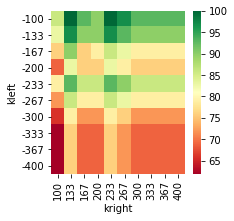

2021-09-07T01:20:00.000000000


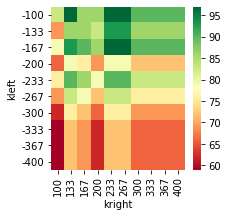

2021-09-07T01:25:00.000000000


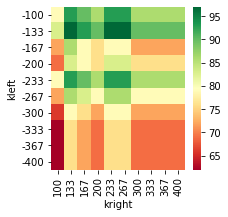

2021-09-07T01:30:00.000000000


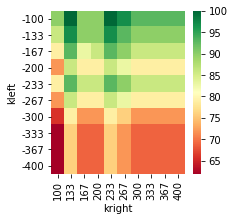

2021-09-07T01:35:00.000000000


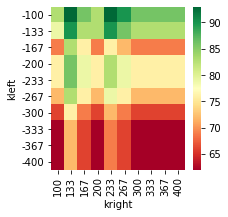

2021-09-07T01:40:00.000000000


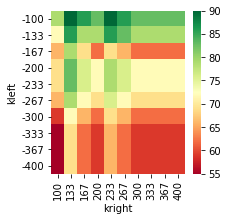

2021-09-07T01:45:00.000000000


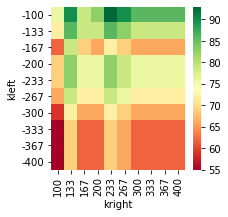

2021-09-07T01:50:00.000000000


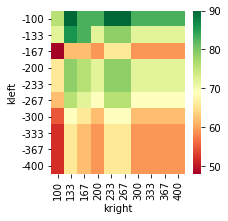

2021-09-07T01:55:00.000000000


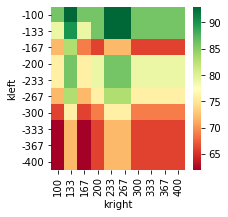

2021-09-07T02:00:00.000000000


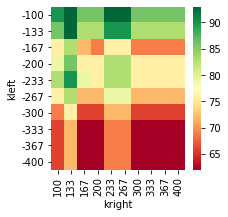

2021-09-07T02:05:00.000000000


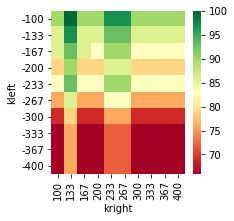

2021-09-07T02:10:00.000000000


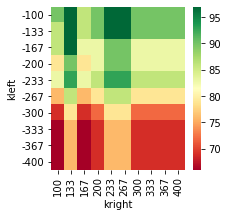

2021-09-07T02:15:00.000000000


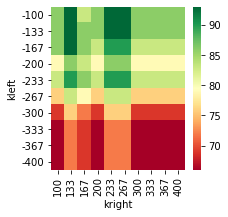

2021-09-07T02:20:00.000000000


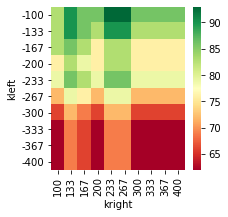

2021-09-07T02:25:00.000000000


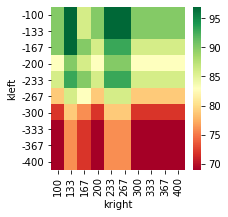

2021-09-07T02:30:00.000000000


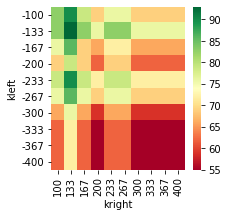

2021-09-07T02:35:00.000000000


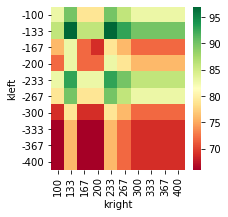

2021-09-07T02:40:00.000000000


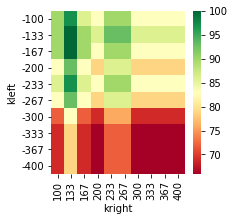

2021-09-07T02:45:00.000000000


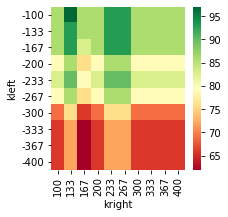

2021-09-07T02:50:00.000000000


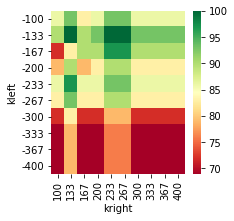

2021-09-07T02:55:00.000000000


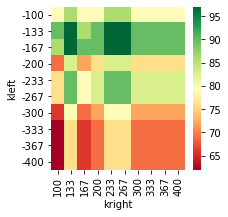

2021-09-07T03:00:00.000000000


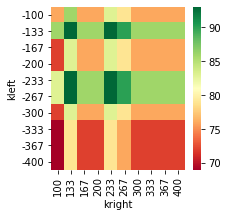

2021-09-07T03:05:00.000000000


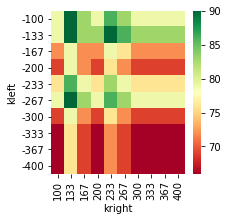

2021-09-07T03:10:00.000000000


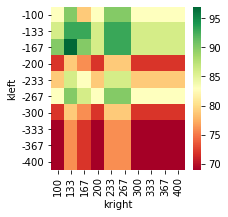

2021-09-07T03:15:00.000000000


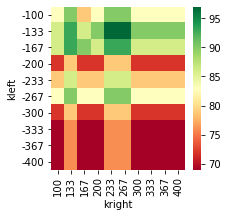

2021-09-07T03:20:00.000000000


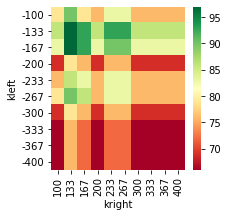

2021-09-07T03:25:00.000000000


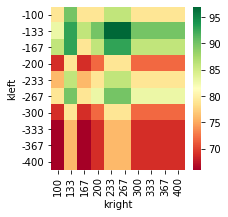

2021-09-07T03:30:00.000000000


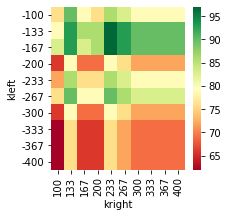

2021-09-07T03:35:00.000000000


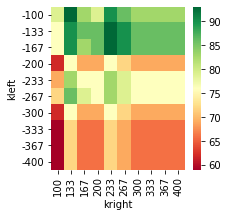

2021-09-07T03:40:00.000000000


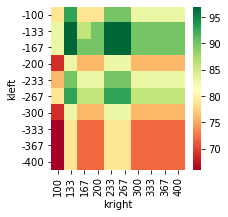

2021-09-07T03:45:00.000000000


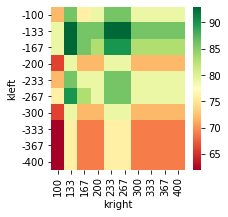

2021-09-07T03:50:00.000000000


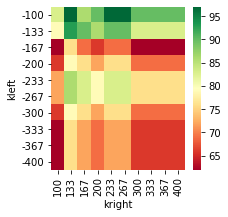

2021-09-07T03:55:00.000000000


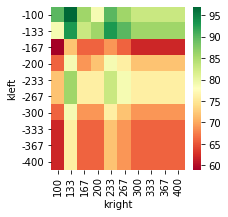

2021-09-07T04:00:00.000000000


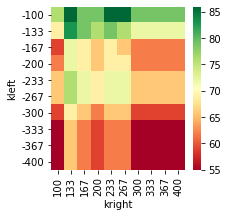

2021-09-07T04:05:00.000000000


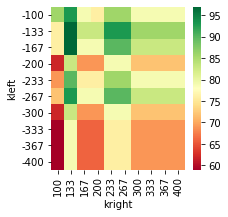

2021-09-07T04:10:00.000000000


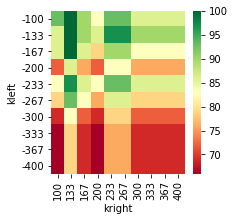

2021-09-07T04:15:00.000000000


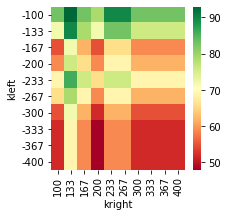

2021-09-07T04:20:00.000000000


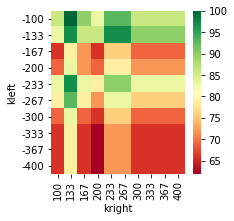

2021-09-07T04:25:00.000000000


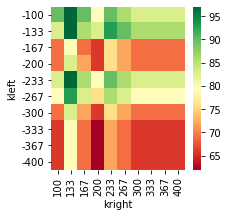

2021-09-07T04:30:00.000000000


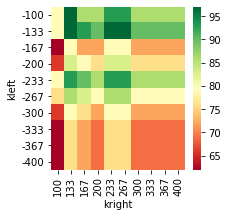

2021-09-07T04:35:00.000000000


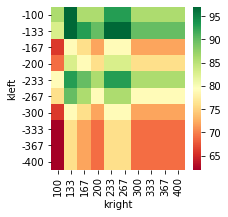

2021-09-07T04:40:00.000000000


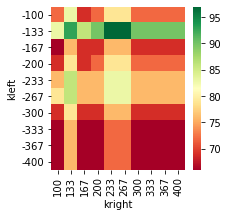

2021-09-07T04:45:00.000000000


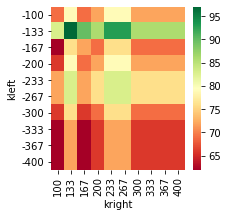

2021-09-07T04:50:00.000000000


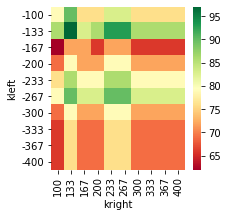

2021-09-07T04:55:00.000000000


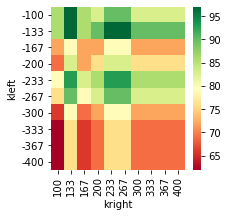

2021-09-07T05:00:00.000000000


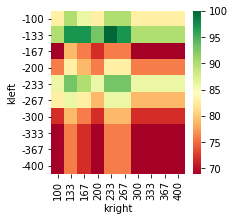

2021-09-07T05:05:00.000000000


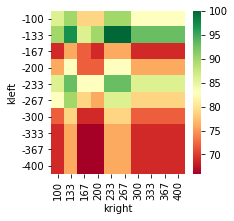

2021-09-07T05:10:00.000000000


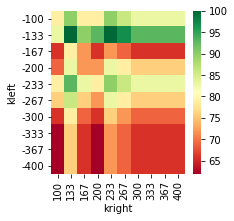

2021-09-07T05:15:00.000000000


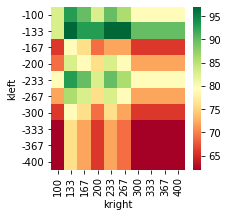

2021-09-07T05:20:00.000000000


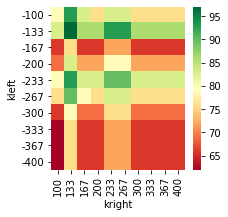

2021-09-07T05:25:00.000000000


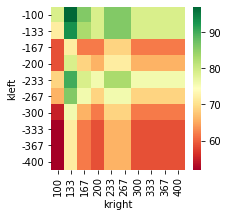

2021-09-07T05:30:00.000000000


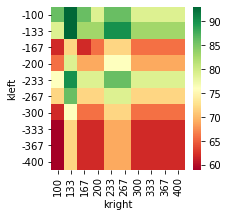

2021-09-07T05:35:00.000000000


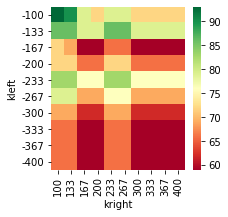

2021-09-07T05:40:00.000000000


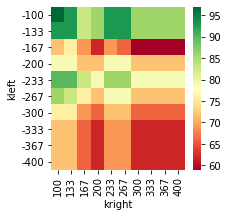

2021-09-07T05:45:00.000000000


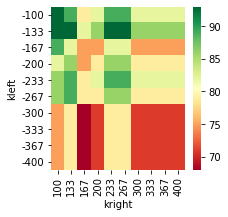

2021-09-07T05:50:00.000000000


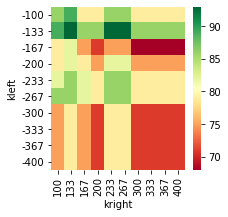

2021-09-07T05:55:00.000000000


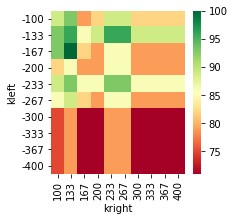

2021-09-07T06:00:00.000000000


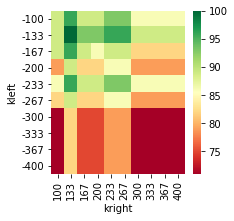

2021-09-07T06:05:00.000000000


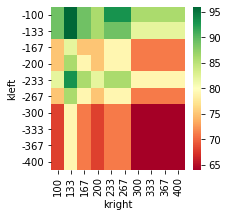

2021-09-07T06:10:00.000000000


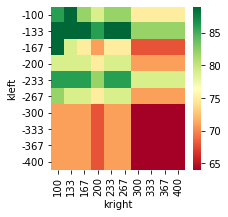

2021-09-07T06:15:00.000000000


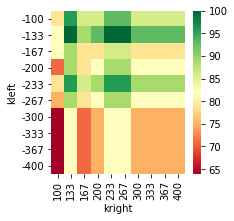

2021-09-07T06:20:00.000000000


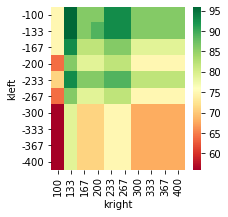

2021-09-07T06:25:00.000000000


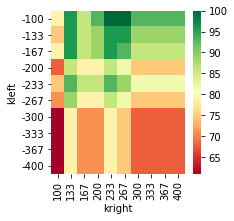

2021-09-07T06:30:00.000000000


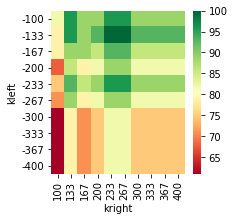

2021-09-07T06:35:00.000000000


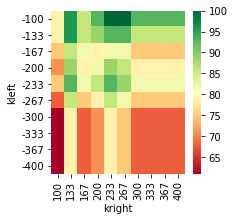

2021-09-07T06:40:00.000000000


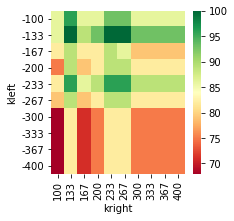

2021-09-07T06:45:00.000000000


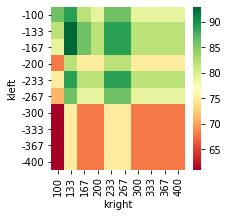

2021-09-07T06:50:00.000000000


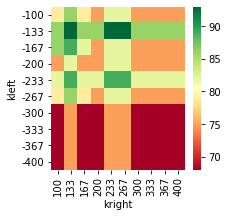

2021-09-07T06:55:00.000000000


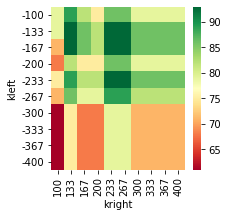

2021-09-07T07:00:00.000000000


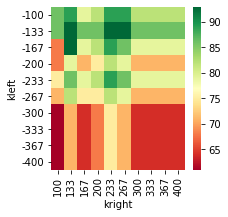

2021-09-07T07:05:00.000000000


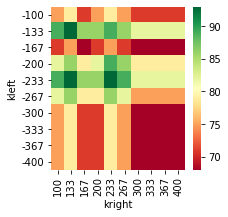

2021-09-07T07:10:00.000000000


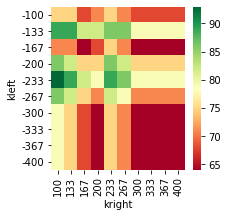

2021-09-07T07:15:00.000000000


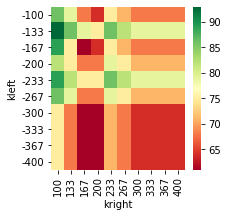

2021-09-07T07:20:00.000000000


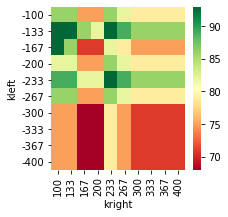

2021-09-07T07:25:00.000000000


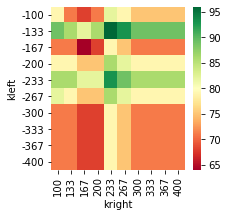

2021-09-07T07:30:00.000000000


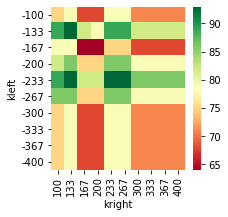

2021-09-07T07:35:00.000000000


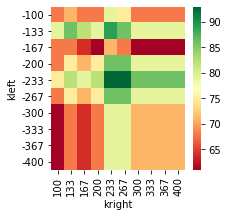

2021-09-07T07:40:00.000000000


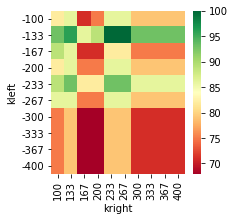

2021-09-07T07:45:00.000000000


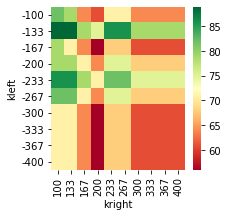

2021-09-07T07:50:00.000000000


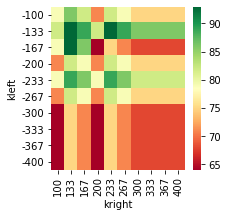

2021-09-07T07:55:00.000000000


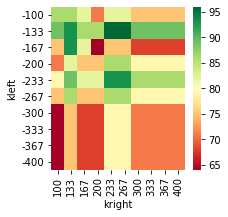

2021-09-07T08:00:00.000000000


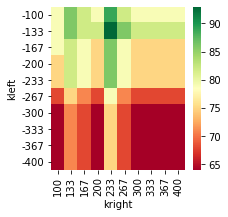

2021-09-07T08:05:00.000000000


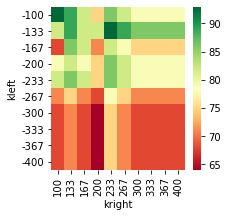

2021-09-07T08:10:00.000000000


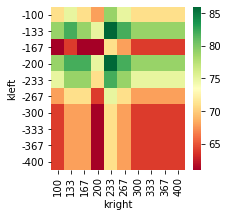

2021-09-07T08:15:00.000000000


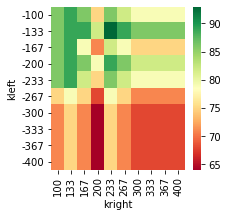

2021-09-07T08:20:00.000000000


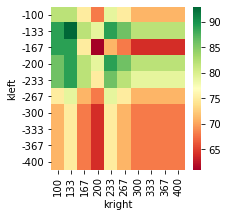

2021-09-07T08:25:00.000000000


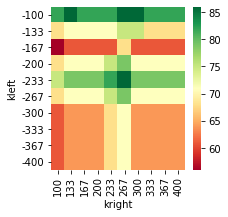

2021-09-07T08:30:00.000000000


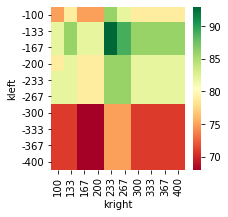

2021-09-07T08:35:00.000000000


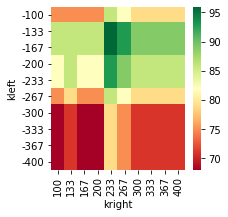

2021-09-07T08:40:00.000000000


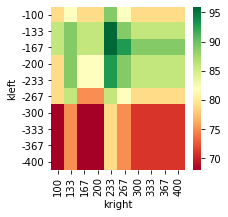

2021-09-07T08:45:00.000000000


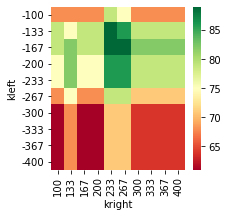

2021-09-07T08:50:00.000000000


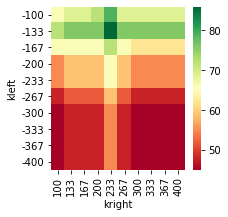

2021-09-07T08:55:00.000000000


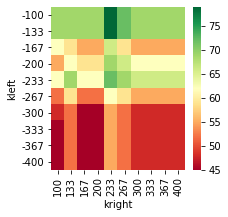

2021-09-07T09:00:00.000000000


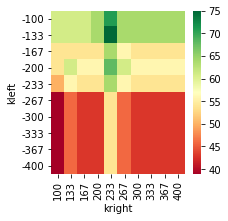

2021-09-07T09:05:00.000000000


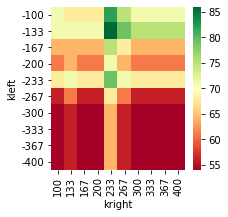

2021-09-07T09:10:00.000000000


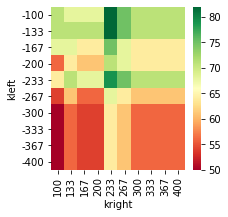

2021-09-07T09:15:00.000000000


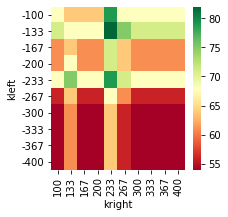

2021-09-07T09:20:00.000000000


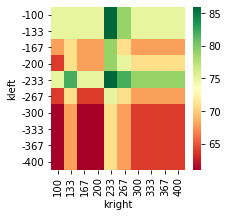

2021-09-07T09:25:00.000000000


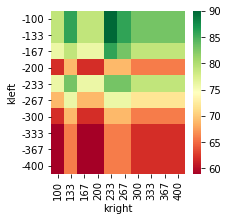

2021-09-07T09:30:00.000000000


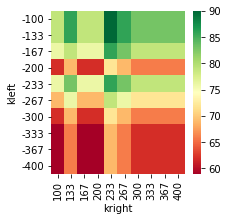

2021-09-07T09:35:00.000000000


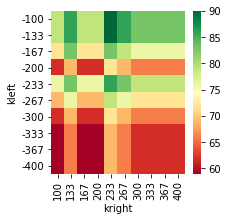

2021-09-07T09:40:00.000000000


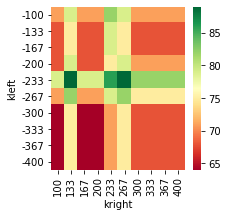

2021-09-07T09:45:00.000000000


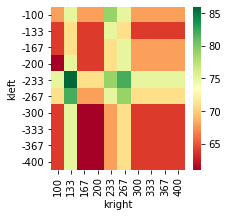

2021-09-07T09:50:00.000000000


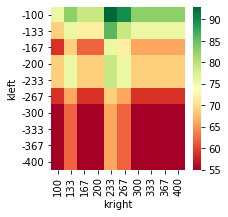

2021-09-07T09:55:00.000000000


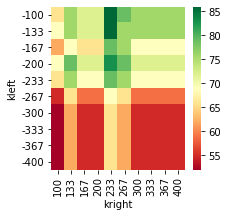

2021-09-07T10:00:00.000000000


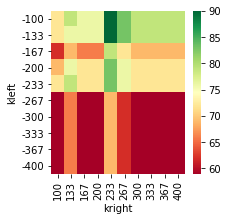

2021-09-07T10:05:00.000000000


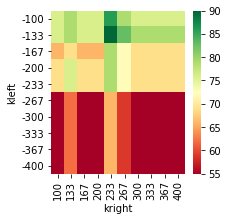

2021-09-07T10:10:00.000000000


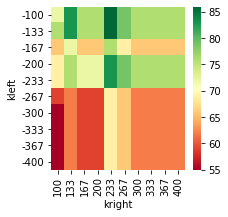

2021-09-07T10:15:00.000000000


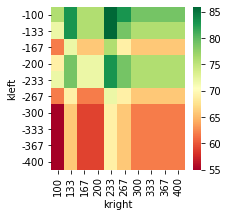

2021-09-07T10:20:00.000000000


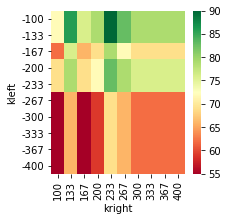

2021-09-07T10:25:00.000000000


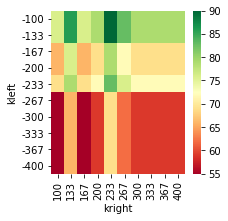

2021-09-07T10:30:00.000000000


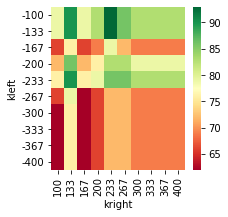

2021-09-07T10:35:00.000000000


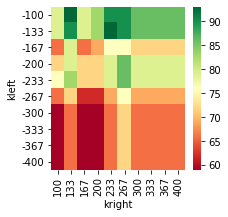

2021-09-07T10:40:00.000000000


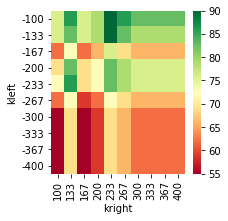

2021-09-07T10:45:00.000000000


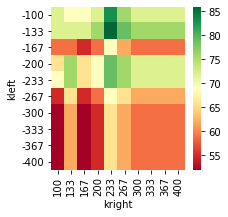

2021-09-07T10:50:00.000000000


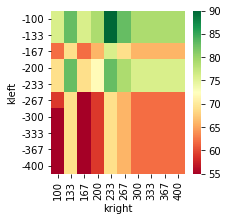

2021-09-07T10:55:00.000000000


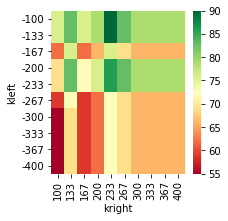

2021-09-07T11:00:00.000000000


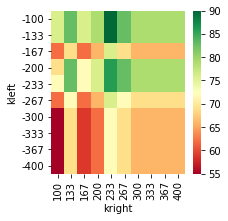

2021-09-07T11:05:00.000000000


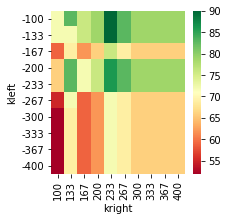

2021-09-07T11:10:00.000000000


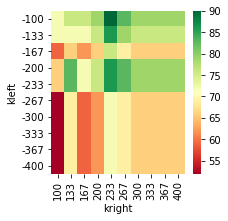

2021-09-07T11:15:00.000000000


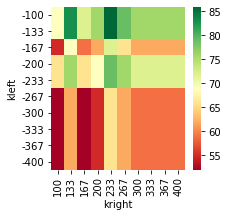

2021-09-07T11:20:00.000000000


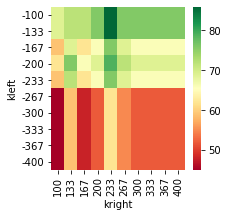

2021-09-07T11:25:00.000000000


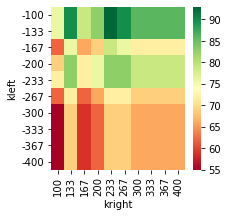

2021-09-07T11:30:00.000000000


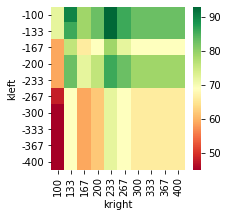

2021-09-07T11:35:00.000000000


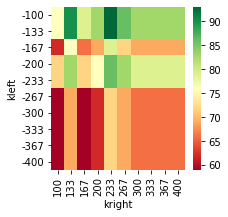

2021-09-07T11:40:00.000000000


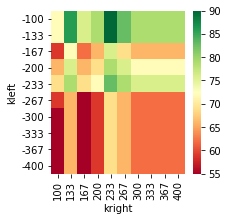

2021-09-07T11:45:00.000000000


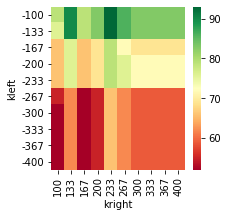

2021-09-07T11:50:00.000000000


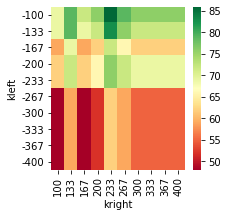

2021-09-07T11:55:00.000000000


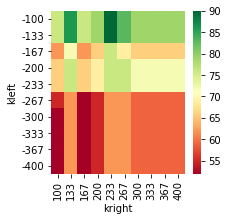

2021-09-07T12:00:00.000000000


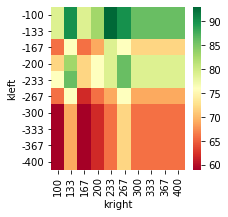

2021-09-07T12:05:00.000000000


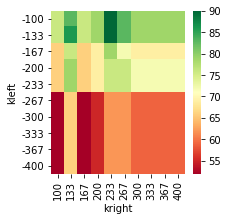

2021-09-07T12:10:00.000000000


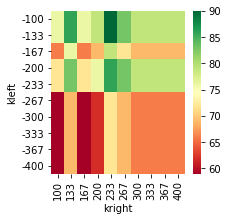

2021-09-07T12:15:00.000000000


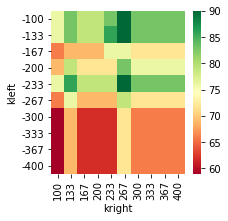

2021-09-07T12:20:00.000000000


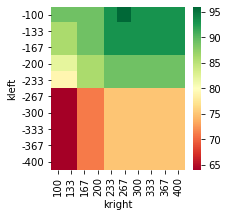

2021-09-07T12:25:00.000000000


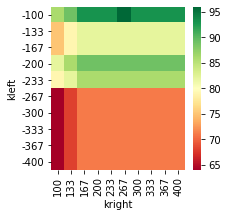

2021-09-07T12:30:00.000000000


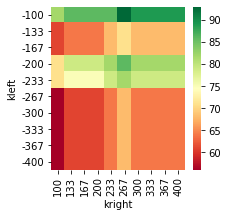

2021-09-07T12:35:00.000000000


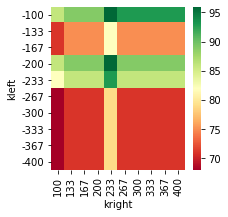

2021-09-07T12:40:00.000000000


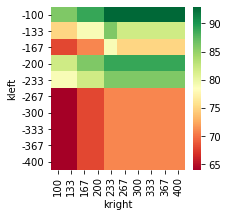

2021-09-07T12:45:00.000000000


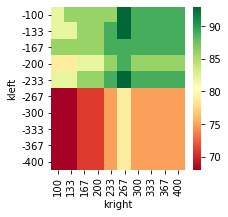

2021-09-07T12:50:00.000000000


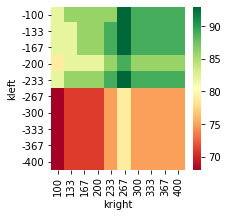

2021-09-07T12:55:00.000000000


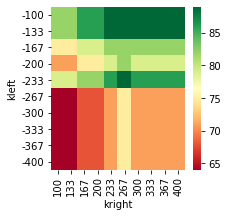

2021-09-07T13:00:00.000000000


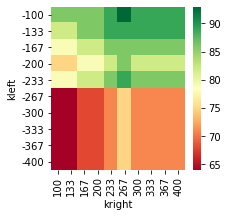

2021-09-07T13:05:00.000000000


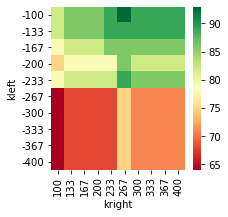

2021-09-07T13:10:00.000000000


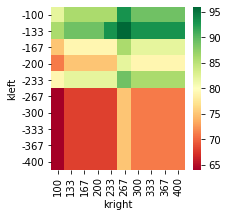

2021-09-07T13:15:00.000000000


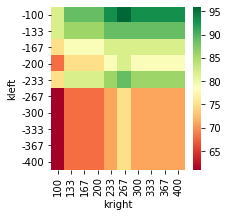

2021-09-07T13:20:00.000000000


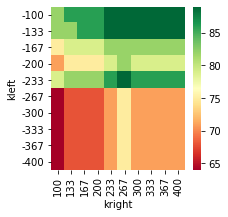

2021-09-07T13:25:00.000000000


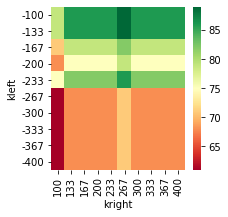

2021-09-07T13:30:00.000000000


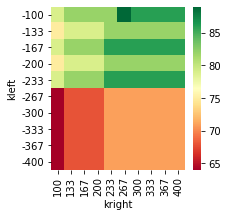

2021-09-07T13:35:00.000000000


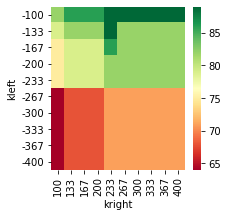

2021-09-07T13:40:00.000000000


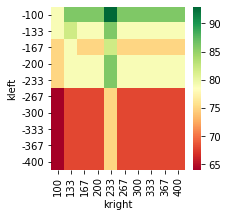

2021-09-07T13:45:00.000000000


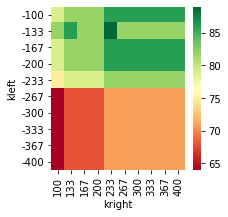

2021-09-07T13:50:00.000000000


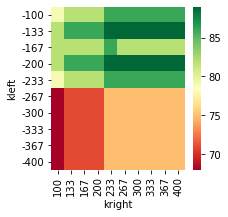

2021-09-07T13:55:00.000000000


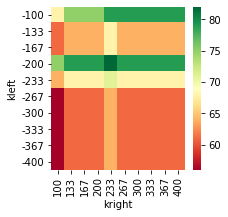

2021-09-07T14:00:00.000000000


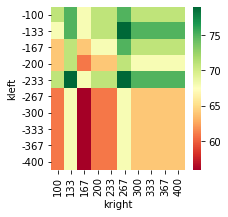

2021-09-07T14:05:00.000000000


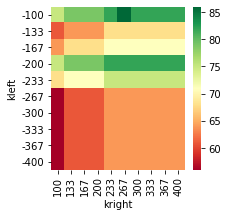

2021-09-07T14:10:00.000000000


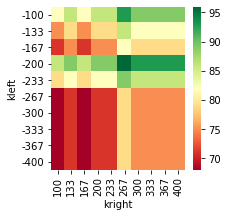

2021-09-07T14:15:00.000000000


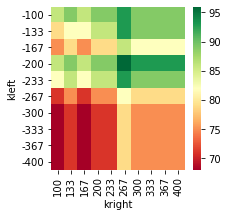

2021-09-07T14:20:00.000000000


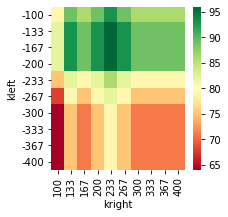

2021-09-07T14:25:00.000000000


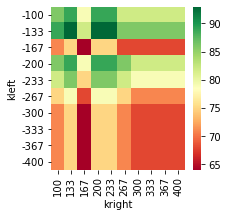

2021-09-07T14:30:00.000000000


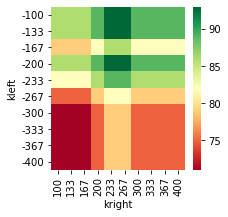

2021-09-07T14:35:00.000000000


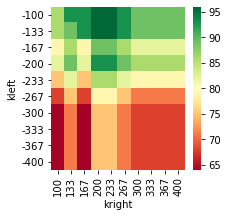

2021-09-07T14:40:00.000000000


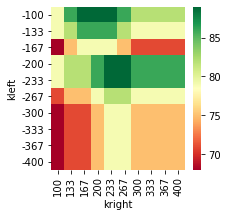

2021-09-07T14:45:00.000000000


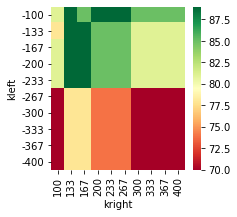

2021-09-07T14:50:00.000000000


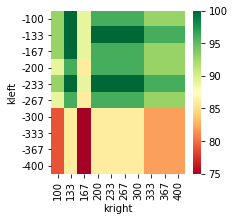

2021-09-07T14:55:00.000000000


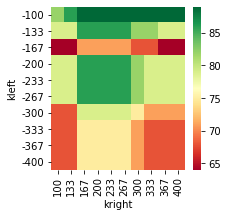

2021-09-07T15:00:00.000000000


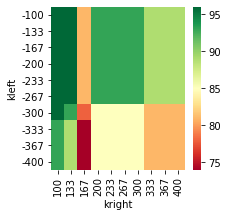

2021-09-07T15:05:00.000000000


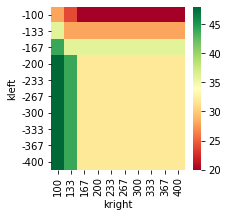

2021-09-07T15:10:00.000000000


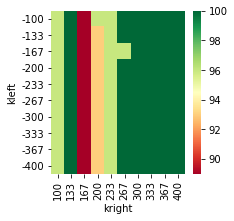

2021-09-07T15:15:00.000000000


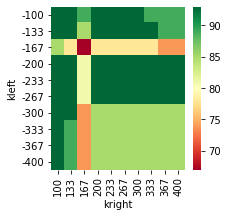

2021-09-07T15:20:00.000000000


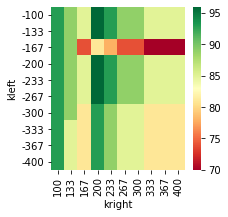

2021-09-07T15:25:00.000000000


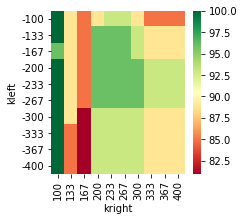

2021-09-07T15:30:00.000000000


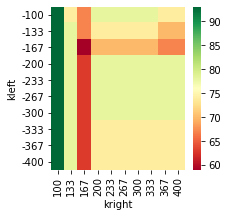

2021-09-07T15:35:00.000000000


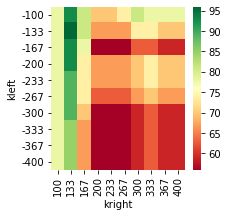

2021-09-07T15:40:00.000000000


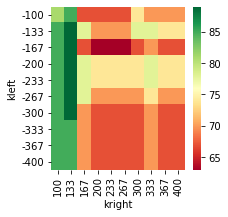

2021-09-07T15:45:00.000000000


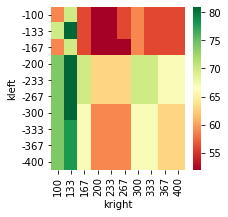

2021-09-07T15:50:00.000000000


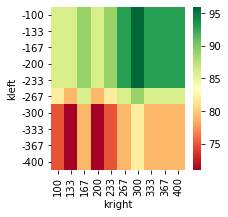

2021-09-07T15:55:00.000000000


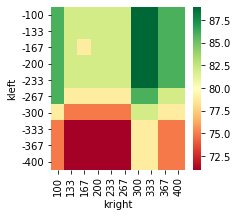

2021-09-07T16:00:00.000000000


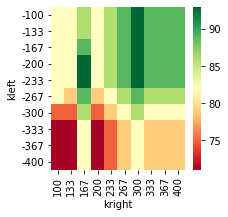

2021-09-07T16:05:00.000000000


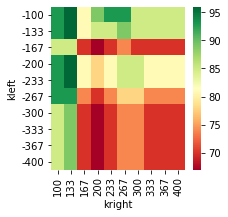

2021-09-07T16:10:00.000000000


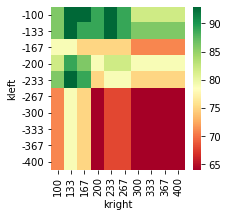

2021-09-07T16:15:00.000000000


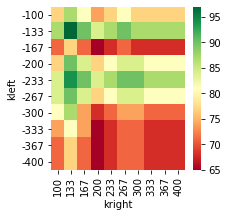

2021-09-07T16:20:00.000000000


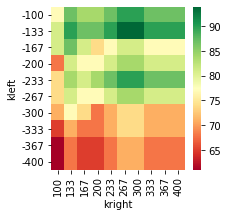

2021-09-07T16:25:00.000000000


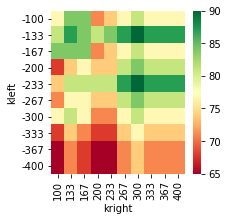

2021-09-07T16:30:00.000000000


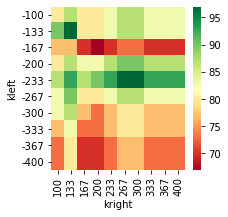

2021-09-07T16:35:00.000000000


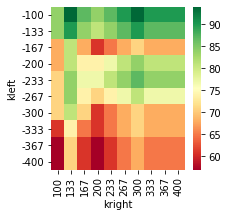

2021-09-07T16:40:00.000000000


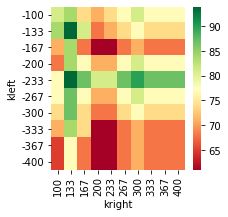

2021-09-07T16:45:00.000000000


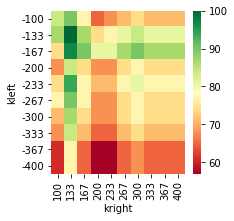

2021-09-07T16:50:00.000000000


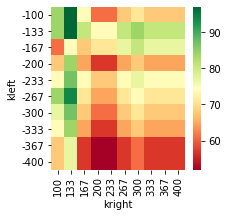

2021-09-07T16:55:00.000000000


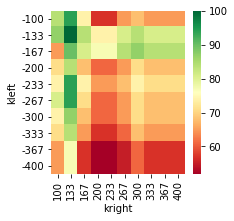

2021-09-07T17:00:00.000000000


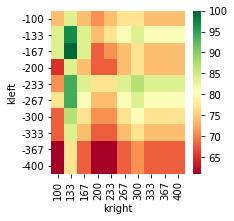

2021-09-07T17:05:00.000000000


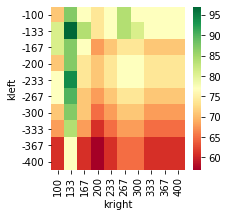

2021-09-07T17:10:00.000000000


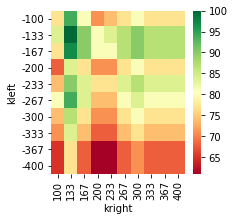

2021-09-07T17:15:00.000000000


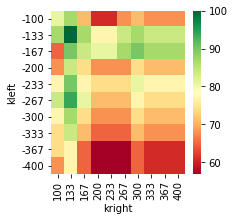

2021-09-07T17:20:00.000000000


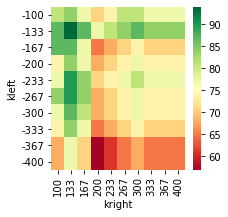

2021-09-07T17:25:00.000000000


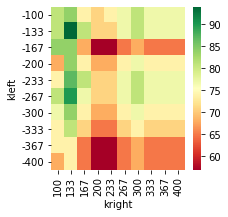

2021-09-07T17:30:00.000000000


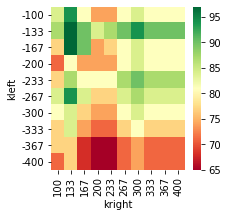

2021-09-07T17:35:00.000000000


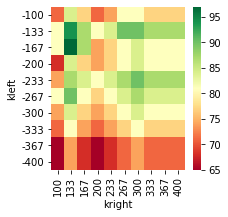

2021-09-07T17:40:00.000000000


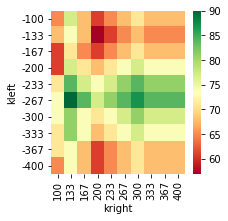

2021-09-07T17:45:00.000000000


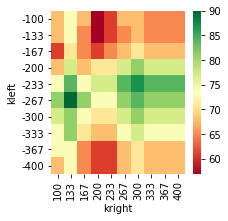

2021-09-07T17:50:00.000000000


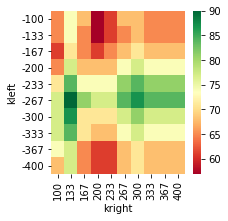

2021-09-07T17:55:00.000000000


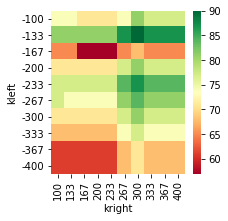

2021-09-07T18:00:00.000000000


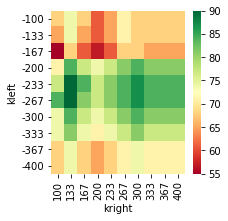

2021-09-07T18:05:00.000000000


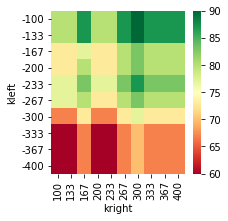

2021-09-07T18:10:00.000000000


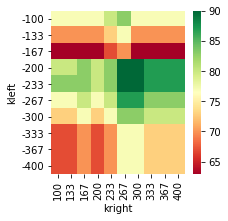

2021-09-07T18:15:00.000000000


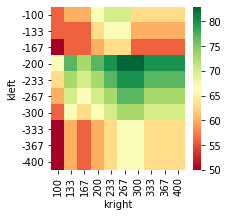

2021-09-07T18:20:00.000000000


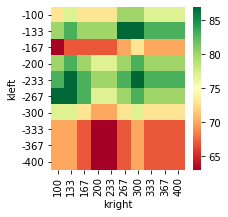

2021-09-07T18:25:00.000000000


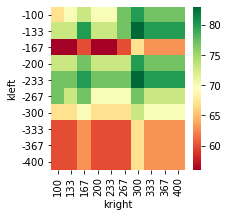

2021-09-07T18:30:00.000000000


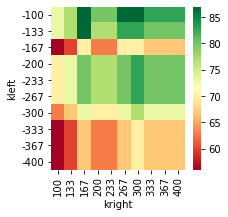

2021-09-07T18:35:00.000000000


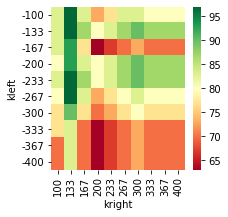

2021-09-07T18:40:00.000000000


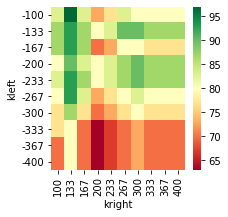

2021-09-07T18:45:00.000000000


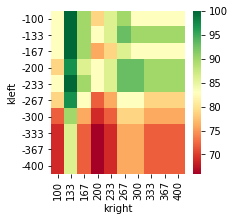

2021-09-07T18:50:00.000000000


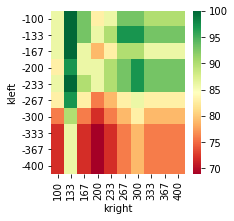

2021-09-07T18:55:00.000000000


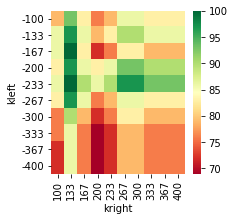

2021-09-07T19:00:00.000000000


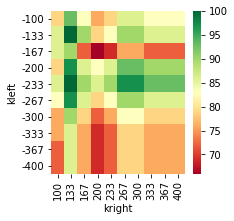

2021-09-07T19:05:00.000000000


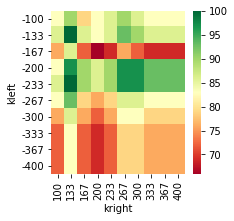

2021-09-07T19:10:00.000000000


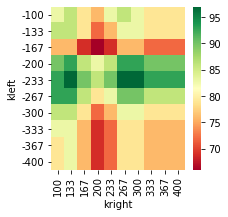

2021-09-07T19:15:00.000000000


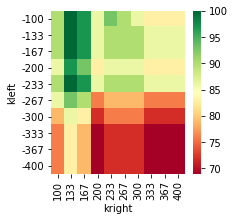

2021-09-07T19:20:00.000000000


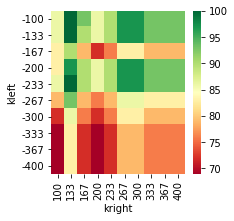

2021-09-07T19:25:00.000000000


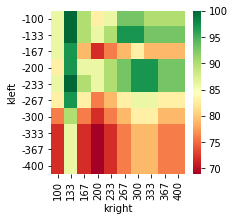

2021-09-07T19:30:00.000000000


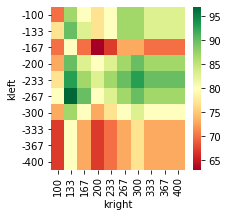

2021-09-07T19:35:00.000000000


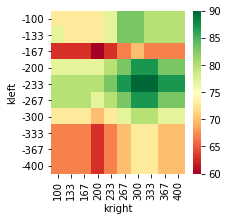

2021-09-07T19:40:00.000000000


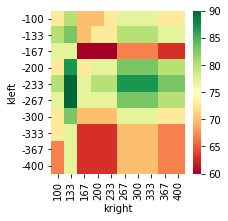

2021-09-07T19:45:00.000000000


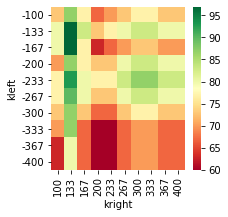

2021-09-07T19:50:00.000000000


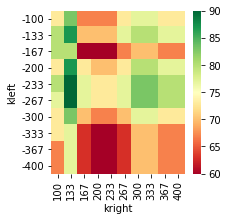

2021-09-07T19:55:00.000000000


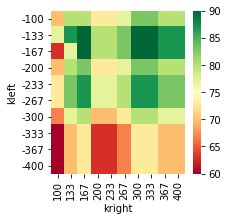

2021-09-07T20:00:00.000000000


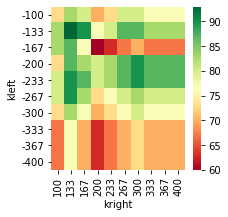

2021-09-07T20:05:00.000000000


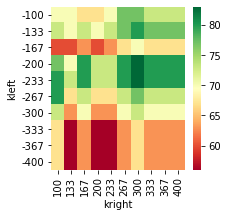

2021-09-07T20:10:00.000000000


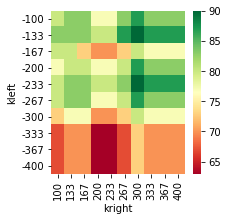

2021-09-07T20:15:00.000000000


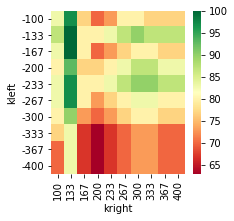

2021-09-07T20:20:00.000000000


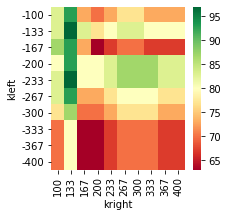

2021-09-07T20:25:00.000000000


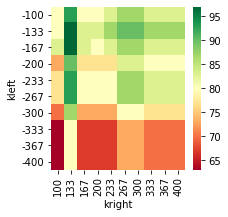

2021-09-07T20:30:00.000000000


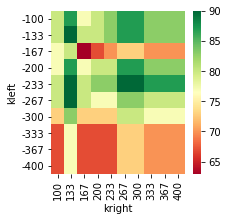

2021-09-07T20:35:00.000000000


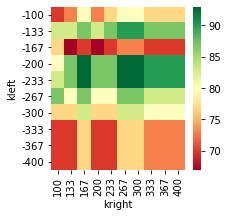

2021-09-07T20:40:00.000000000


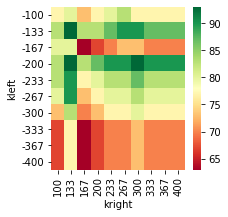

2021-09-07T20:45:00.000000000


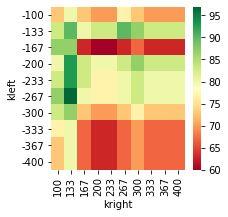

2021-09-07T20:50:00.000000000


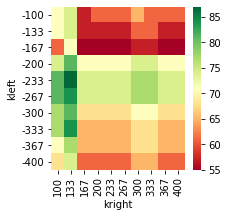

2021-09-07T20:55:00.000000000


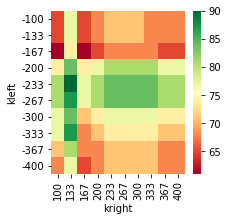

2021-09-07T21:00:00.000000000


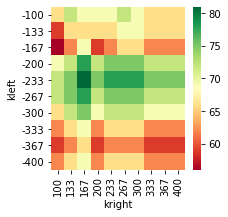

2021-09-07T21:05:00.000000000


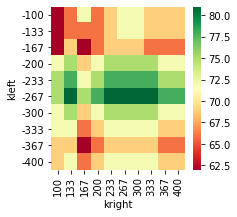

2021-09-07T21:10:00.000000000


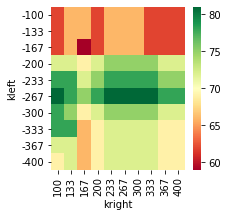

2021-09-07T21:15:00.000000000


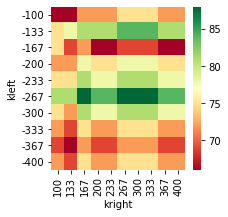

2021-09-07T21:20:00.000000000


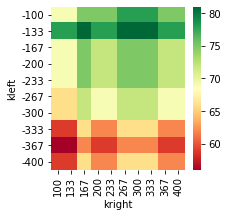

2021-09-07T21:25:00.000000000


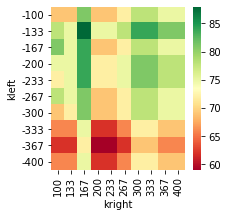

2021-09-07T21:30:00.000000000


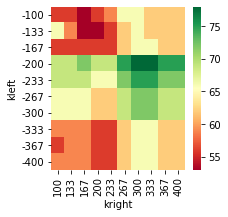

2021-09-07T21:35:00.000000000


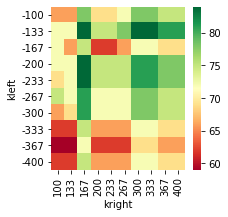

2021-09-07T21:40:00.000000000


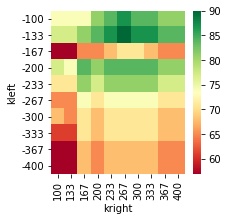

2021-09-07T21:45:00.000000000


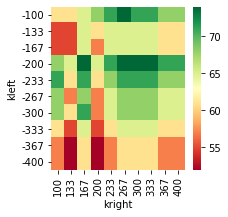

2021-09-07T21:50:00.000000000


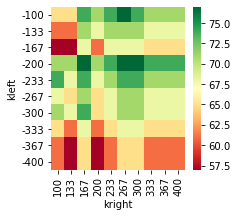

2021-09-07T21:55:00.000000000


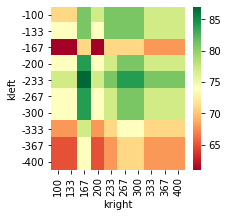

2021-09-07T22:00:00.000000000


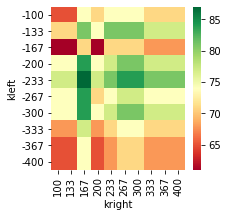

2021-09-07T22:05:00.000000000


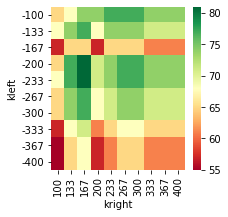

2021-09-07T22:10:00.000000000


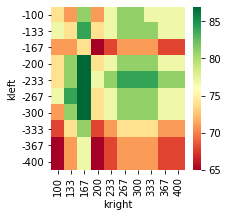

2021-09-07T22:15:00.000000000


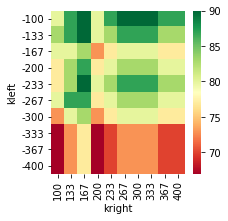

2021-09-07T22:20:00.000000000


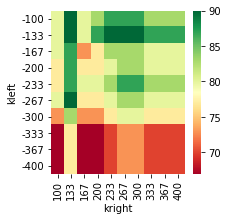

2021-09-07T22:25:00.000000000


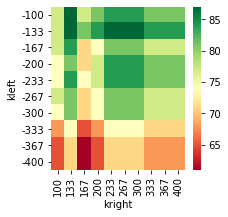

2021-09-07T22:30:00.000000000


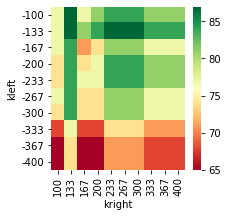

2021-09-07T22:35:00.000000000


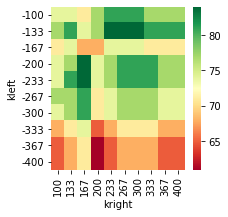

2021-09-07T22:40:00.000000000


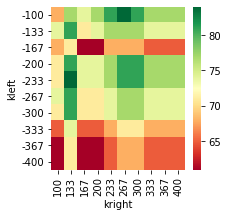

2021-09-07T22:45:00.000000000


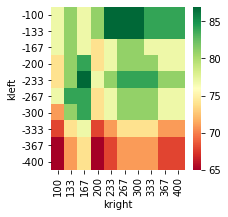

2021-09-07T22:50:00.000000000


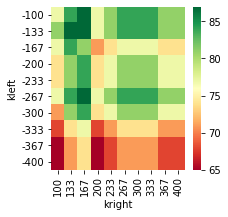

2021-09-07T22:55:00.000000000


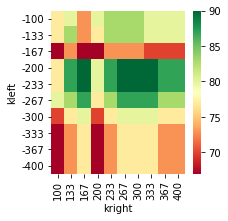

2021-09-07T23:00:00.000000000


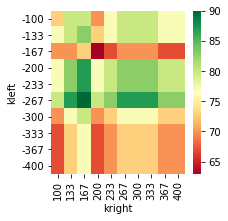

2021-09-07T23:05:00.000000000


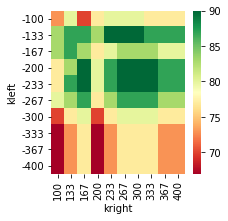

2021-09-07T23:10:00.000000000


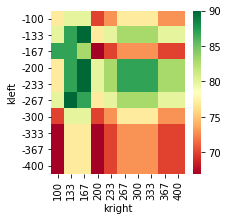

2021-09-07T23:15:00.000000000


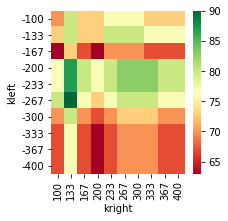

2021-09-07T23:20:00.000000000


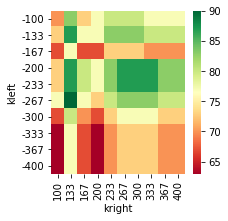

2021-09-07T23:25:00.000000000


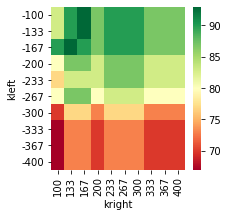

2021-09-07T23:30:00.000000000


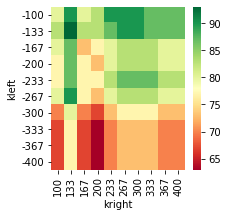

2021-09-07T23:35:00.000000000


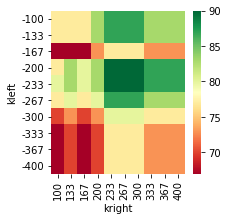

2021-09-07T23:40:00.000000000


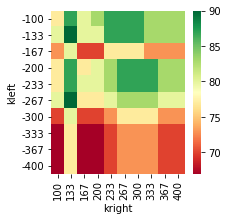

2021-09-07T23:45:00.000000000


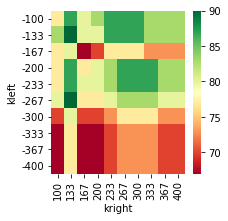

2021-09-07T23:50:00.000000000


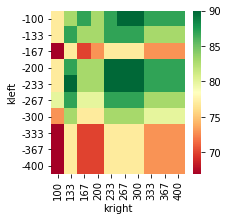

2021-09-07T23:55:00.000000000


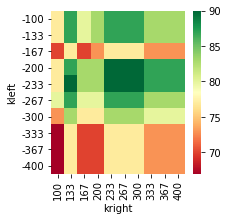

In [199]:
for t in df1['t'].unique():
    print(t)
    pd.concat(dfs).myround2().query(f"t=='{t}'").pivot('kleft','kright','perc').sort_index(ascending=False).heatmap(figsize=(3,3),annot=False)

In [154]:
dfs=[]
for model in ['errfunc_parabolic_linear4','errfunc_parabolic_linear6','errfunc_parabolic4']:
    print(model)
    dfs.append(DF(volfit(df,plot=0,model=model)))  #.query("tm >'2021-07-01 00:00' and tm <'2021-07-01 23:50'"
dfs[0]

errfunc_parabolic_linear4
T=2021-09-24 08:00:00 t=2021-09-07 00:00:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03656722  0.07888977  0.22968857 -0.28123567]
T=2021-09-24 08:00:00 t=2021-09-07 00:05:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03731035  0.08053012  0.22494606 -0.27855029]
T=2021-09-24 08:00:00 t=2021-09-07 00:10:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03580141  0.08119722  0.21948337 -0.27440326]
T=2021-09-24 08:00:00 t=2021-09-07 00:15:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03587991  0.08319516  0.21715929 -0.25446943]
T=2021-09-24 08:00:00 t=2021-09-07 00:20:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_parabolic_linear4
optimized params:[-0.03837337  0.0807739   0.24524622 -0.25246492]
T=2021-09-24 08:00:00 t=2021-09-07 00:25:00
prevparams=[0.2, 0.2, 0.2, -0.2] model=errfunc_par

KeyboardInterrupt: 

In [ ]:
for df1 in dfs:
    df1['perc'].describe()

In [6]:
import  py_vollib.black_scholes

# import delta as bsdelta
# from py_vollib.black_scholes.greeks.analytical import gamma as bsgamma
# from py_vollib.black_scholes.greeks.analytical import vega as bsvega
# from py_vollib.black_scholes.greeks.analytical import theta as bstheta
# from py_vollib.black_scholes.greeks.analytical import rho as bsrho
# from py_vollib.black_scholes import black_scholes as bs


#py_vollib.black_scholes.greeks.analytical.               vega(flag, S, K, t, r, sigma)
#py_vollib.black_scholes.implied_volatility.implied_volatility(price, S, K, t, r, flag)
#py_vollib.black_scholes.                        black_scholes(flag, S, K, t, r, sigma)
#py_vollib.black.implied_volatility_of_discounted_option_price(discounted_option_price, F, K, r, t, flag)

from py_lets_be_rational.exceptions import BelowIntrinsicException, AboveMaximumException

def bsdelta(cp,s,k,t,r,sigma):
    return py_vollib.black_scholes.greeks.analytical.delta('c' if cp==1 else 'p',s,k,t,r,sigma)

def bsgamma(cp,s,k,t,r,sigma):
    return py_vollib.black_scholes.greeks.analytical.gamma('c' if cp==1 else 'p',s,k,t,r,sigma)

def bsvega(cp,s,k,t,r,sigma):
    return py_vollib.black_scholes.greeks.analytical.vega('c' if cp==1 else 'p',s,k,t,r,sigma)

def bstheta(cp,s,k,t,r,sigma):
    return py_vollib.black_scholes.greeks.analytical.theta('c' if cp==1 else 'p',s,k,t,r,sigma)

def bsrho(cp,s,k,t,r,sigma):
    return py_vollib.black_scholes.greeks.analytical.rho('c' if cp==1 else 'p',s,k,t,r,sigma)

def bs(cp,s,k,t,r,sigma):
    return py_vollib.black_scholes.black_scholes('c' if cp==1 else 'p',s,k,t,r,sigma)

def bsiv(cp,s,k,t,r,p):
    try:
        res=py_vollib.black_scholes.implied_volatility.implied_volatility(p, s, k, t, r, 'c' if cp==1 else 'p')
    except BelowIntrinsicException: 
        res='BelowIntrinsicException'
    return res
    
bsdeltav=np.vectorize(bsdelta)
bsgammav=np.vectorize(bsgamma)
bsvegav=np.vectorize(bsvega)
bsrhov=np.vectorize(bsrho)
bsv=np.vectorize(bs)
#from py_vollib.black.implied_volatility import implied_volatility_of_discounted_option_price as bsiv2
#from py_vollib.black_scholes.implied_volatility import implied_volatility as bsiv
bsivv=np.vectorize(bsiv)
#bsiv2=np.vectorize(bsiv2)



bs(1,7157.52,6500,2.1/356,0,0.7793)
#bsiv2(bs('c',7157.52,6500,2.1/356,0,0.7793),7157.52,6500,0,2.1/356,'c')
bsiv(1,7157.52,6500,2.1/356,0,bs(1,7157.52,6500,2.1/356,0,0.7793))

666.7850172632377

0.7792999999999994

### option with most data

In [7]:
df.reset_index().groupby(['expire','strike','ty']).agg(len)['tm'].sort_index().idxmax()

ValueError: cannot insert tm, already exists

In [ ]:
df=df.reset_index()
df

In [8]:
df.query('strike==24000 and expire=="2020-12-25 08:00:00" and ty=="call"').droplevel('strike').drop(columns=['ty'])

KeyError: 'Requested level (strike) does not match index name (tm)'

In [ ]:
# df1=df.query('strike==24000 and expire=="2020-12-25 08:00:00" and ty=="call"').droplevel('strike').drop(columns=['ty'])

In [ ]:
# df=df1.rename(columns={'underlypx':'s'})
# #port1 = option1 - delta0*s1+cash
# df=df.reset_index()
# df['tau']=(df['expire']-df['tm'])/pd.Timedelta('1d')

In [25]:
#df=pd.read_csv('/tmp/optchain/2020.11.26.optchain.1hr.csv')


KeyError: 'expire'

In [ ]:
df=df[df.ty=='call']

In [ ]:
df['mydelta']=bsdeltav(1,df['s'],24000,df['tau']/365,0,df['markiv']/100)
df['mydelta-delta']=df['mydelta']-df['delta']
df['mymark']=bsv(1,df['s'],24000,df['tau']/365,0,df['markiv']/100)/df['s']
df['mymark-mark']=df['mymark']-df['mark']
df['mymarkiv']=bsivv(1,df['s'],24000,df['tau']/365,0,df['mark']*df['s'])*100
df['mymarkiv-iv']=df['mymarkiv']-df['markiv']



In [ ]:
df[df['mydelta-delta']>0.9]

In [ ]:
df[['mydelta-delta','tm']].set_index('tm').plot()

In [ ]:
df['deltadiff']=df['delta'].diff(1)
df['cash']=np.nan
df.iloc[0]['cash']=df.iloc[0]['

In [ ]:
dfoptchain=qoptchain(folder='deribitopt',date1=date(2021,3,7),date2=date(2021,3,10),freq='1H')
dfoptchain

In [ ]:
df1.expire.dt.date

In [ ]:
df1[df1.expire.dt.date==date(2021,1,8)]

In [ ]:
df=dfoptchain.copy()

In [ ]:
df[df.index.get_level_values('expire').date==date(2021,3,7)]

In [ ]:
df.query("expire.date()=='2021-03-07'")

In [ ]:
df1=pd.read_pickle('/tmp/btcoptions.pkl')
df1

In [ ]:
df1[df1.index.get_level_values('expire').date==date(2020,1,3)]

In [ ]:
df1[(df1.index.get_level_values('tm').date>date(2020,1,1))&(df1.index.get_level_values('tm').date<date(2020,1,5))]

In [ ]:
df[df.index.get_level_values('tm').isin(pd.date_range(date(2020,1,1),date(2021,1,2)))]

In [ ]:
df=df.set_index(['tm','expire','strike']).sort_index()
ts=df.index.get_level_values('tm').drop_duplicates()

In [ ]:
df=df[df.symbol.str.contains('ETH')]
dfC:\github\cryptoderiv-quant\ct\utils.py

In [11]:


df=df[df.symbol.str.contains(form.underlying.data)]

NameError: name 'form' is not defined

In [12]:


# #input is : previousparams
# #timestamp  expiry1 strike1 askprice bidprice
# #timestamp  expiry2 strike1 askprice bidprice

# #paramsdict
# #{'leftskew':12, 'right':0.2 }
# #controlsettings {#weights #weightsalg json }


# def errfunc(x,usevega=False,df=None):
#     skewleft=x[0]
#     skewright=x[1]
#     leftconv=x[2]
#     rightconv=x[3]
#     df['m']=0.5*(df['aiv']+df['biv'])
#     S=df['underlypx'].iloc[0]
#     volATM=interp1d(df.index, df['m'])([S])
#     df.loc[df.logKFtau>0,'myvol']=volATM+(skewright*df['logKFtau']+rightconv*df['logKFtau']**2)
#     df.loc[df.logKFtau<0,'myvol']=volATM+(skewleft*df['logKFtau']+leftconv*df['logKFtau']**2)
#     df['insidebidask']=False
#     df.loc[(df.myvol>df.biv)&(df.myvol<df.aiv),'insidebidask']=True
#     if PLOT:
#         print(f"usevega={usevega}  vols inside bidask ={df['insidebidask'].sum()/len(df):.1%}")
#         df[['aiv','biv','myvol','markiv']].plot(title=f'implied vols spot={S}')
#         plt.show()
#     res=(df['myvol']-df['m'])**2 
#     if usevega:
#         res*=df['vega']
#     return res.sum() 

# for t in ts[:5]:
#     dft=df.loc[[t]].droplevel('tm')
#     Ts=dft.index.get_level_values('expire').drop_duplicates()
#     for T in Ts[:4]:
#         dftT=dft.loc[[T]].droplevel('expire')
#         tau=(T-t)/pd.to_timedelta(1, unit='D')/365
#         dftT['logKFtau']=np.log(dftT.index/dftT['underlypx'])/np.sqrt(tau)
#         S=dftT['underlypx'].iloc[0]
#         dftTOTM=dftT[((dftT.ty=='call')&(S<dftT.index))|((dftT.ty=='put')&(S>dftT.index))]
#         dftTOTM[['aiv','biv']].plot(title=f' t={t} T={T} S={S}',style='o')
#         for usevega in [True,False]:
#             PLOT=False
#             res = minimize(partial(errfunc,usevega=usevega,df=dftTOTM), [0.2,0.2,0.01,0.01], method='L-BFGS-B', options={'eps': 1e-08, 'maxfun': 100, 'maxiter': 100})
#             #put previous params as initial guess
#             print(f"optimized params:{res.x}")
#             PLOT=True
#             partial(errfunc,usevega=usevega,df=dftTOTM)(res.x)
                  

KeyError: "[Timestamp('2021-08-02 00:00:00')] not in index"

In [ ]:

def plotdftT(t0,T0):
    t=ts[t0]
    dft=df.loc[[t]].droplevel('tm')
    Ts=dft.index.get_level_values('expire').drop_duplicates()
    T=Ts[T0]
    dftT=dft.loc[[T]].droplevel('expire')
    dftT
    #dftT[['aiv','biv']].plot()
    tau=(T-t)/pd.to_timedelta(1, unit='D')/365
    dftT['logKFtau']=np.log(dftT.index/dftT['underlypx'])/np.sqrt(tau)
    ax1=dftT[dftT.ty=='call'].set_index('logKFtau')[['aiv','biv']].plot(title=f' t={t} T={T}',style='x')
    ax2=dftT[dftT.ty=='put'].set_index('logKFtau')[['aiv','biv']].plot(title=f' t={t} T={T}',style='o',ax=ax1)
    S=S=dftT['underlypx'].iloc[0]
    dftTOTM=dftT[((dftT.ty=='call')&(S<dftT.index))|((dftT.ty=='put')&(S>dftT.index))]
    dftTOTM[['aiv','biv']].plot(title=f' t={t} T={T} S={S}',style='o')
    #keep only otm calls/puts
    
plotdftT(0,0)